### Step 1: Obtain Data

In [1]:
import pandas as pd
import os
import shutil

data = pd.read_csv("images_2007724.csv")

/var/folders/tw/djq1qjxx4_v0lvns6wbl3cxm0000gn/T/ipykernel_43619/2618677848.py:5: DtypeWarning: Columns (17,18) have mixed types. Specify dtype option on import or set low_memory=False.
  data = pd.read_csv("images_2007724.csv")


In [2]:
data.columns
data['deployment_id'].unique()

array(['SW01A', 'SW01B', 'SW01C', 'SW01D', 'SW01E', 'SW01F', 'SW02A',
       'SW02B', 'SW02C', 'SW02D', 'SW02E', 'SW02F', 'SW03A', 'SW03C',
       'SW03E', 'SW03F', 'SW04A', 'SW04B', 'SW04E', 'SW04F', 'SW05A',
       'SW05B', 'SW05F', 'SW06A', 'SW06B', 'SW06C', 'SW06D', 'SW06E',
       'SW06F', 'SW07A', 'SW07B', 'SW07C', 'SW07D', 'SW07E', 'SW07F',
       'SW07P', 'SW08A', 'SW08B', 'SW08D', 'SW08E', 'SW08F', 'SW09A',
       'SW09B', 'SW09C', 'SW09D', 'SW09E', 'SW09F', 'SW10A', 'SW03D',
       'SW03P', 'SW04D', 'SW10B', 'SW10C', 'SW10D', 'SW10E', 'SW10F',
       'SW10P', 'SW11A', 'SW11B', 'SW11C', 'SW05C', 'SW08C', 'SW11D',
       'SW11E', 'SW11F', 'SW12A', 'SW12B', 'SW12C', 'SW12D', 'SW12E',
       'SW12F', 'SW13A', 'SW13B', 'SW13C', 'SW13D', 'SW13E', 'SW13F',
       'SW14A', 'SW14B', 'SW14C', 'SW14D', 'SW14E', 'SW15A', 'SW15B',
       'SW15C', 'SW15D', 'SW15E', 'SW15F', 'SW16A', 'SW16B', 'SW16D',
       'SW16E', 'SW16P', 'SW17A', 'SW17B', 'SW17C', 'SW17D', 'SW17E',
       'SW18A', 'SW1

In [3]:
# What camera images do we have so far?
avail_deploy = ['SW09D'
                ,'SW16A', 'SW16B', 'SW16C', 'SW16D', 'SW16E', 'SW16F', 'SW16P'
                ,'SW17A', 'SW17B', 'SW17C', 'SW17D', 'SW17E', 'SW17F'
                ,'SW18A', 'SW18B', 'SW18C', 'SW18D', 'SW18E', 'SW18F'
                ,'SWF01F', 'SWF02F', 'SWF03F', 'SWF04F']

current_data = data[data['deployment_id'].isin(avail_deploy)]

In [4]:
# Remove blank, set-up images
current_data_animal = current_data[(~current_data['common_name'].isin(['Blank', 'Setup_Pickup'])) & 
                                    (current_data['common_name'].notna())]
current_data_animal['common_name'].value_counts()

common_name
White-bellied Pangolin                279
Western Tree Hyrax                     97
Red River Hog                          70
Chimpanzee                             42
Putty-nosed Monkey                     36
Galago Species                         32
Giant Ground Pangolin                  29
Dwarf Hornbill                         24
African Harrier-hawk                   23
Congo Pied Hornbill                    20
Lord Derby's Scaly-tailed Squirrel     19
Cephalophus Species                    16
Grey-cheeked Mangabey                  14
African Giant Squirrel                 13
Milne-Edwards's Potto                  11
Primate                                 9
Rodent                                  8
Western Little Hornbill                 8
Graphiurus Species                      8
Red-headed Malimbe                      8
Western Bluebill                        8
Western Nicator                         7
Unknown                                 7
Great Blue Turaco     

In [5]:
# Extract the filenames of the images that have pangolins
pangolin_df = current_data_animal[current_data_animal['common_name'].str.contains('pangolin', case=False, na=False)]
pangolin_files = pangolin_df['filename'].tolist()

# Extract the filenames of the images in current_data_animal that are other animals
animal_df = current_data_animal[~current_data_animal['common_name'].str.contains('pangolin', case=False, na=False)]
animal_files = animal_df['filename'].tolist()


In [9]:
import os
import shutil
import torch
import numpy as np
from PIL import Image, ImageDraw
from transformers import DetrImageProcessor, DetrForObjectDetection
import ssl

ssl._create_default_https_context = ssl._create_unverified_context

# Setup destination folder for Pangolin images
destination_folder = 'Pangolin_Images_3_12_Preprocessed'  # Make sure you have this folder created in the same directory.
os.makedirs(destination_folder, exist_ok=True)

# Load the pre-trained DETR model and processor
model = DetrForObjectDetection.from_pretrained('facebook/detr-resnet-50')
processor = DetrImageProcessor.from_pretrained('facebook/detr-resnet-50')
model.eval()

# Loop through the pangolin DataFrame
for _, row in pangolin_df.iterrows():
    source_folder = row['deployment_id']
    filename = row['filename']
    source_path = os.path.join(source_folder, filename)

    if os.path.isfile(source_path):
        # 1. Copy the image into the destination folder
        dest_path = os.path.join(destination_folder, filename)
        shutil.copy2(source_path, dest_path)

        # 2. Open the copied image for processing
        with Image.open(dest_path) as img:
            # 3. Preprocess the image and run the model
            inputs = processor(images=img, return_tensors="pt")
            with torch.no_grad():
                outputs = model(**inputs)

            # Extract the bounding boxes, labels, and scores from the model outputs
            target_sizes = torch.tensor([img.size[::-1]])  # H, W format for target size
            results = processor.post_process_object_detection(outputs, target_sizes=target_sizes, threshold=0.5)[0]

            # Check if any objects are detected
            if len(results['boxes']) > 0:
                # 4. Use the first bounding box to crop around the pangolin (if detected)
                box = results['boxes'][0].tolist()  # Get the first bounding box (in xyxy format)
                left, top, right, bottom = box

                # Crop the image around the bounding box
                cropped_img = img.crop((left, top, right, bottom))

                # 5. Convert the cropped image to black and white
                bw_img = cropped_img.convert('L')

                # 6. Save the processed image back to the destination folder
                bw_img.save(dest_path)
            else:
                img = img.convert('L')
                img.save(dest_path)


Some weights of the model checkpoint at facebook/detr-resnet-50 were not used when initializing DetrForObjectDetection: ['model.backbone.conv_encoder.model.layer1.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer2.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer3.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer4.0.downsample.1.num_batches_tracked']
- This IS expected if you are initializing DetrForObjectDetection from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing DetrForObjectDetection from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


In [10]:
# Setup destination folder
destination_folder = 'Other_Animal_Images_3_12_Preprocessed'
os.makedirs(destination_folder, exist_ok=True)

# Load the pre-trained DETR model and processor
model = DetrForObjectDetection.from_pretrained('facebook/detr-resnet-50')
processor = DetrImageProcessor.from_pretrained('facebook/detr-resnet-50')
model.eval()

# Loop through the pangolin DataFrame
for _, row in animal_df.iterrows():
    source_folder = row['deployment_id']
    filename = row['filename']
    source_path = os.path.join(source_folder, filename)

    if os.path.isfile(source_path):
        # 1. Copy the image into the destination folder
        dest_path = os.path.join(destination_folder, filename)
        shutil.copy2(source_path, dest_path)

        # 2. Open the copied image for processing
        with Image.open(dest_path) as img:
            # 3. Preprocess the image and run the model
            inputs = processor(images=img, return_tensors="pt")
            with torch.no_grad():
                outputs = model(**inputs)

            # Extract the bounding boxes, labels, and scores from the model outputs
            target_sizes = torch.tensor([img.size[::-1]])  # H, W format for target size
            results = processor.post_process_object_detection(outputs, target_sizes=target_sizes, threshold=0.5)[0]

            # Check if any objects are detected
            if len(results['boxes']) > 0:
                # 4. Use the first bounding box to crop around the pangolin (if detected)
                box = results['boxes'][0].tolist()  # Get the first bounding box (in xyxy format)
                left, top, right, bottom = box

                # Crop the image around the bounding box
                cropped_img = img.crop((left, top, right, bottom))

                # 5. Convert the cropped image to black and white
                bw_img = cropped_img.convert('L')

                # 6. Save the processed image back to the destination folder
                bw_img.save(dest_path)
            else:
                img = img.convert('L')
                img.save(dest_path)


Some weights of the model checkpoint at facebook/detr-resnet-50 were not used when initializing DetrForObjectDetection: ['model.backbone.conv_encoder.model.layer1.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer2.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer3.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer4.0.downsample.1.num_batches_tracked']
- This IS expected if you are initializing DetrForObjectDetection from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing DetrForObjectDetection from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


### Step 2: Create baseline x_train and y_train (without the splits)

In [1]:
# Suppress warnings
import os
import pandas as pd

# Define base folders
pangolin_folder = "Pangolin_Images_3_12_Preprocessed"
other_animals_folder = "Other_Animal_Images_3_12_Preprocessed"

# Get the list of files in each folder
pangolin_files = [f for f in os.listdir(pangolin_folder) if f.endswith('.JPG')]
other_animal_files = [f for f in os.listdir(other_animals_folder) if f.endswith('.JPG')]

# Create file paths for each image
pangolin_filepaths = [os.path.join(pangolin_folder, f) for f in pangolin_files]
other_animal_filepaths = [os.path.join(other_animals_folder, f) for f in other_animal_files]

# Combine file paths and create labels
filepaths = pangolin_filepaths + other_animal_filepaths
labels = [1] * len(pangolin_filepaths) + [0] * len(other_animal_filepaths)

# Create the DataFrame for x_train
x_train = pd.DataFrame(filepaths, columns=['filepath'])

# Create the DataFrame for y_train with binary labels
y_train = pd.DataFrame(labels, columns=['label'])

# Set the index to be the filename without the '.JPG' extension
x_train.index = [os.path.splitext(os.path.basename(f))[0] for f in filepaths]
y_train.index = x_train.index  # Use the same index for y_train

# Set column names
x_train.index.name = 'id'
y_train.index.name = 'id'

# Combine x_train and y_train into a single DataFrame
combined_df = pd.concat([x_train], axis=1)
#y_train = y_train.to_numpy().argmax(axis=1)
# Print the combined DataFrame
#print(combined_df.head())
#print(x_train.head)
y_train = y_train["label"].to_numpy()
print(y_train)
print(len(y_train))

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 

### Step 3: The Dataset

First, we'll create an `ImagesDataset` class that will define how we access our data and any transformations we might want to apply. 

This new class will inherit from the PyTorch [`Dataset`](https://pytorch.org/tutorials/beginner/basics/data_tutorial.html) class, but we'll also need to define our own `__init__`, `__len__` and `__getitem__` **special methods**:
* **`__init__`** will instantiate the dataset object with two dataframes: an `x_train` df containing image IDs and image file paths, and a `y_train` df containing image IDs and labels. This will run once when we first create the dataset object, e.g. with `dataset = ImagesDataset(x_train, y_train)`.
* **`__getitem__`** will define how we access a sample from the data. This method gets called whenever we use an indexing operation like `dataset[index]`. In this case, whenever accessing a particular image sample (for example, to get the first image we'd do `dataset[0]`) the following will happen:
  * look up the image filepath using the index
  * load the image with [`PIL.Image`](https://pillow.readthedocs.io/en/stable/reference/Image.html)
  * apply some transformations (more on this below)
  * return a dictionary containing the image ID, the image itself as a Tensor, and a label (if it exists)
* **`__len__`** simply returns the size of the dataset, which we do by calling `len` on the input dataframe.

In [2]:
import torch
from torch.utils.data import Dataset
from torchvision import transforms


class ImagesDataset(Dataset):
    """Reads in an image, transforms pixel values, and serves
    a dictionary containing the image id, image tensors, and label.
    """

    def __init__(self, x_df, y_df=None):
        # This will run once when we first create the dataset object, e.g. with `dataset = ImagesDataset(x_train, y_train)`
        # Will instantiate the dataset object with 2 dataframes
        # x_train_df = contains image IDs and image file paths
        # y_train_df = contains image IDs and labels
        self.data = x_df
        self.label = y_df
        self.transform = transforms.Compose(
            [
                transforms.Resize((224, 224)), # resizes image to 224x224 pixels
                transforms.ToTensor(), # converts image to a PyTorch Tensor, normalizing pixel values b/w 0 and 1
                transforms.Normalize( # standardizes image using mean and standard dev of the ImageNet dataset
                    mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)
                ),
            ]
        )

    def __getitem__(self, index):
        filepath = self.data.iloc[index]["filepath"]
        # Skip non-image files like .DS_Store
        if filepath.endswith(".DS_Store"):
            print(filepath)

        image = Image.open(self.data.iloc[index]["filepath"]).convert("RGB") # Opens image from filepath and converts it to RBG image
        image = self.transform(image) # Applies transformation pipeline (resize, tensor conversion, normalization)
        image_id = self.data.index[index] # Retrieves image ID
        # if we don't have labels (e.g. for test set) just return the image and image id
        if self.label is None:
            sample = {"image_id": image_id, "image": image} # If no label, returns dictionary with just image_id and transformed image (so if no y_df)
        else: # If label: 
            label = torch.tensor(self.label[index], 
                                 dtype=torch.float) # Converts label into a PyTorch Tensor
            sample = {"image_id": image_id, "image": image, "label": label} # Returns a dictionary containing image_id, image, and label
        return sample

    def __len__(self): # Returns # of images in x_df (length of dataset)
        return len(self.data)

## STEP 4: Training

#### STRATIFIED KFOLD
For K_Fold:
- 80% train, 20% test
- Within train, we further split:
- 90% train, 10% val
- Train and validate for 15 epochs/fold
- Save the best model as that which produces the lowest val loss
- Run the best model of each fold on the test data for that fold


/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Fold 1/5


/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.4500387..2.622571].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for

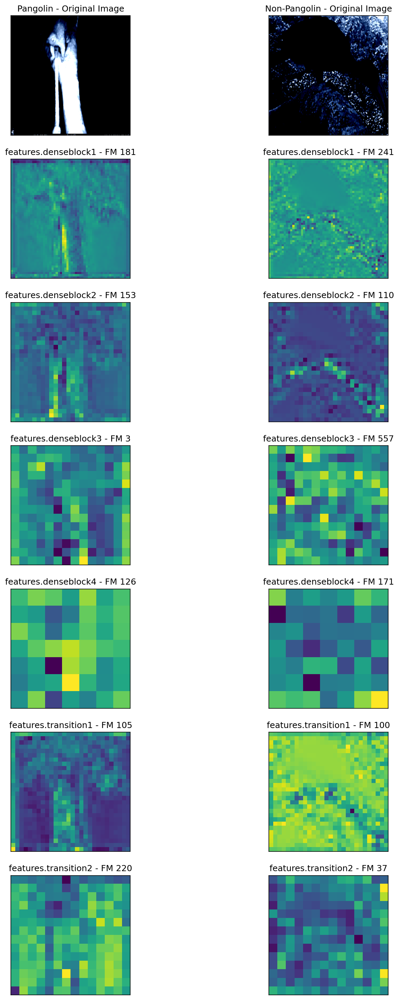

/var/folders/tw/djq1qjxx4_v0lvns6wbl3cxm0000gn/T/ipykernel_21039/347051233.py:158: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at /Users/runner/work/pytorch/pytorch/pytorch/torch/csrc/utils/tensor_new.cpp:257.)
  train_preds_tensor = torch.tensor(train_preds)
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set

Saving for this epoch 0
Epoch [1/15], Train Loss: 0.6495, Validation Loss: 0.6540
Training Per-Species Metrics:
Precision: 0.6866, Recall: 1.0000, F1: 0.8142
Species 1 - Accuracy: 0.6866, Precision: 0.0000, Recall: 0.0000, F1: 0.0000
Training Overall Accuracy: 0.6866, Precision: 0.3433, Recall: 0.5000, F1: 0.4071
Validation Overall Accuracy: 0.6792, Precision: 0.3396, Recall: 0.5000, F1: 0.4045
Epoch time 154.0610761642456





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

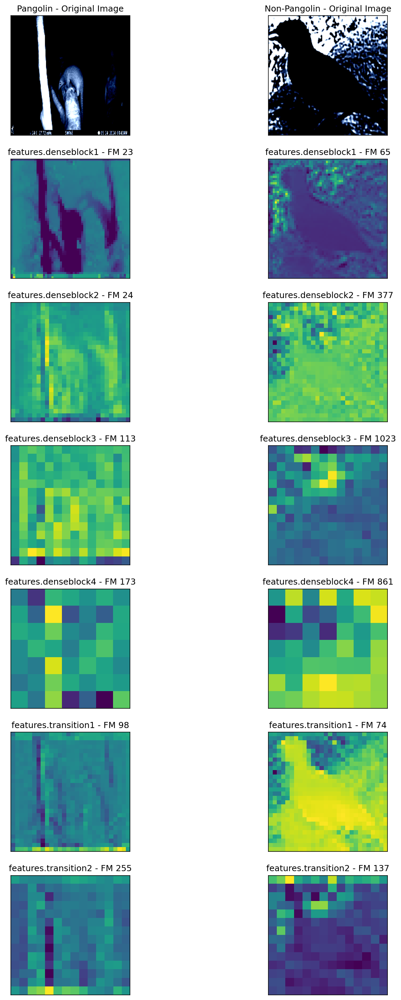

/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_div

0.6539624929428101
Saving for this epoch 1
Epoch [2/15], Train Loss: 0.6043, Validation Loss: 0.6066
Training Per-Species Metrics:
Precision: 0.6866, Recall: 1.0000, F1: 0.8142
Species 1 - Accuracy: 0.6866, Precision: 0.0000, Recall: 0.0000, F1: 0.0000
Training Overall Accuracy: 0.6866, Precision: 0.3433, Recall: 0.5000, F1: 0.4071
Validation Overall Accuracy: 0.6792, Precision: 0.3396, Recall: 0.5000, F1: 0.4045
Epoch time 155.3335301876068





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.5699118..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.5699118..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.5699118..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to t

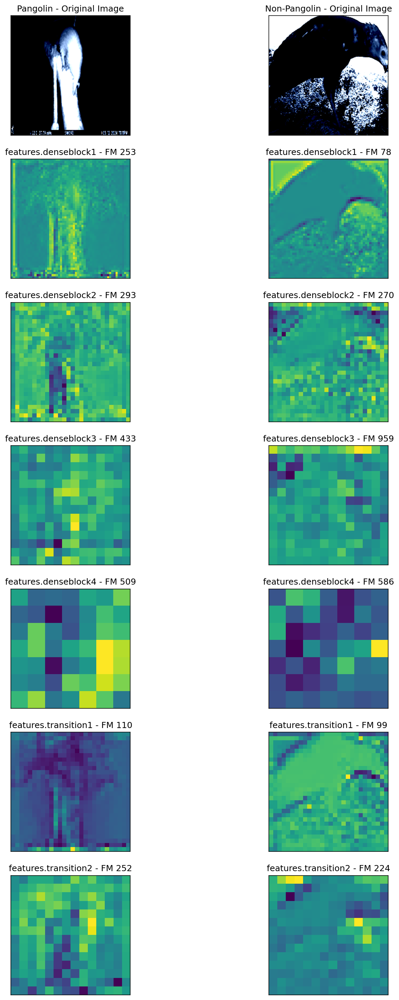

/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_div

0.6066080629825592
Saving for this epoch 2
Epoch [3/15], Train Loss: 0.5736, Validation Loss: 0.5696
Training Per-Species Metrics:
Precision: 0.6866, Recall: 1.0000, F1: 0.8142
Species 1 - Accuracy: 0.6866, Precision: 0.0000, Recall: 0.0000, F1: 0.0000
Training Overall Accuracy: 0.6866, Precision: 0.3433, Recall: 0.5000, F1: 0.4071
Validation Overall Accuracy: 0.6792, Precision: 0.3396, Recall: 0.5000, F1: 0.4045
Epoch time 155.86697101593018





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.843908..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.843908..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.843908..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

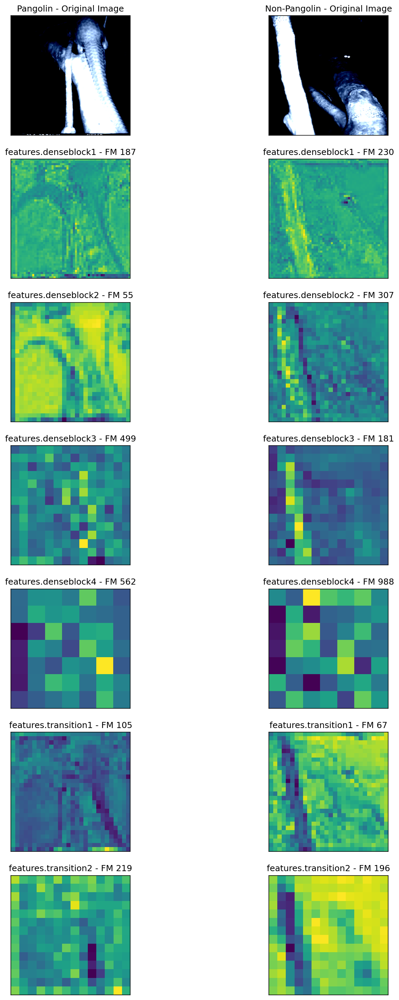

/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_div

0.5696174502372742
Saving for this epoch 3
Epoch [4/15], Train Loss: 0.5492, Validation Loss: 0.5360
Training Per-Species Metrics:
Precision: 0.6866, Recall: 1.0000, F1: 0.8142
Species 1 - Accuracy: 0.6866, Precision: 0.0000, Recall: 0.0000, F1: 0.0000
Training Overall Accuracy: 0.6866, Precision: 0.3433, Recall: 0.5000, F1: 0.4071
Validation Overall Accuracy: 0.6792, Precision: 0.3396, Recall: 0.5000, F1: 0.4045
Epoch time 156.2496907711029





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.5014129..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.5014129..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.5014129..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to t

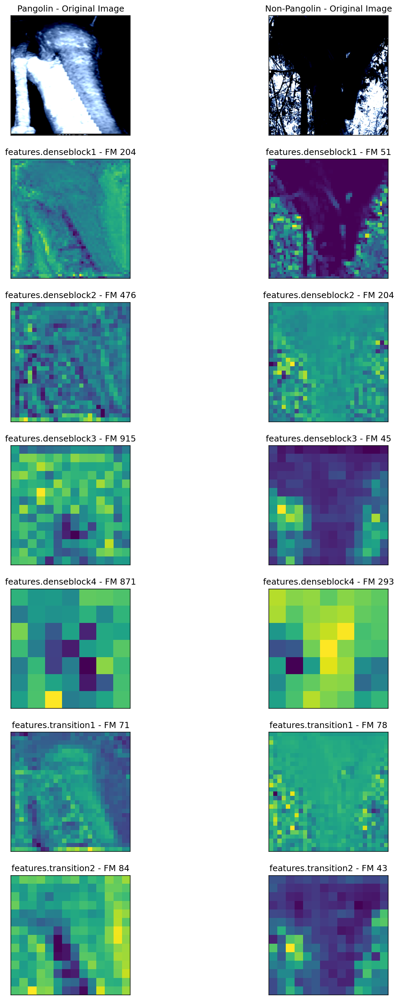

/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_div

0.5359799265861511
Saving for this epoch 4
Epoch [5/15], Train Loss: 0.5201, Validation Loss: 0.5095
Training Per-Species Metrics:
Precision: 0.6866, Recall: 1.0000, F1: 0.8142
Species 1 - Accuracy: 0.6866, Precision: 0.0000, Recall: 0.0000, F1: 0.0000
Training Overall Accuracy: 0.6866, Precision: 0.3433, Recall: 0.5000, F1: 0.4071
Validation Overall Accuracy: 0.6792, Precision: 0.3396, Recall: 0.5000, F1: 0.4045
Epoch time 156.83001708984375





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

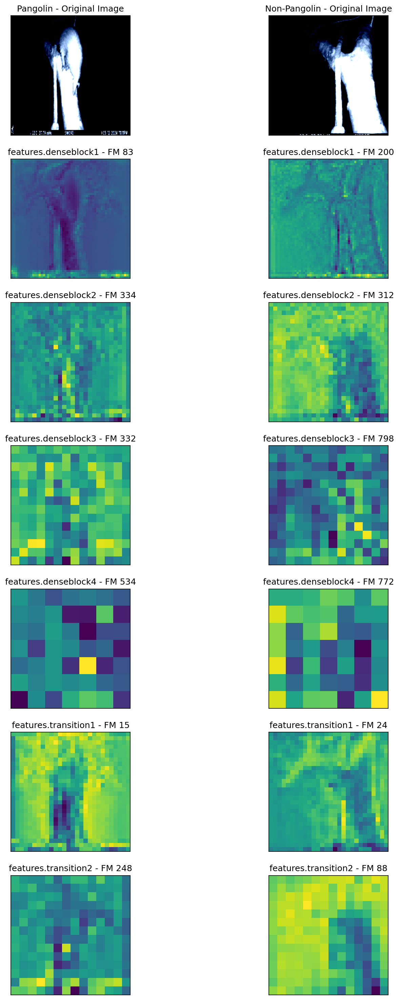

/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_div

0.5095395296812057
Saving for this epoch 5
Epoch [6/15], Train Loss: 0.5003, Validation Loss: 0.4821
Training Per-Species Metrics:
Precision: 0.6866, Recall: 1.0000, F1: 0.8142
Species 1 - Accuracy: 0.6866, Precision: 0.0000, Recall: 0.0000, F1: 0.0000
Training Overall Accuracy: 0.6866, Precision: 0.3433, Recall: 0.5000, F1: 0.4071
Validation Overall Accuracy: 0.6792, Precision: 0.3396, Recall: 0.5000, F1: 0.4045
Epoch time 154.11026096343994





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8096584..2.535425].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8096584..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8096584..2.535425].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8096584..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8096584..2.535425].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8096584..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8096584..2.535425].
Clip

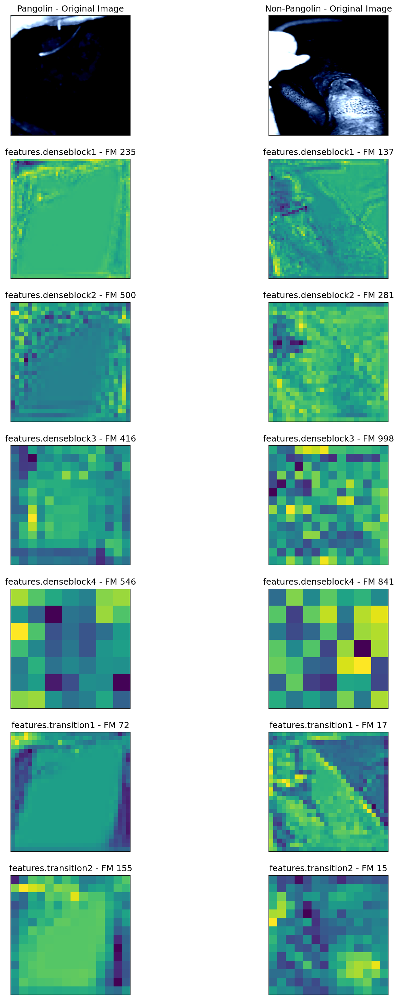

/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


0.48212240636348724
Saving for this epoch 6
Epoch [7/15], Train Loss: 0.4757, Validation Loss: 0.4595
Training Per-Species Metrics:
Precision: 0.6895, Recall: 1.0000, F1: 0.8162
Species 1 - Accuracy: 0.6908, Precision: 1.0000, Recall: 0.0136, F1: 0.0268
Training Overall Accuracy: 0.6908, Precision: 0.8448, Recall: 0.5068, F1: 0.4215
Validation Overall Accuracy: 0.6792, Precision: 0.3396, Recall: 0.5000, F1: 0.4045
Epoch time 149.16468405723572





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

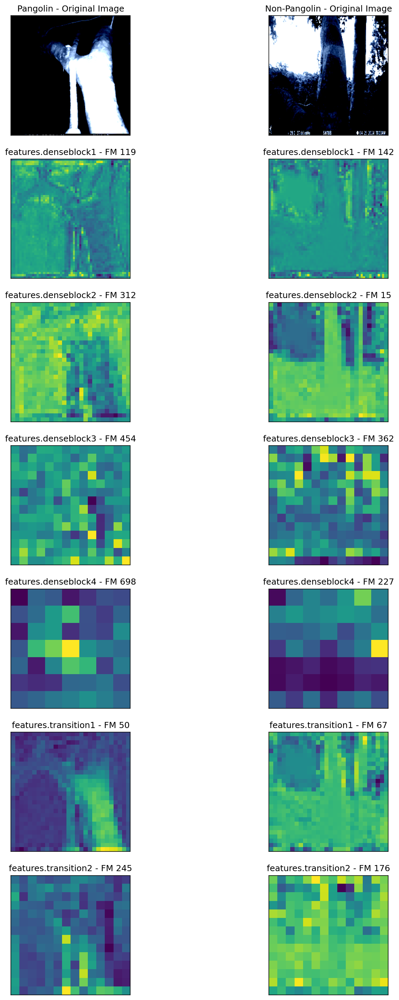

/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


0.4594590663909912
Saving for this epoch 7
Epoch [8/15], Train Loss: 0.4488, Validation Loss: 0.4327
Training Per-Species Metrics:
Precision: 0.7000, Recall: 1.0000, F1: 0.8235
Species 1 - Accuracy: 0.7058, Precision: 1.0000, Recall: 0.0612, F1: 0.1154
Training Overall Accuracy: 0.7058, Precision: 0.8500, Recall: 0.5306, F1: 0.4695
Validation Overall Accuracy: 0.6792, Precision: 0.3396, Recall: 0.5000, F1: 0.4045
Epoch time 151.15070581436157





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.843908..2.5005665].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.843908..2.5005665].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.843908..2.5005665].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping inp

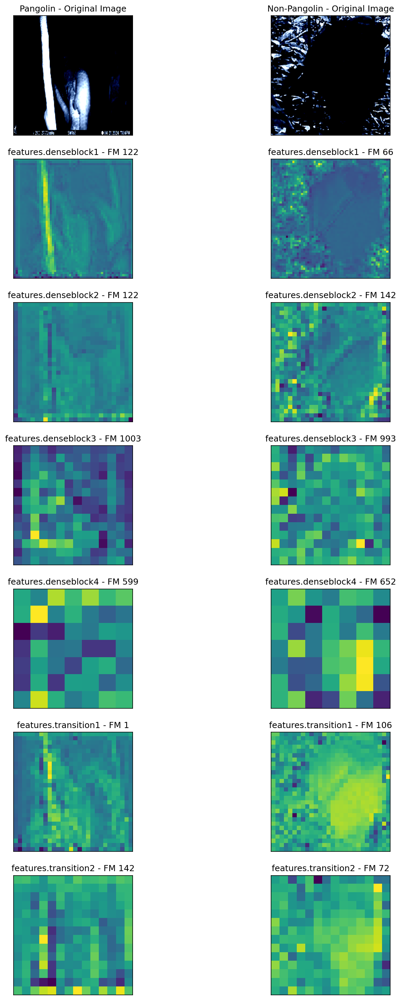

0.432713583111763
Saving for this epoch 8
Epoch [9/15], Train Loss: 0.4294, Validation Loss: 0.4081
Training Per-Species Metrics:
Precision: 0.7577, Recall: 0.9907, F1: 0.8587
Species 1 - Accuracy: 0.7761, Precision: 0.9375, Recall: 0.3061, F1: 0.4615
Training Overall Accuracy: 0.7761, Precision: 0.8476, Recall: 0.6484, F1: 0.6601
Validation Overall Accuracy: 0.7925, Precision: 0.8264, Recall: 0.6920, F1: 0.7121
Epoch time 154.901025056839





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8096584..2.4831376].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8096584..2.4831376].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8096584..2.4831376].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8096584..2.4831376].
Cli

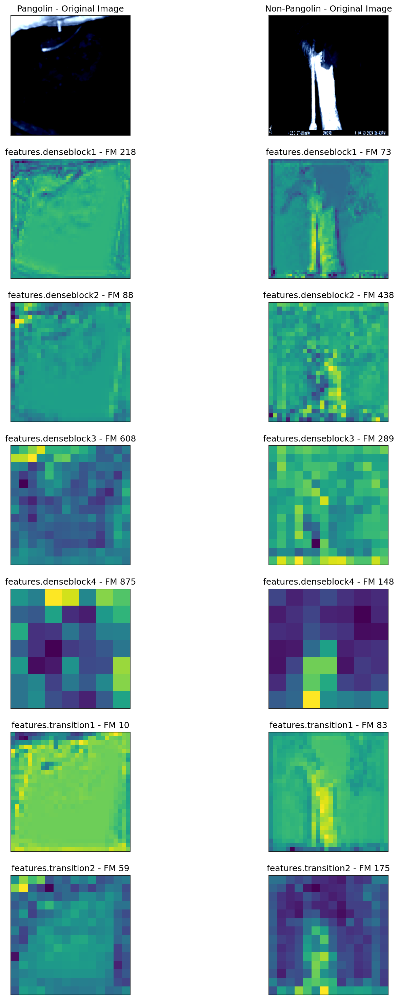

0.4081011861562729
Saving for this epoch 9
Epoch [10/15], Train Loss: 0.4102, Validation Loss: 0.3906
Training Per-Species Metrics:
Precision: 0.8143, Recall: 0.9534, F1: 0.8784
Species 1 - Accuracy: 0.8188, Precision: 0.8370, Recall: 0.5238, F1: 0.6444
Training Overall Accuracy: 0.8188, Precision: 0.8256, Recall: 0.7386, F1: 0.7614
Validation Overall Accuracy: 0.7736, Precision: 0.7753, Recall: 0.6781, F1: 0.6942
Epoch time 150.1038408279419





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

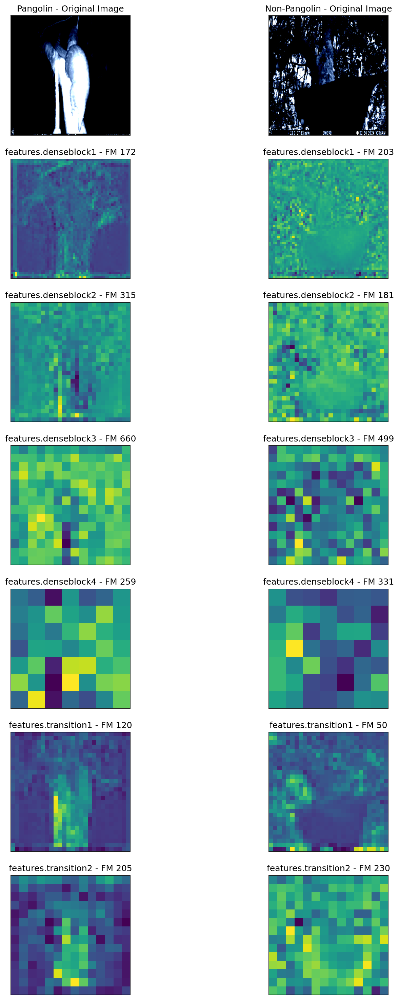

0.39062367379665375
Saving for this epoch 10
Epoch [11/15], Train Loss: 0.3871, Validation Loss: 0.3805
Training Per-Species Metrics:
Precision: 0.8516, Recall: 0.9627, F1: 0.9038
Species 1 - Accuracy: 0.8593, Precision: 0.8857, Recall: 0.6327, F1: 0.7381
Training Overall Accuracy: 0.8593, Precision: 0.8687, Recall: 0.7977, F1: 0.8209
Validation Overall Accuracy: 0.8302, Precision: 0.8313, Recall: 0.7663, F1: 0.7864
Epoch time 152.83809208869934





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7240347..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7240347..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7240347..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to t

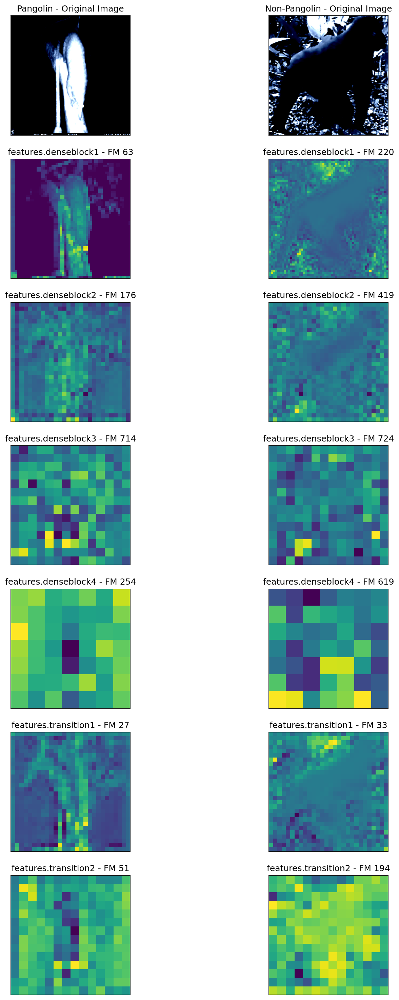

0.38053518533706665
Saving for this epoch 11
Epoch [12/15], Train Loss: 0.3812, Validation Loss: 0.3571
Training Per-Species Metrics:
Precision: 0.8609, Recall: 0.9224, F1: 0.8906
Species 1 - Accuracy: 0.8443, Precision: 0.7984, Recall: 0.6735, F1: 0.7306
Training Overall Accuracy: 0.8443, Precision: 0.8296, Recall: 0.7979, F1: 0.8106
Validation Overall Accuracy: 0.8679, Precision: 0.8645, Recall: 0.8252, F1: 0.8404
Epoch time 152.43149590492249





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4308496].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4308496].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4308496].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4308496].
Clippin

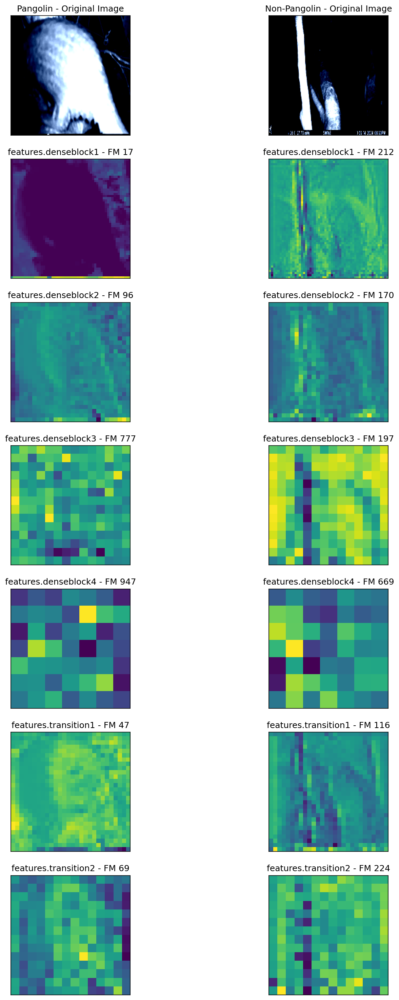

0.3570639193058014
Saving for this epoch 12
Epoch [13/15], Train Loss: 0.3503, Validation Loss: 0.3489
Training Per-Species Metrics:
Precision: 0.8879, Recall: 0.9099, F1: 0.8988
Species 1 - Accuracy: 0.8593, Precision: 0.7914, Recall: 0.7483, F1: 0.7692
Training Overall Accuracy: 0.8593, Precision: 0.8396, Recall: 0.8291, F1: 0.8340
Validation Overall Accuracy: 0.8302, Precision: 0.8313, Recall: 0.7663, F1: 0.7864
Epoch time 151.80008506774902





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.6212862..2.0648367].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.6212862..2.0648367].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.6212862..2.0648367].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping 

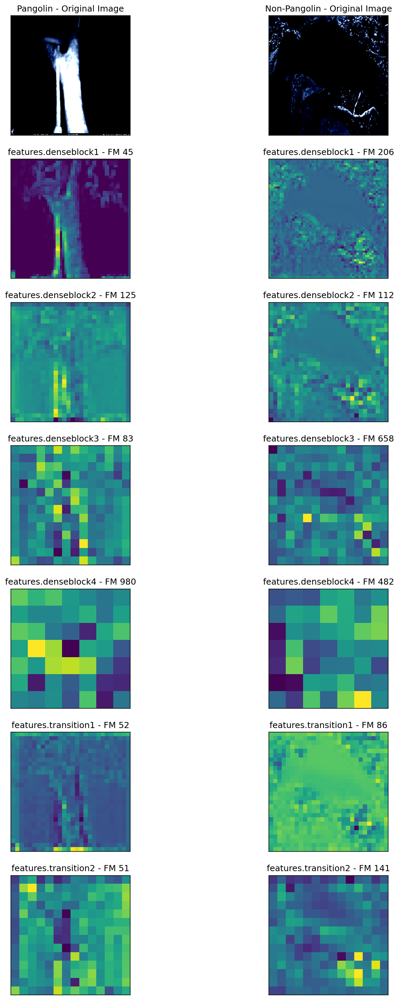

0.34889987111091614
Saving for this epoch 13
Epoch [14/15], Train Loss: 0.3371, Validation Loss: 0.3317
Training Per-Species Metrics:
Precision: 0.8902, Recall: 0.9317, F1: 0.9105
Species 1 - Accuracy: 0.8742, Precision: 0.8333, Recall: 0.7483, F1: 0.7885
Training Overall Accuracy: 0.8742, Precision: 0.8618, Recall: 0.8400, F1: 0.8495
Validation Overall Accuracy: 0.8491, Precision: 0.8481, Recall: 0.7958, F1: 0.8140
Epoch time 149.8290729522705





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

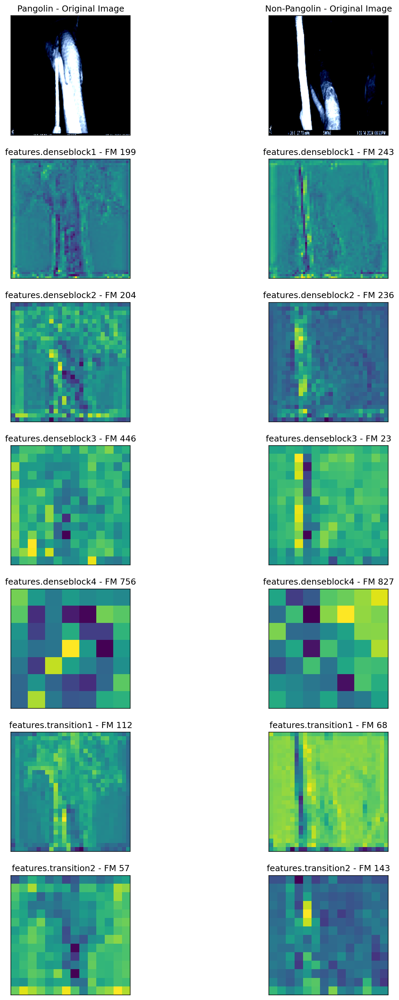

0.33166472613811493
Saving for this epoch 14
Epoch [15/15], Train Loss: 0.3170, Validation Loss: 0.3226
Training Per-Species Metrics:
Precision: 0.9088, Recall: 0.9286, F1: 0.9186
Species 1 - Accuracy: 0.8870, Precision: 0.8357, Recall: 0.7959, F1: 0.8153
Training Overall Accuracy: 0.8870, Precision: 0.8723, Recall: 0.8622, F1: 0.8670
Validation Overall Accuracy: 0.8491, Precision: 0.8481, Recall: 0.7958, F1: 0.8140
Epoch time 148.36413621902466



Test Metrics - Accuracy: 0.8397, Precision: 0.7234, Recall: 0.8095, F1: 0.7640, AUC: 0.9312
Test Per-Species Metrics:
Precision: 0.9048, Recall: 0.8539, F1: 0.8786
Species 1 - Accuracy: 0.8397, Precision: 0.7234, Recall: 0.8095, F1: 0.7640
Fold 2/5


/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2914162].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8267832..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] fo

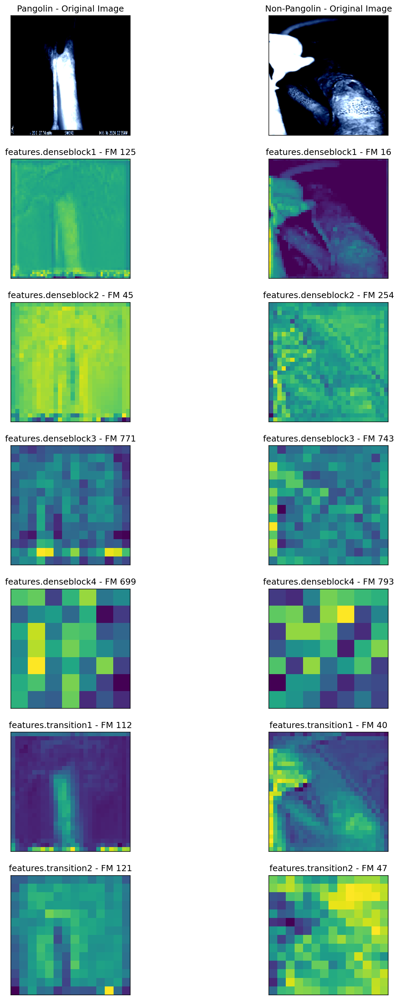

/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Saving for this epoch 0
Epoch [1/15], Train Loss: 0.6614, Validation Loss: 0.6505
Training Per-Species Metrics:
Precision: 0.7232, Recall: 0.7975, F1: 0.7585
Species 1 - Accuracy: 0.6525, Precision: 0.4348, Recall: 0.3378, F1: 0.3802
Training Overall Accuracy: 0.6525, Precision: 0.5790, Recall: 0.5677, F1: 0.5694
Validation Overall Accuracy: 0.6792, Precision: 0.3396, Recall: 0.5000, F1: 0.4045
Epoch time 151.1640350818634





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

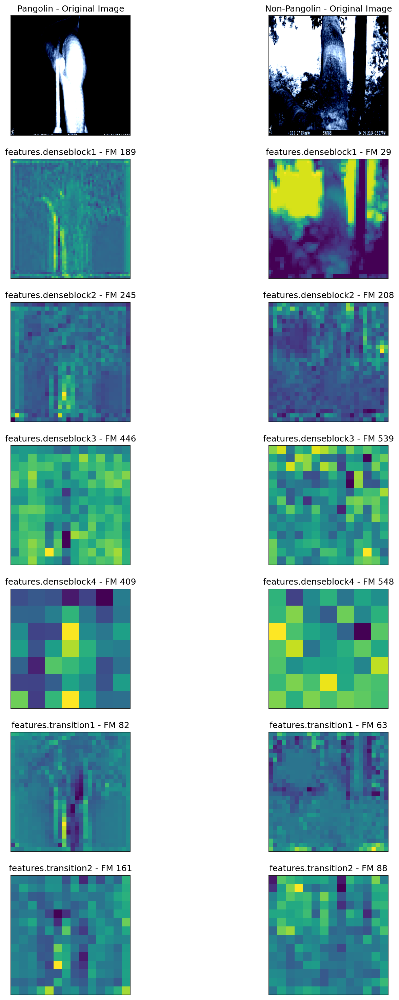

/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_div

0.650458961725235
Saving for this epoch 1
Epoch [2/15], Train Loss: 0.5918, Validation Loss: 0.5671
Training Per-Species Metrics:
Precision: 0.6844, Recall: 1.0000, F1: 0.8127
Species 1 - Accuracy: 0.6844, Precision: 0.0000, Recall: 0.0000, F1: 0.0000
Training Overall Accuracy: 0.6844, Precision: 0.3422, Recall: 0.5000, F1: 0.4063
Validation Overall Accuracy: 0.6792, Precision: 0.3396, Recall: 0.5000, F1: 0.4045
Epoch time 149.93802404403687





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

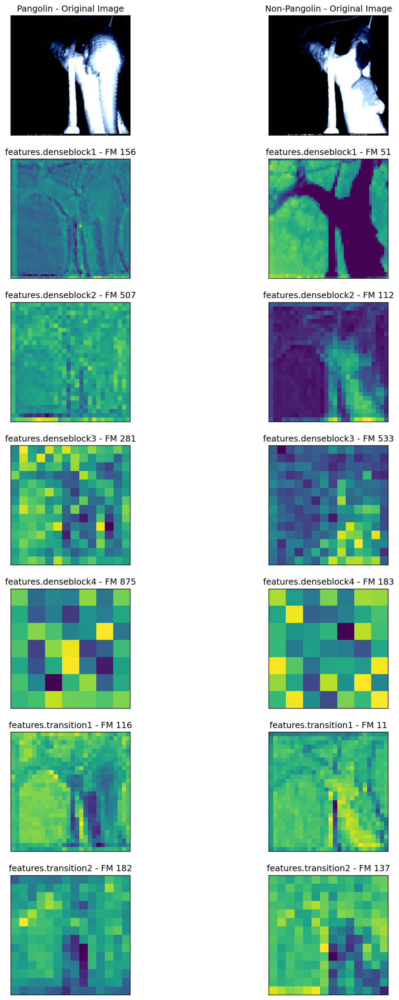

/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_div

0.567143976688385
Saving for this epoch 2
Epoch [3/15], Train Loss: 0.5559, Validation Loss: 0.5222
Training Per-Species Metrics:
Precision: 0.6844, Recall: 1.0000, F1: 0.8127
Species 1 - Accuracy: 0.6844, Precision: 0.0000, Recall: 0.0000, F1: 0.0000
Training Overall Accuracy: 0.6844, Precision: 0.3422, Recall: 0.5000, F1: 0.4063
Validation Overall Accuracy: 0.6792, Precision: 0.3396, Recall: 0.5000, F1: 0.4045
Epoch time 149.3962938785553





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8781574..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8781574..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8781574..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to t

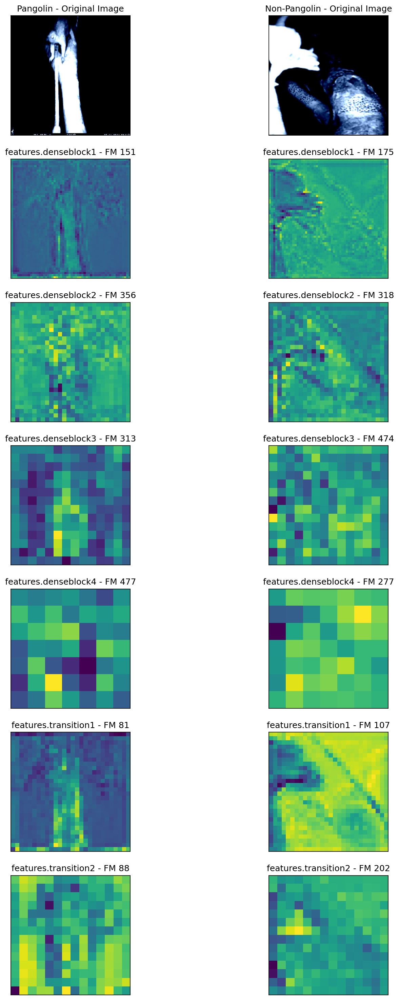

/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_div

0.5221733748912811
Saving for this epoch 3
Epoch [4/15], Train Loss: 0.5350, Validation Loss: 0.4857
Training Per-Species Metrics:
Precision: 0.6844, Recall: 1.0000, F1: 0.8127
Species 1 - Accuracy: 0.6844, Precision: 0.0000, Recall: 0.0000, F1: 0.0000
Training Overall Accuracy: 0.6844, Precision: 0.3422, Recall: 0.5000, F1: 0.4063
Validation Overall Accuracy: 0.6792, Precision: 0.3396, Recall: 0.5000, F1: 0.4045
Epoch time 149.18743681907654





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0494049..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0494049..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0494049..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to t

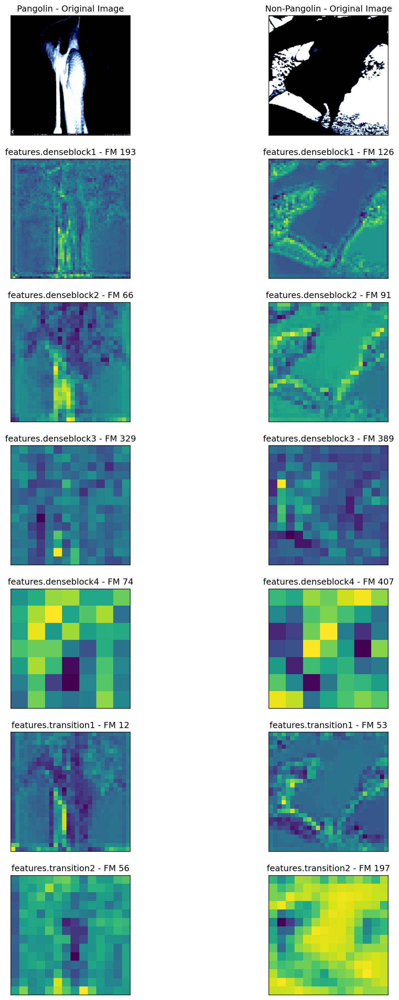

/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_div

0.485669270157814
Saving for this epoch 4
Epoch [5/15], Train Loss: 0.4949, Validation Loss: 0.4574
Training Per-Species Metrics:
Precision: 0.6844, Recall: 1.0000, F1: 0.8127
Species 1 - Accuracy: 0.6844, Precision: 0.0000, Recall: 0.0000, F1: 0.0000
Training Overall Accuracy: 0.6844, Precision: 0.3422, Recall: 0.5000, F1: 0.4063
Validation Overall Accuracy: 0.6792, Precision: 0.3396, Recall: 0.5000, F1: 0.4045
Epoch time 150.020201921463





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

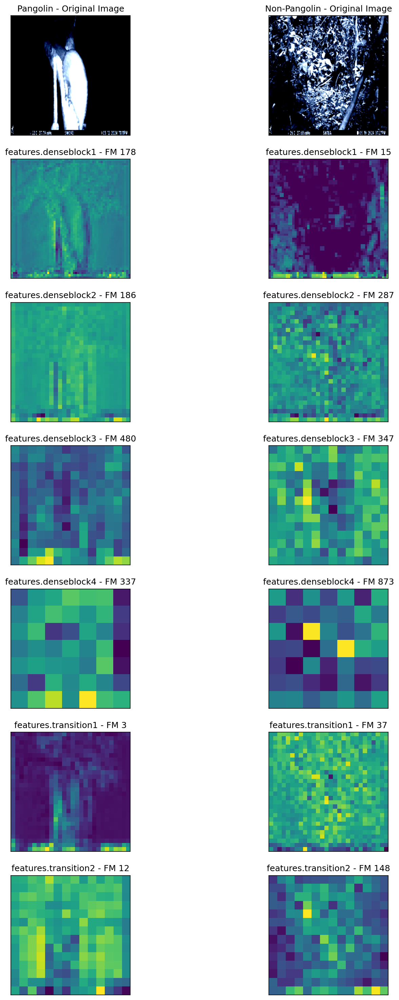

0.4574095159769058
Saving for this epoch 5
Epoch [6/15], Train Loss: 0.4745, Validation Loss: 0.4345
Training Per-Species Metrics:
Precision: 0.6972, Recall: 0.9969, F1: 0.8205
Species 1 - Accuracy: 0.7015, Precision: 0.9000, Recall: 0.0608, F1: 0.1139
Training Overall Accuracy: 0.7015, Precision: 0.7986, Recall: 0.5288, F1: 0.4672
Validation Overall Accuracy: 0.6981, Precision: 0.8462, Recall: 0.5294, F1: 0.4646
Epoch time 149.9463210105896





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2565577].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2565577].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2565577].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2565577].
Clippin

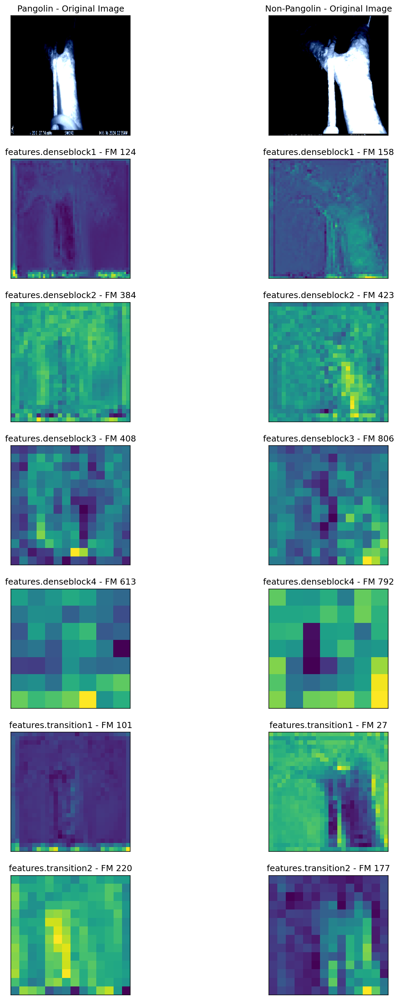

0.43449534475803375
Saving for this epoch 6
Epoch [7/15], Train Loss: 0.4463, Validation Loss: 0.4105
Training Per-Species Metrics:
Precision: 0.7208, Recall: 0.9813, F1: 0.8311
Species 1 - Accuracy: 0.7271, Precision: 0.8125, Recall: 0.1757, F1: 0.2889
Training Overall Accuracy: 0.7271, Precision: 0.7667, Recall: 0.5785, F1: 0.5600
Validation Overall Accuracy: 0.7925, Precision: 0.8830, Recall: 0.6765, F1: 0.6946
Epoch time 149.4884479045868





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8610327..2.3611329].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8610327..2.3611329].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8610327..2.3611329].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8610327..2.3611329].
Cli

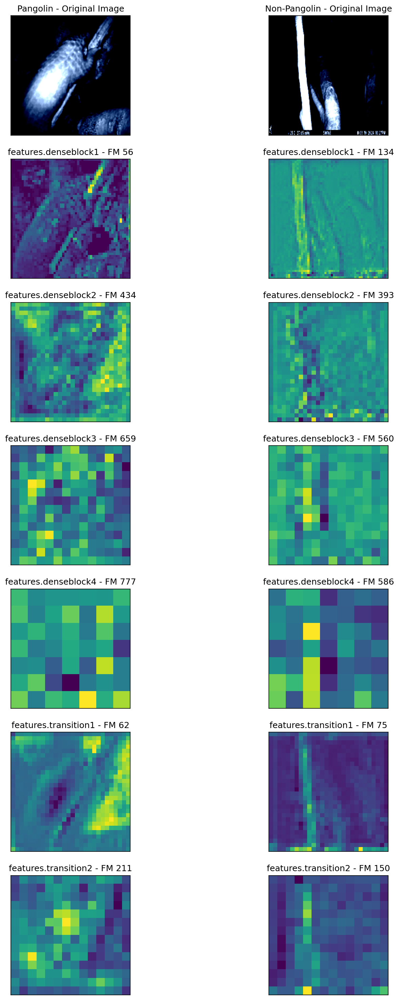

0.4105127155780792
Saving for this epoch 7
Epoch [8/15], Train Loss: 0.4212, Validation Loss: 0.3921
Training Per-Species Metrics:
Precision: 0.7753, Recall: 0.9564, F1: 0.8563
Species 1 - Accuracy: 0.7804, Precision: 0.8082, Recall: 0.3986, F1: 0.5339
Training Overall Accuracy: 0.7804, Precision: 0.7917, Recall: 0.6775, F1: 0.6951
Validation Overall Accuracy: 0.8302, Precision: 0.8570, Recall: 0.7508, F1: 0.7764
Epoch time 150.0428009033203





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

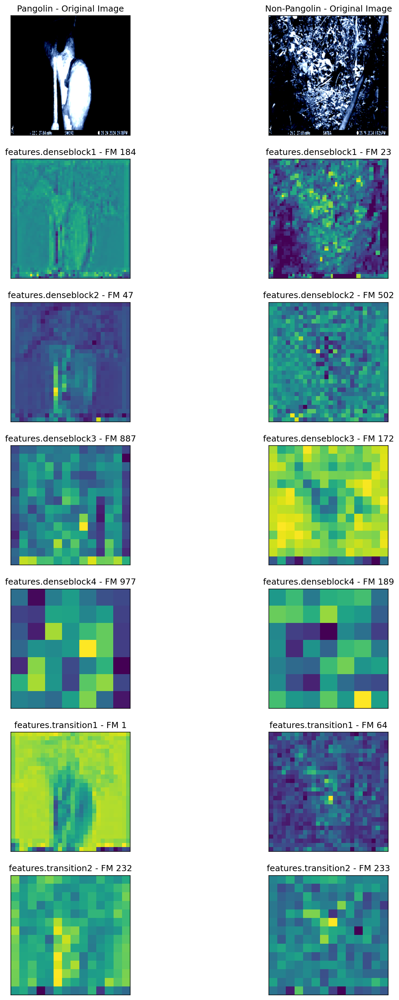

0.3921349197626114
Saving for this epoch 8
Epoch [9/15], Train Loss: 0.4079, Validation Loss: 0.3753
Training Per-Species Metrics:
Precision: 0.8118, Recall: 0.9408, F1: 0.8716
Species 1 - Accuracy: 0.8102, Precision: 0.8041, Recall: 0.5270, F1: 0.6367
Training Overall Accuracy: 0.8102, Precision: 0.8080, Recall: 0.7339, F1: 0.7542
Validation Overall Accuracy: 0.8302, Precision: 0.8570, Recall: 0.7508, F1: 0.7764
Epoch time 151.0807740688324





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

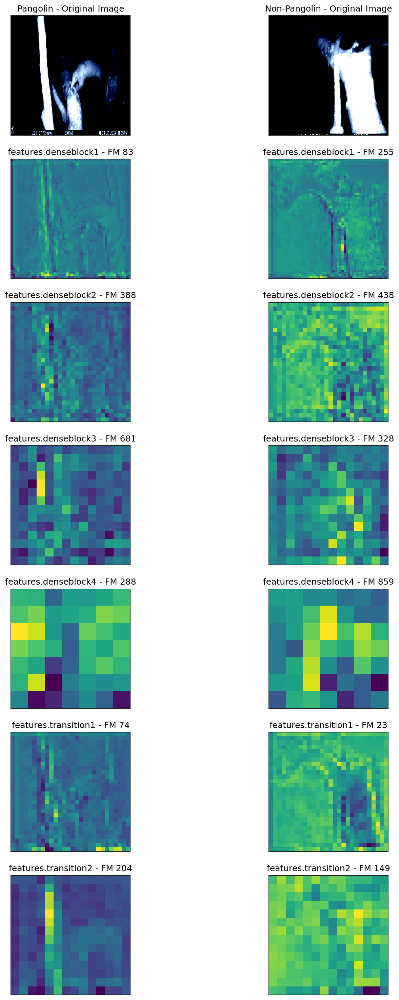

0.3752637803554535
Saving for this epoch 9
Epoch [10/15], Train Loss: 0.3905, Validation Loss: 0.3517
Training Per-Species Metrics:
Precision: 0.8477, Recall: 0.9190, F1: 0.8819
Species 1 - Accuracy: 0.8316, Precision: 0.7851, Recall: 0.6419, F1: 0.7063
Training Overall Accuracy: 0.8316, Precision: 0.8164, Recall: 0.7804, F1: 0.7941
Validation Overall Accuracy: 0.8679, Precision: 0.8852, Recall: 0.8096, F1: 0.8339
Epoch time 150.51479506492615





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7925336..1.3153814].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7925336..1.3153814].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7925336..1.3153814].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7925336..1.3153814].
Cli

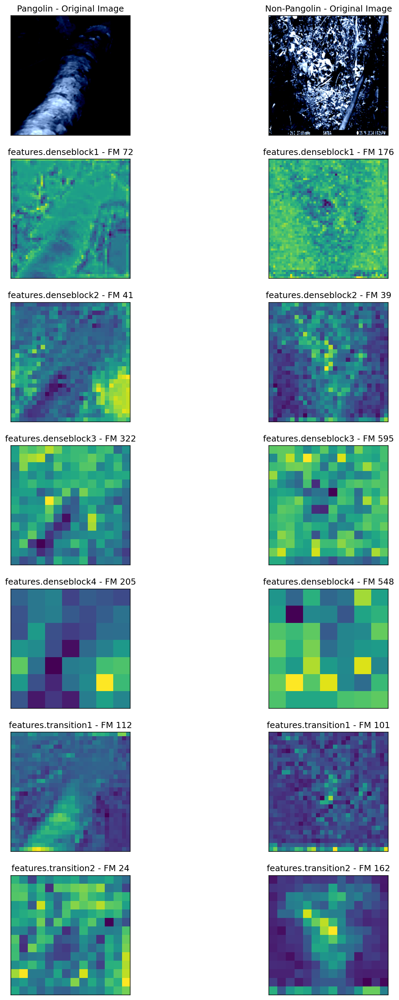

0.35165971517562866
Saving for this epoch 10
Epoch [11/15], Train Loss: 0.3703, Validation Loss: 0.3381
Training Per-Species Metrics:
Precision: 0.8882, Recall: 0.9159, F1: 0.9018
Species 1 - Accuracy: 0.8635, Precision: 0.8043, Recall: 0.7500, F1: 0.7762
Training Overall Accuracy: 0.8635, Precision: 0.8463, Recall: 0.8329, F1: 0.8390
Validation Overall Accuracy: 0.8679, Precision: 0.8852, Recall: 0.8096, F1: 0.8339
Epoch time 149.78434205055237





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

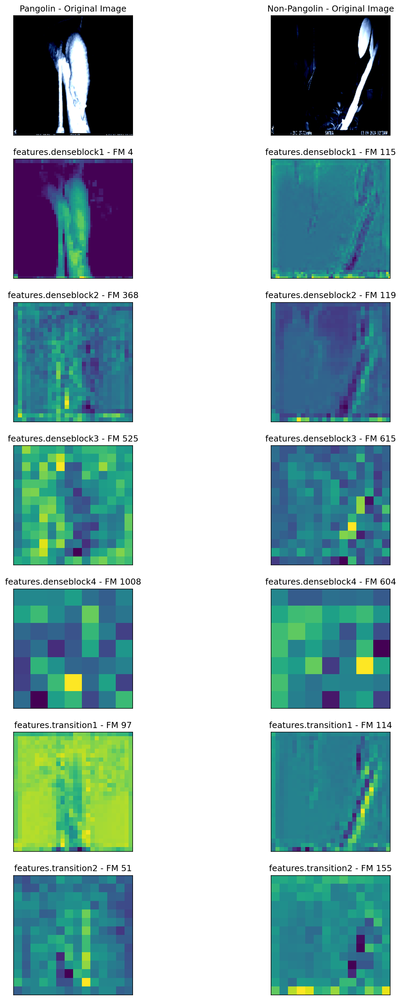

0.3380747139453888
Saving for this epoch 11
Epoch [12/15], Train Loss: 0.3498, Validation Loss: 0.3153
Training Per-Species Metrics:
Precision: 0.8997, Recall: 0.8941, F1: 0.8969
Species 1 - Accuracy: 0.8593, Precision: 0.7733, Recall: 0.7838, F1: 0.7785
Training Overall Accuracy: 0.8593, Precision: 0.8365, Recall: 0.8389, F1: 0.8377
Validation Overall Accuracy: 0.8679, Precision: 0.8852, Recall: 0.8096, F1: 0.8339
Epoch time 148.7641842365265





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

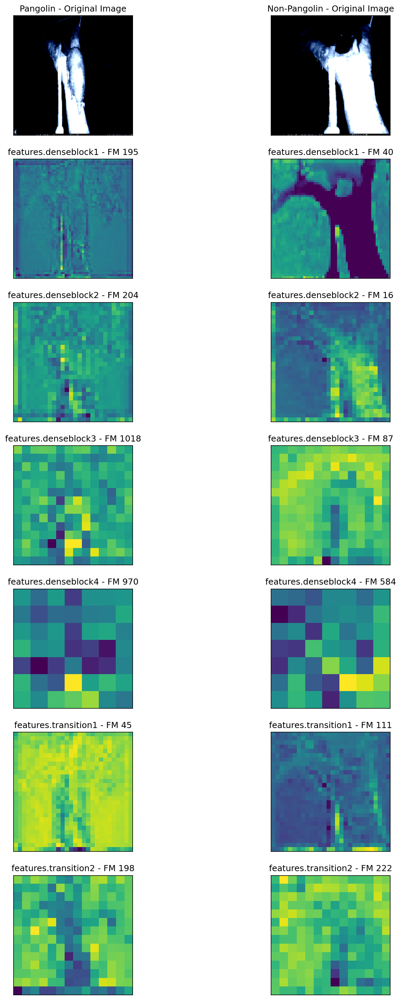

0.31525833904743195
Saving for this epoch 12
Epoch [13/15], Train Loss: 0.3505, Validation Loss: 0.3073
Training Per-Species Metrics:
Precision: 0.9031, Recall: 0.9003, F1: 0.9017
Species 1 - Accuracy: 0.8657, Precision: 0.7852, Recall: 0.7905, F1: 0.7879
Training Overall Accuracy: 0.8657, Precision: 0.8442, Recall: 0.8454, F1: 0.8448
Validation Overall Accuracy: 0.8679, Precision: 0.8852, Recall: 0.8096, F1: 0.8339
Epoch time 148.82921719551086





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

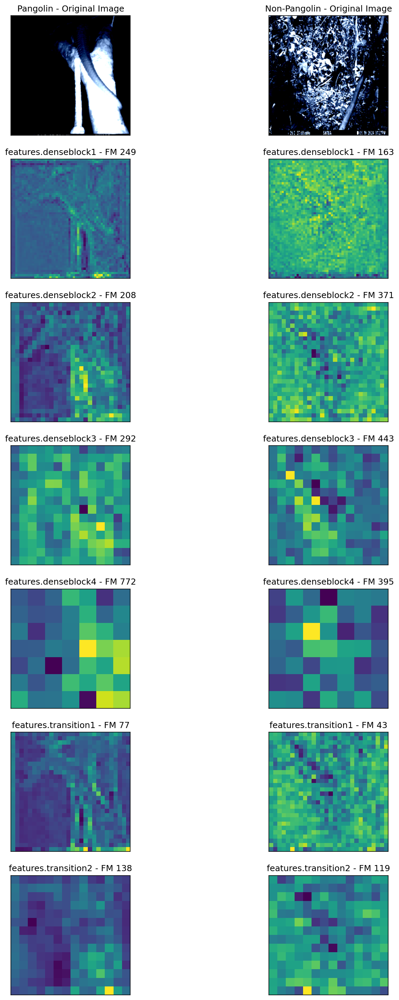

0.307273268699646
Saving for this epoch 13
Epoch [14/15], Train Loss: 0.3080, Validation Loss: 0.2934
Training Per-Species Metrics:
Precision: 0.9245, Recall: 0.9159, F1: 0.9202
Species 1 - Accuracy: 0.8913, Precision: 0.8212, Recall: 0.8378, F1: 0.8294
Training Overall Accuracy: 0.8913, Precision: 0.8729, Recall: 0.8769, F1: 0.8748
Validation Overall Accuracy: 0.8868, Precision: 0.8990, Recall: 0.8391, F1: 0.8605
Epoch time 147.13851761817932





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8610327..2.3611329].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7582842..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8610327..2.3611329].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7582842..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8610327..2.3611329].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7582842..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8610327..2.3611329].


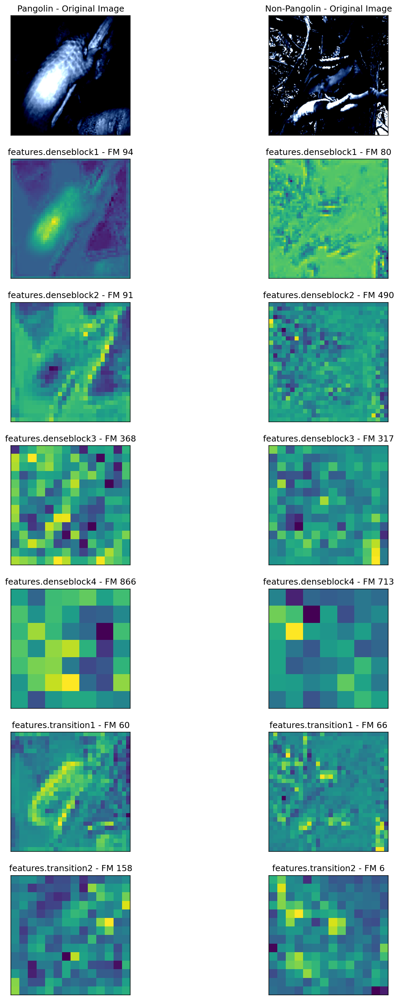

0.2933715581893921
Saving for this epoch 14
Epoch [15/15], Train Loss: 0.3072, Validation Loss: 0.2825
Training Per-Species Metrics:
Precision: 0.9195, Recall: 0.9252, F1: 0.9224
Species 1 - Accuracy: 0.8934, Precision: 0.8356, Recall: 0.8243, F1: 0.8299
Training Overall Accuracy: 0.8934, Precision: 0.8776, Recall: 0.8748, F1: 0.8761
Validation Overall Accuracy: 0.8868, Precision: 0.8990, Recall: 0.8391, F1: 0.8605
Epoch time 149.7307026386261



Test Metrics - Accuracy: 0.8550, Precision: 0.7619, Recall: 0.7805, F1: 0.7711, AUC: 0.9580
Test Per-Species Metrics:
Precision: 0.8989, Recall: 0.8889, F1: 0.8939
Species 1 - Accuracy: 0.8550, Precision: 0.7619, Recall: 0.7805, F1: 0.7711
Fold 3/5


/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3088455].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9466565..2.5179958].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..25

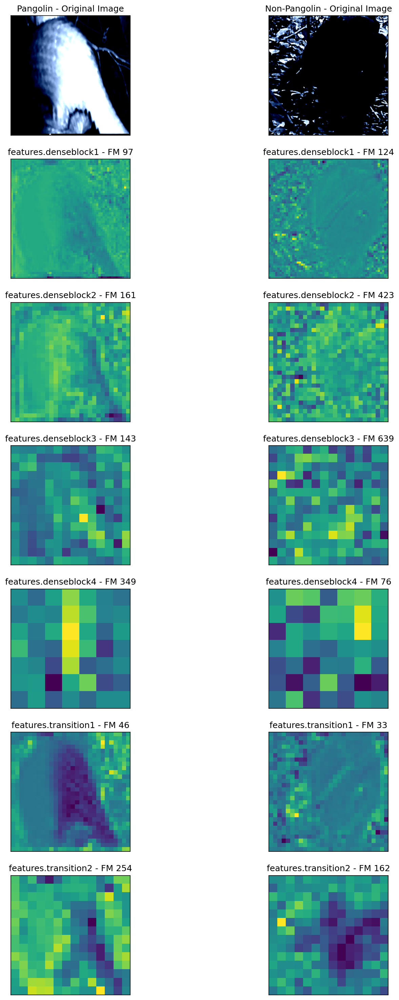

/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Saving for this epoch 0
Epoch [1/15], Train Loss: 0.6662, Validation Loss: 0.6601
Training Per-Species Metrics:
Precision: 0.6868, Recall: 0.7788, F1: 0.7299
Species 1 - Accuracy: 0.6055, Precision: 0.3238, Recall: 0.2297, F1: 0.2688
Training Overall Accuracy: 0.6055, Precision: 0.5053, Recall: 0.5043, F1: 0.4994
Validation Overall Accuracy: 0.6792, Precision: 0.3396, Recall: 0.5000, F1: 0.4045
Epoch time 149.4888038635254





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

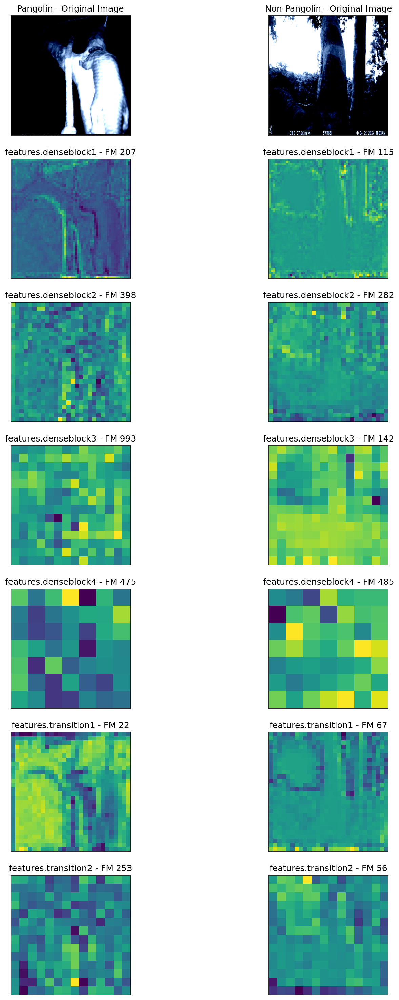

/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_div

0.6601119041442871
Saving for this epoch 1
Epoch [2/15], Train Loss: 0.6009, Validation Loss: 0.6149
Training Per-Species Metrics:
Precision: 0.6844, Recall: 1.0000, F1: 0.8127
Species 1 - Accuracy: 0.6844, Precision: 0.0000, Recall: 0.0000, F1: 0.0000
Training Overall Accuracy: 0.6844, Precision: 0.3422, Recall: 0.5000, F1: 0.4063
Validation Overall Accuracy: 0.6792, Precision: 0.3396, Recall: 0.5000, F1: 0.4045
Epoch time 149.28390192985535





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

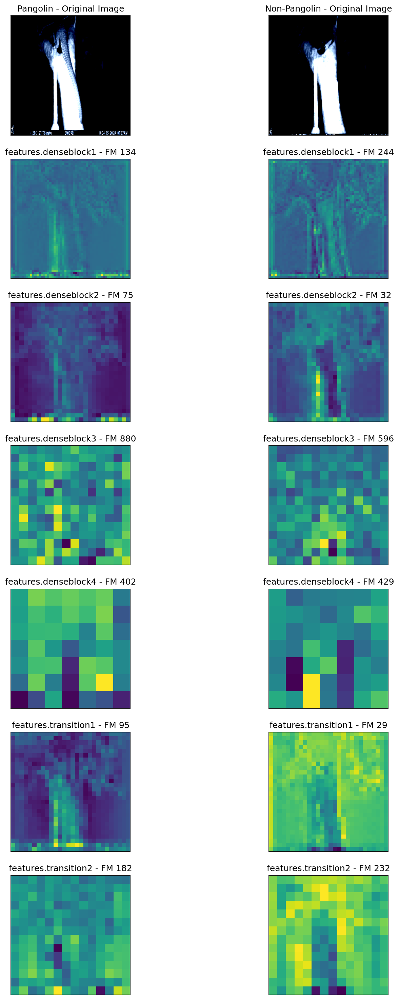

/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_div

0.6148925721645355
Saving for this epoch 2
Epoch [3/15], Train Loss: 0.5712, Validation Loss: 0.5814
Training Per-Species Metrics:
Precision: 0.6844, Recall: 1.0000, F1: 0.8127
Species 1 - Accuracy: 0.6844, Precision: 0.0000, Recall: 0.0000, F1: 0.0000
Training Overall Accuracy: 0.6844, Precision: 0.3422, Recall: 0.5000, F1: 0.4063
Validation Overall Accuracy: 0.6792, Precision: 0.3396, Recall: 0.5000, F1: 0.4045
Epoch time 149.2480001449585





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7582842..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7582842..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7582842..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to t

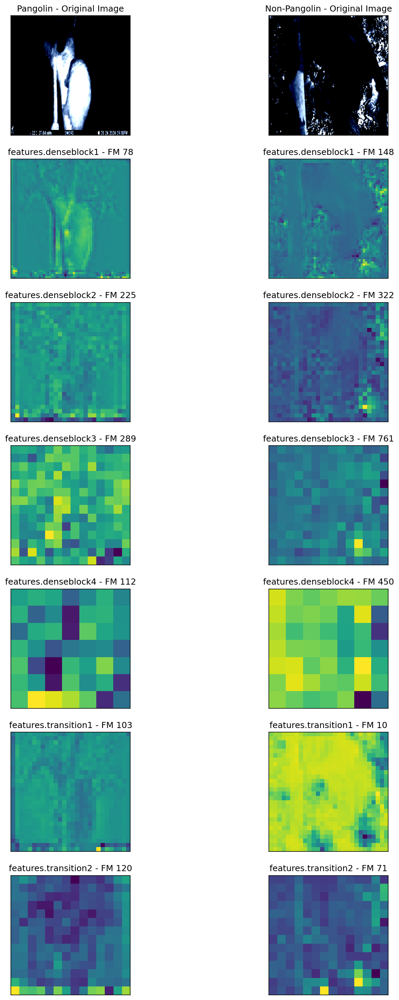

/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_div

0.5813831686973572
Saving for this epoch 3
Epoch [4/15], Train Loss: 0.5415, Validation Loss: 0.5504
Training Per-Species Metrics:
Precision: 0.6844, Recall: 1.0000, F1: 0.8127
Species 1 - Accuracy: 0.6844, Precision: 0.0000, Recall: 0.0000, F1: 0.0000
Training Overall Accuracy: 0.6844, Precision: 0.3422, Recall: 0.5000, F1: 0.4063
Validation Overall Accuracy: 0.6792, Precision: 0.3396, Recall: 0.5000, F1: 0.4045
Epoch time 149.33043813705444





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

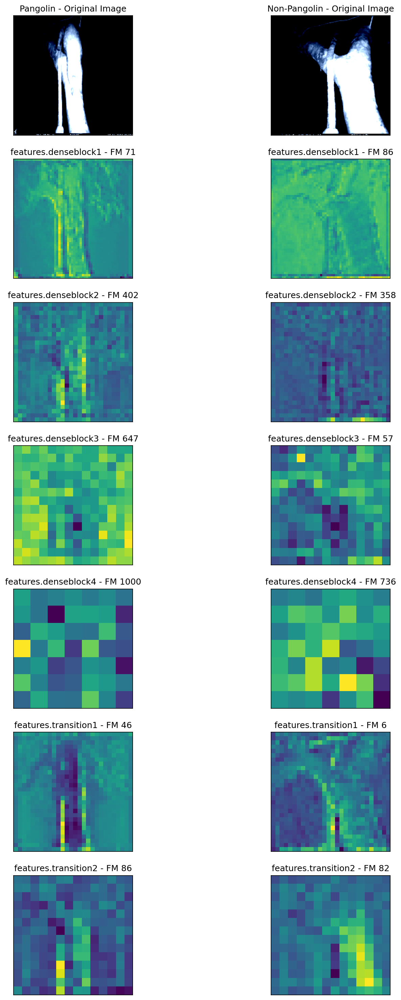

/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_div

0.5503921210765839
Saving for this epoch 4
Epoch [5/15], Train Loss: 0.5242, Validation Loss: 0.5193
Training Per-Species Metrics:
Precision: 0.6844, Recall: 1.0000, F1: 0.8127
Species 1 - Accuracy: 0.6844, Precision: 0.0000, Recall: 0.0000, F1: 0.0000
Training Overall Accuracy: 0.6844, Precision: 0.3422, Recall: 0.5000, F1: 0.4063
Validation Overall Accuracy: 0.6792, Precision: 0.3396, Recall: 0.5000, F1: 0.4045
Epoch time 149.3410837650299





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8267832..0.51363856].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8267832..0.51363856].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8267832..0.51363856].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clippi

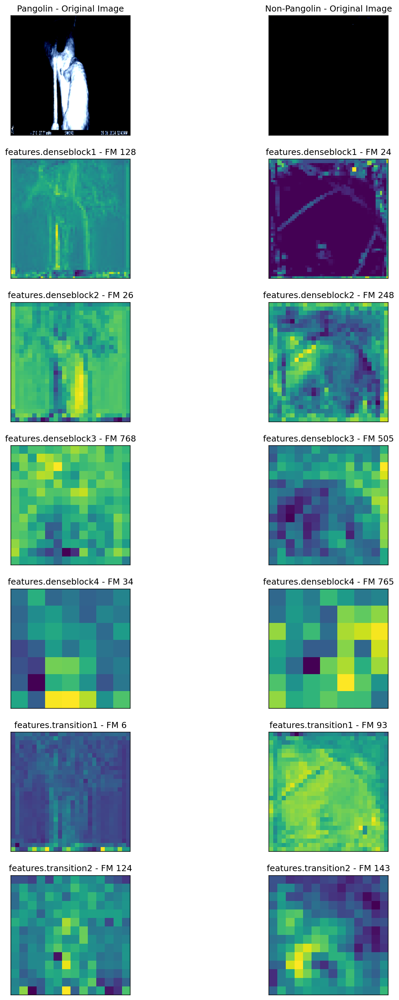

/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_div

0.5193139016628265
Saving for this epoch 5
Epoch [6/15], Train Loss: 0.5012, Validation Loss: 0.4919
Training Per-Species Metrics:
Precision: 0.6844, Recall: 1.0000, F1: 0.8127
Species 1 - Accuracy: 0.6844, Precision: 0.0000, Recall: 0.0000, F1: 0.0000
Training Overall Accuracy: 0.6844, Precision: 0.3422, Recall: 0.5000, F1: 0.4063
Validation Overall Accuracy: 0.6792, Precision: 0.3396, Recall: 0.5000, F1: 0.4045
Epoch time 148.9522750377655





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

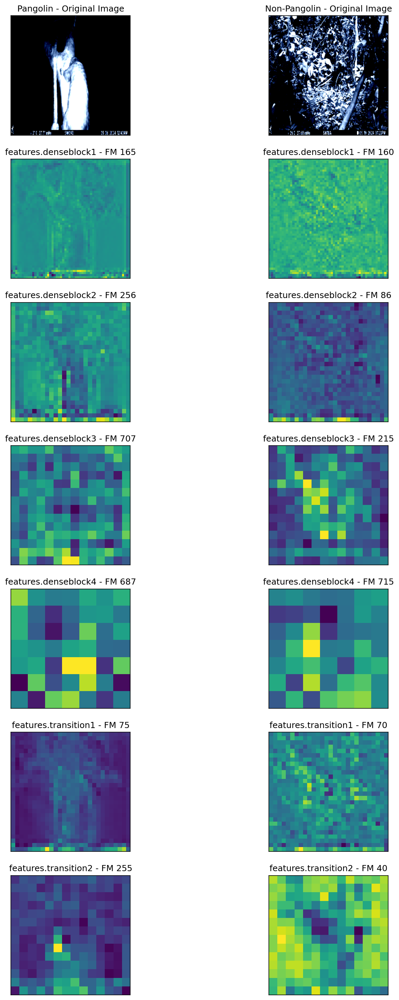

0.4918704926967621
Saving for this epoch 6
Epoch [7/15], Train Loss: 0.4688, Validation Loss: 0.4652
Training Per-Species Metrics:
Precision: 0.7165, Recall: 1.0000, F1: 0.8349
Species 1 - Accuracy: 0.7292, Precision: 1.0000, Recall: 0.1419, F1: 0.2485
Training Overall Accuracy: 0.7292, Precision: 0.8583, Recall: 0.5709, F1: 0.5417
Validation Overall Accuracy: 0.7925, Precision: 0.8830, Recall: 0.6765, F1: 0.6946
Epoch time 149.25481581687927





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

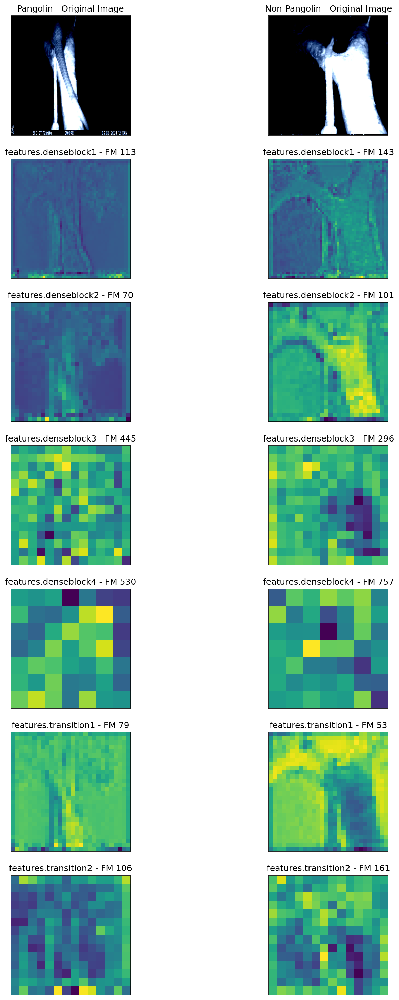

0.4652004837989807
Saving for this epoch 7
Epoch [8/15], Train Loss: 0.4507, Validation Loss: 0.4409
Training Per-Species Metrics:
Precision: 0.7704, Recall: 0.9720, F1: 0.8595
Species 1 - Accuracy: 0.7825, Precision: 0.8594, Recall: 0.3716, F1: 0.5189
Training Overall Accuracy: 0.7825, Precision: 0.8149, Recall: 0.6718, F1: 0.6892
Validation Overall Accuracy: 0.8868, Precision: 0.9286, Recall: 0.8235, F1: 0.8544
Epoch time 148.80594396591187





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

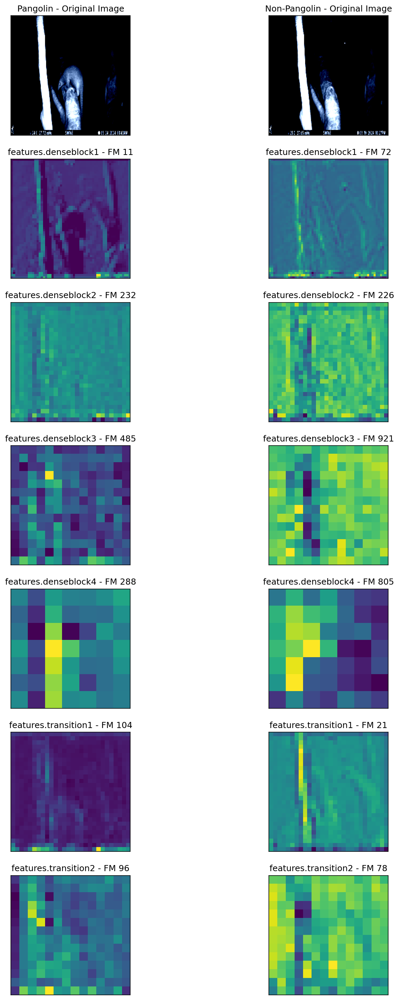

0.44090786576271057
Saving for this epoch 8
Epoch [9/15], Train Loss: 0.4246, Validation Loss: 0.4077
Training Per-Species Metrics:
Precision: 0.7969, Recall: 0.9533, F1: 0.8681
Species 1 - Accuracy: 0.8017, Precision: 0.8235, Recall: 0.4730, F1: 0.6009
Training Overall Accuracy: 0.8017, Precision: 0.8102, Recall: 0.7131, F1: 0.7345
Validation Overall Accuracy: 0.9057, Precision: 0.9390, Recall: 0.8529, F1: 0.8813
Epoch time 148.42168307304382





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7411594..1.9254032].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7411594..1.9254032].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7411594..1.9254032].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7411594..1.9254032].
Cli

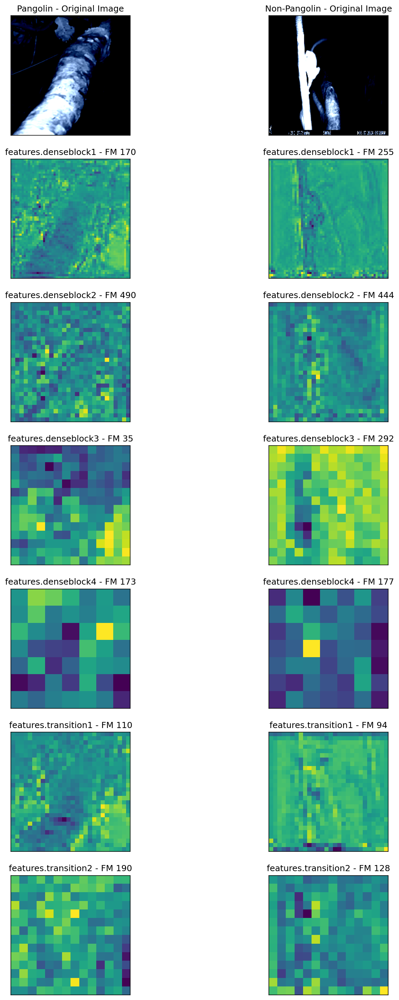

0.4077296406030655
Saving for this epoch 9
Epoch [10/15], Train Loss: 0.4078, Validation Loss: 0.3854
Training Per-Species Metrics:
Precision: 0.8071, Recall: 0.9252, F1: 0.8621
Species 1 - Accuracy: 0.7974, Precision: 0.7624, Recall: 0.5203, F1: 0.6185
Training Overall Accuracy: 0.7974, Precision: 0.7847, Recall: 0.7228, F1: 0.7403
Validation Overall Accuracy: 0.9245, Precision: 0.9500, Recall: 0.8824, F1: 0.9070
Epoch time 147.90463995933533





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

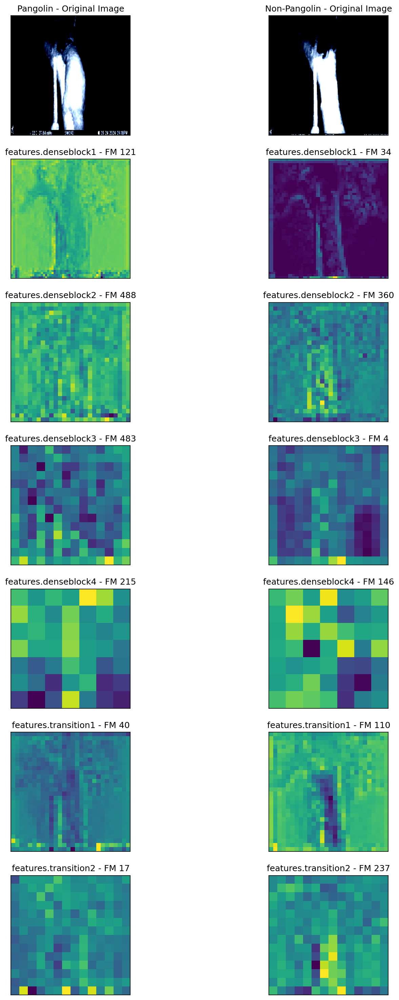

0.3854482173919678
Saving for this epoch 10
Epoch [11/15], Train Loss: 0.3887, Validation Loss: 0.3634
Training Per-Species Metrics:
Precision: 0.8477, Recall: 0.9190, F1: 0.8819
Species 1 - Accuracy: 0.8316, Precision: 0.7851, Recall: 0.6419, F1: 0.7063
Training Overall Accuracy: 0.8316, Precision: 0.8164, Recall: 0.7804, F1: 0.7941
Validation Overall Accuracy: 0.9623, Precision: 0.9567, Recall: 0.9567, F1: 0.9567
Epoch time 147.73968625068665





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0151556..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0151556..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0151556..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to t

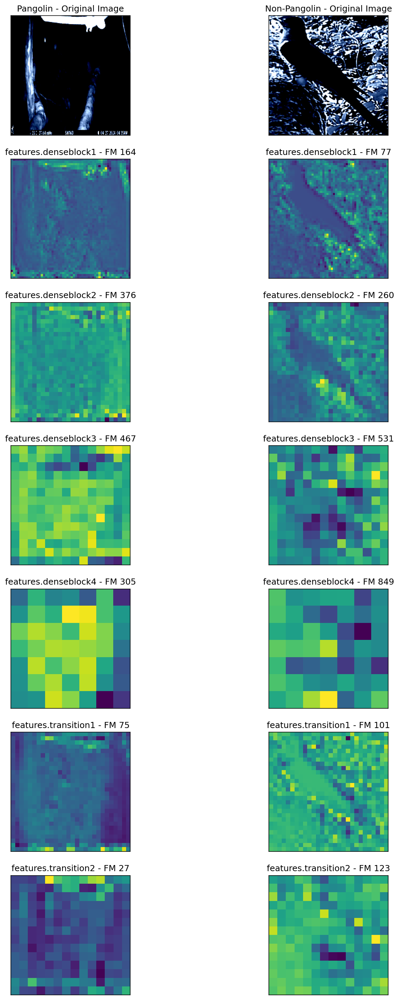

0.363374724984169
Saving for this epoch 11
Epoch [12/15], Train Loss: 0.3755, Validation Loss: 0.3385
Training Per-Species Metrics:
Precision: 0.8906, Recall: 0.8879, F1: 0.8892
Species 1 - Accuracy: 0.8486, Precision: 0.7584, Recall: 0.7635, F1: 0.7609
Training Overall Accuracy: 0.8486, Precision: 0.8245, Recall: 0.8257, F1: 0.8251
Validation Overall Accuracy: 0.9434, Precision: 0.9302, Recall: 0.9428, F1: 0.9360
Epoch time 147.311457157135





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8267832..2.169412].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1007793..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8267832..2.169412].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1007793..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8267832..2.169412].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1007793..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8267832..2.169412].
Clip

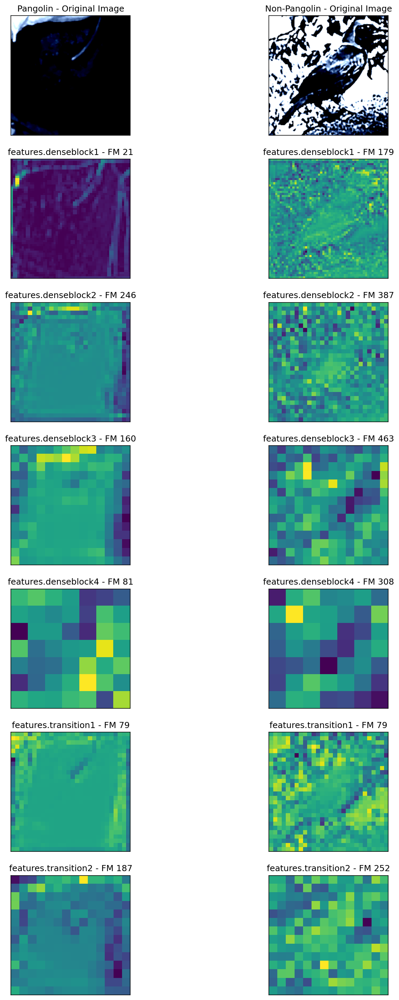

0.3384635001420975
Saving for this epoch 12
Epoch [13/15], Train Loss: 0.3676, Validation Loss: 0.3171
Training Per-Species Metrics:
Precision: 0.8872, Recall: 0.9065, F1: 0.8968
Species 1 - Accuracy: 0.8571, Precision: 0.7872, Recall: 0.7500, F1: 0.7682
Training Overall Accuracy: 0.8571, Precision: 0.8372, Recall: 0.8283, F1: 0.8325
Validation Overall Accuracy: 0.9623, Precision: 0.9567, Recall: 0.9567, F1: 0.9567
Epoch time 147.8648030757904





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0151556..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0151556..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0151556..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to t

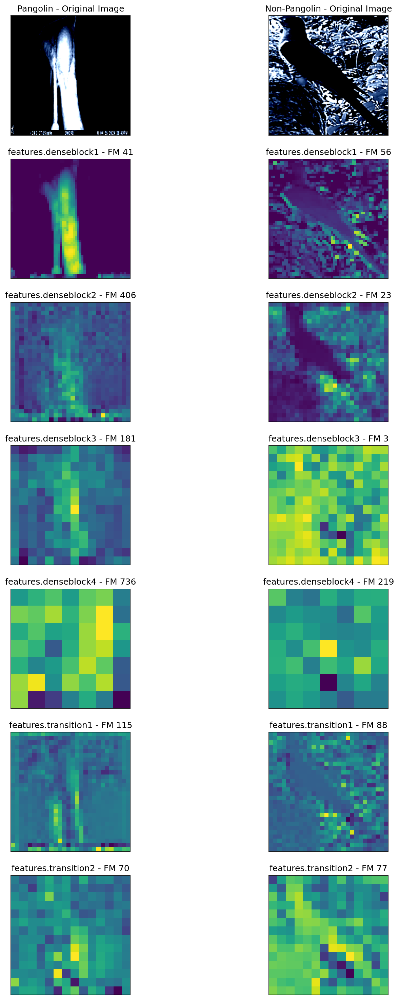

0.31712910532951355
Saving for this epoch 13
Epoch [14/15], Train Loss: 0.3551, Validation Loss: 0.3104
Training Per-Species Metrics:
Precision: 0.8792, Recall: 0.9065, F1: 0.8926
Species 1 - Accuracy: 0.8507, Precision: 0.7826, Recall: 0.7297, F1: 0.7552
Training Overall Accuracy: 0.8507, Precision: 0.8309, Recall: 0.8181, F1: 0.8239
Validation Overall Accuracy: 0.9434, Precision: 0.9302, Recall: 0.9428, F1: 0.9360
Epoch time 149.26293873786926





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

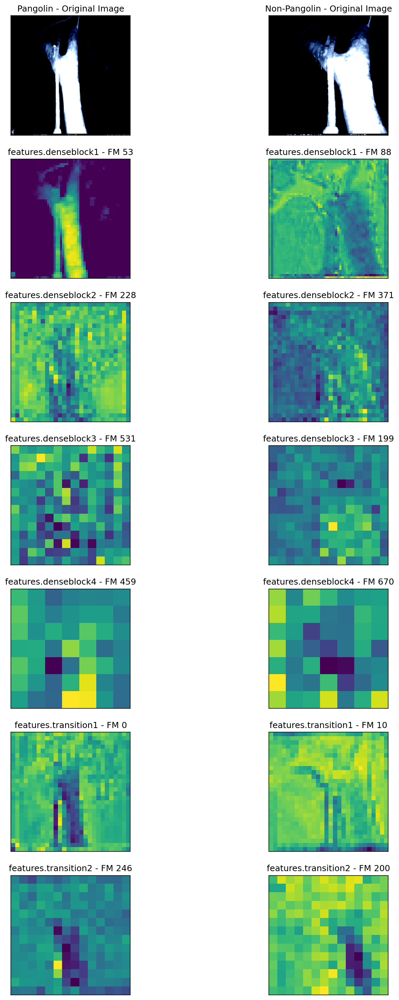

0.31038160622119904
Saving for this epoch 14
Epoch [15/15], Train Loss: 0.3406, Validation Loss: 0.2875
Training Per-Species Metrics:
Precision: 0.9200, Recall: 0.8598, F1: 0.8889
Species 1 - Accuracy: 0.8529, Precision: 0.7337, Recall: 0.8378, F1: 0.7823
Training Overall Accuracy: 0.8529, Precision: 0.8269, Recall: 0.8488, F1: 0.8356
Validation Overall Accuracy: 0.9434, Precision: 0.9302, Recall: 0.9428, F1: 0.9360
Epoch time 158.739914894104



Test Metrics - Accuracy: 0.8779, Precision: 0.8049, Recall: 0.8049, F1: 0.8049, AUC: 0.9547
Test Per-Species Metrics:
Precision: 0.9111, Recall: 0.9111, F1: 0.9111
Species 1 - Accuracy: 0.8779, Precision: 0.8049, Recall: 0.8049, F1: 0.8049
Fold 4/5


/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0494049..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for int

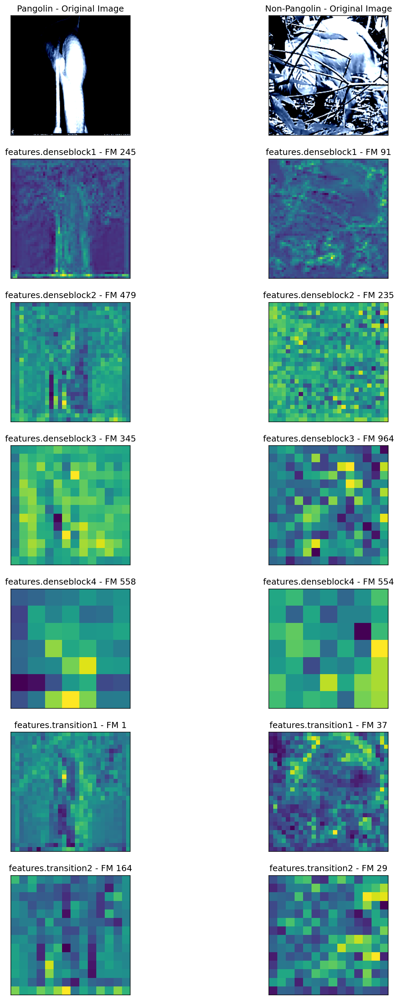

/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Saving for this epoch 0
Epoch [1/15], Train Loss: 0.6669, Validation Loss: 0.6653
Training Per-Species Metrics:
Precision: 0.6909, Recall: 0.9161, F1: 0.7877
Species 1 - Accuracy: 0.6617, Precision: 0.3721, Recall: 0.1081, F1: 0.1675
Training Overall Accuracy: 0.6617, Precision: 0.5315, Recall: 0.5121, F1: 0.4776
Validation Overall Accuracy: 0.6792, Precision: 0.3396, Recall: 0.5000, F1: 0.4045
Epoch time 148.26402401924133





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9466565..2.5179958].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9466565..2.5179958].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9466565..2.5179958].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping 

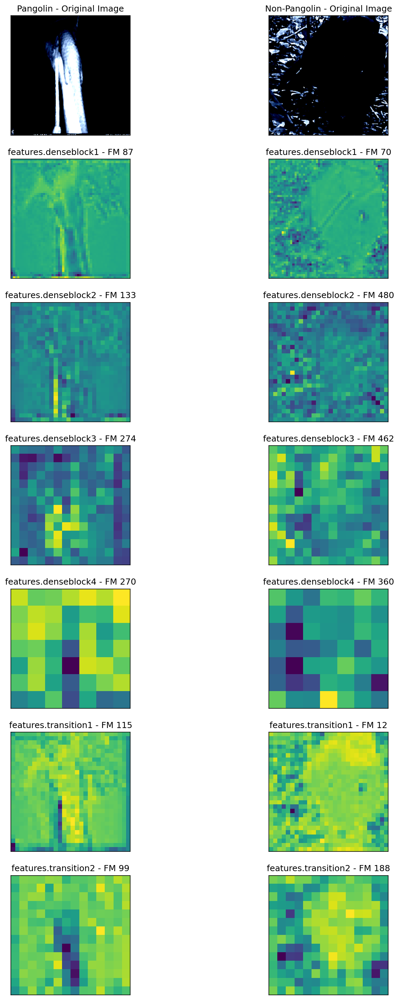

/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_div

0.6652766764163971
Saving for this epoch 1
Epoch [2/15], Train Loss: 0.6148, Validation Loss: 0.6134
Training Per-Species Metrics:
Precision: 0.6851, Recall: 1.0000, F1: 0.8131
Species 1 - Accuracy: 0.6851, Precision: 0.0000, Recall: 0.0000, F1: 0.0000
Training Overall Accuracy: 0.6851, Precision: 0.3426, Recall: 0.5000, F1: 0.4066
Validation Overall Accuracy: 0.6792, Precision: 0.3396, Recall: 0.5000, F1: 0.4045
Epoch time 148.4968330860138





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3785625].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9124069..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3785625].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9124069..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3785625].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9124069..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3785625].
Clip

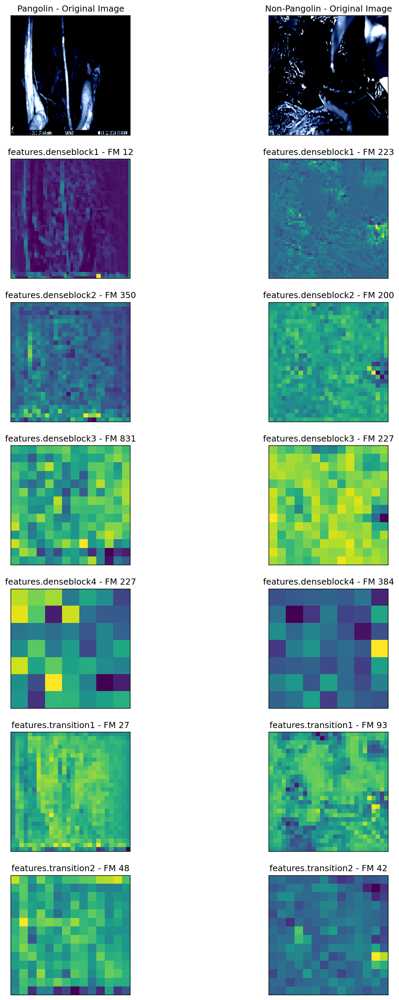

/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_div

0.6133646070957184
Saving for this epoch 2
Epoch [3/15], Train Loss: 0.5878, Validation Loss: 0.5808
Training Per-Species Metrics:
Precision: 0.6851, Recall: 1.0000, F1: 0.8131
Species 1 - Accuracy: 0.6851, Precision: 0.0000, Recall: 0.0000, F1: 0.0000
Training Overall Accuracy: 0.6851, Precision: 0.3426, Recall: 0.5000, F1: 0.4066
Validation Overall Accuracy: 0.6792, Precision: 0.3396, Recall: 0.5000, F1: 0.4045
Epoch time 148.92760491371155





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

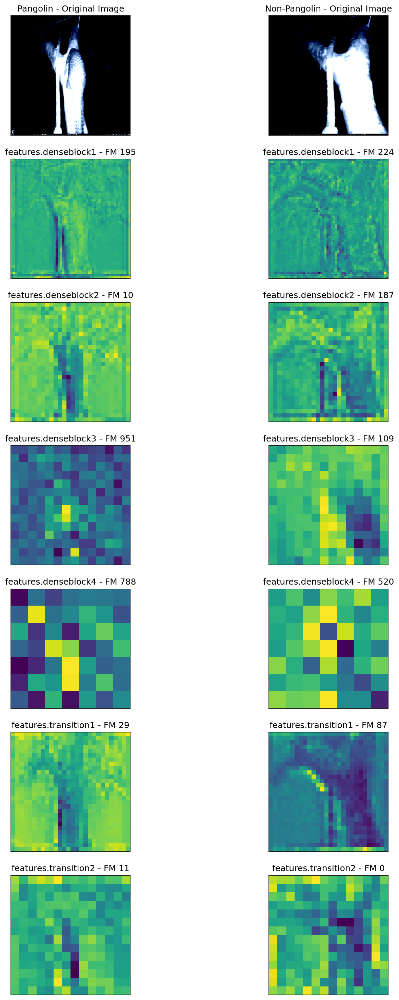

/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_div

0.5808292925357819
Saving for this epoch 3
Epoch [4/15], Train Loss: 0.5632, Validation Loss: 0.5586
Training Per-Species Metrics:
Precision: 0.6851, Recall: 1.0000, F1: 0.8131
Species 1 - Accuracy: 0.6851, Precision: 0.0000, Recall: 0.0000, F1: 0.0000
Training Overall Accuracy: 0.6851, Precision: 0.3426, Recall: 0.5000, F1: 0.4066
Validation Overall Accuracy: 0.6792, Precision: 0.3396, Recall: 0.5000, F1: 0.4045
Epoch time 149.1828899383545





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3785625].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9980307..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3785625].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9980307..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3785625].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9980307..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3785625].
Clip

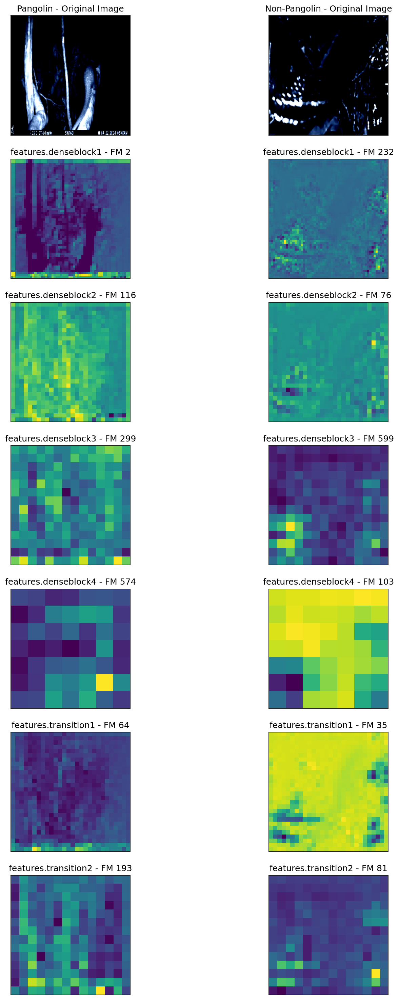

/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_div

0.558552473783493
Saving for this epoch 4
Epoch [5/15], Train Loss: 0.5499, Validation Loss: 0.5389
Training Per-Species Metrics:
Precision: 0.6851, Recall: 1.0000, F1: 0.8131
Species 1 - Accuracy: 0.6851, Precision: 0.0000, Recall: 0.0000, F1: 0.0000
Training Overall Accuracy: 0.6851, Precision: 0.3426, Recall: 0.5000, F1: 0.4066
Validation Overall Accuracy: 0.6792, Precision: 0.3396, Recall: 0.5000, F1: 0.4045
Epoch time 149.5360939502716





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7582842..2.2565577].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7582842..2.2565577].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7582842..2.2565577].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7582842..2.2565577].
Cli

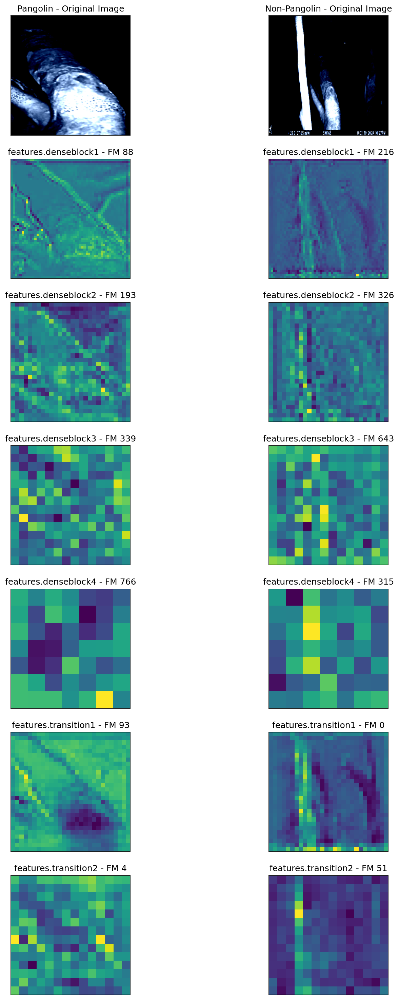

/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_div

0.5388696789741516
Saving for this epoch 5
Epoch [6/15], Train Loss: 0.5246, Validation Loss: 0.5183
Training Per-Species Metrics:
Precision: 0.6851, Recall: 1.0000, F1: 0.8131
Species 1 - Accuracy: 0.6851, Precision: 0.0000, Recall: 0.0000, F1: 0.0000
Training Overall Accuracy: 0.6851, Precision: 0.3426, Recall: 0.5000, F1: 0.4066
Validation Overall Accuracy: 0.6792, Precision: 0.3396, Recall: 0.5000, F1: 0.4045
Epoch time 148.82386112213135





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2914162].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2914162].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2914162].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2914162].
Clippin

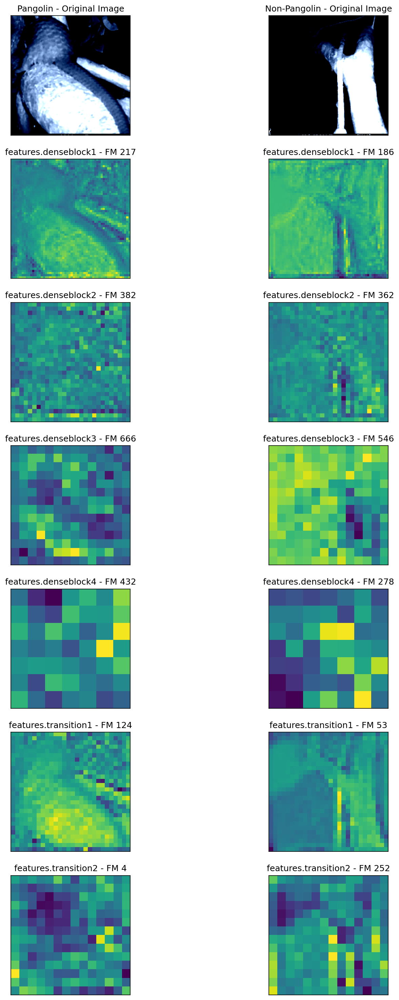

/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_div

0.5183343589305878
Saving for this epoch 6
Epoch [7/15], Train Loss: 0.5003, Validation Loss: 0.4964
Training Per-Species Metrics:
Precision: 0.6851, Recall: 1.0000, F1: 0.8131
Species 1 - Accuracy: 0.6851, Precision: 0.0000, Recall: 0.0000, F1: 0.0000
Training Overall Accuracy: 0.6851, Precision: 0.3426, Recall: 0.5000, F1: 0.4066
Validation Overall Accuracy: 0.6792, Precision: 0.3396, Recall: 0.5000, F1: 0.4045
Epoch time 148.90537786483765





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.169412].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.169412].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.169412].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input 

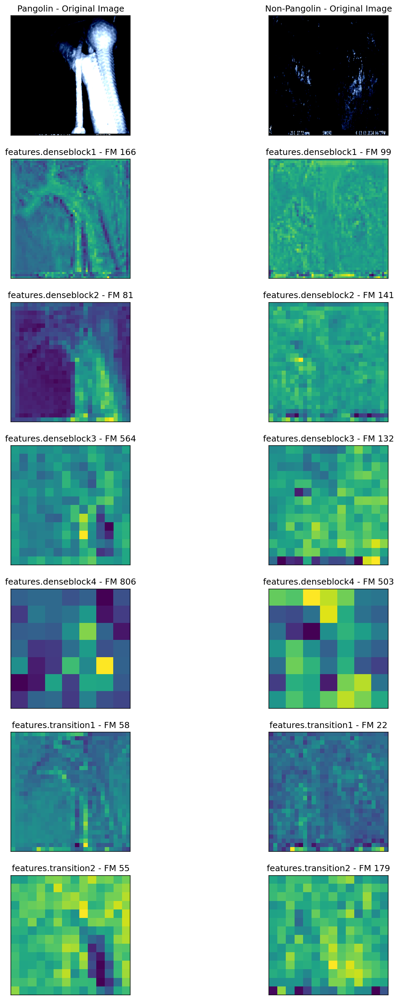

/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


0.49642226099967957
Saving for this epoch 7
Epoch [8/15], Train Loss: 0.4789, Validation Loss: 0.4744
Training Per-Species Metrics:
Precision: 0.6910, Recall: 1.0000, F1: 0.8173
Species 1 - Accuracy: 0.6936, Precision: 1.0000, Recall: 0.0270, F1: 0.0526
Training Overall Accuracy: 0.6936, Precision: 0.8455, Recall: 0.5135, F1: 0.4349
Validation Overall Accuracy: 0.6792, Precision: 0.3396, Recall: 0.5000, F1: 0.4045
Epoch time 150.40307307243347





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9637812..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9637812..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9637812..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to t

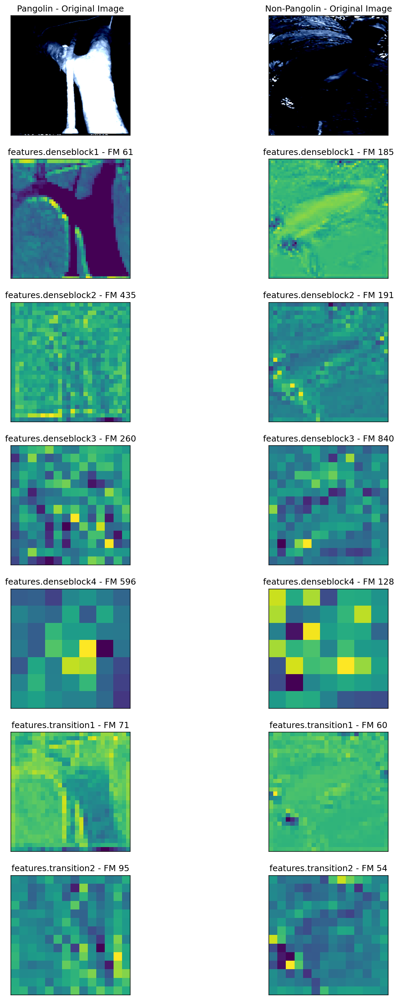

0.47441069781780243
Saving for this epoch 8
Epoch [9/15], Train Loss: 0.4614, Validation Loss: 0.4541
Training Per-Species Metrics:
Precision: 0.7124, Recall: 1.0000, F1: 0.8320
Species 1 - Accuracy: 0.7234, Precision: 1.0000, Recall: 0.1216, F1: 0.2169
Training Overall Accuracy: 0.7234, Precision: 0.8562, Recall: 0.5608, F1: 0.5245
Validation Overall Accuracy: 0.7547, Precision: 0.8673, Recall: 0.6176, F1: 0.6140
Epoch time 149.03734397888184





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

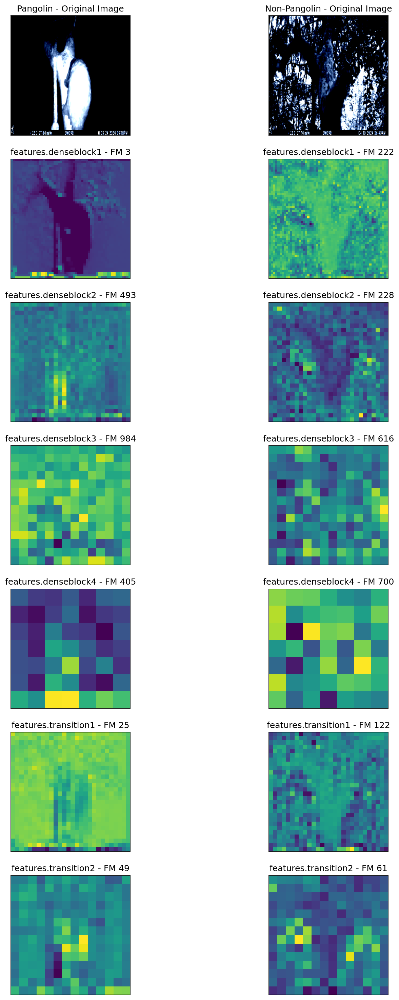

0.4541051685810089
Saving for this epoch 9
Epoch [10/15], Train Loss: 0.4370, Validation Loss: 0.4282
Training Per-Species Metrics:
Precision: 0.7571, Recall: 0.9876, F1: 0.8571
Species 1 - Accuracy: 0.7745, Precision: 0.9200, Recall: 0.3108, F1: 0.4646
Training Overall Accuracy: 0.7745, Precision: 0.8386, Recall: 0.6492, F1: 0.6609
Validation Overall Accuracy: 0.8302, Precision: 0.9000, Recall: 0.7353, F1: 0.7644
Epoch time 148.71669602394104





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3088455].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3088455].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3088455].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3088455].
Clippin

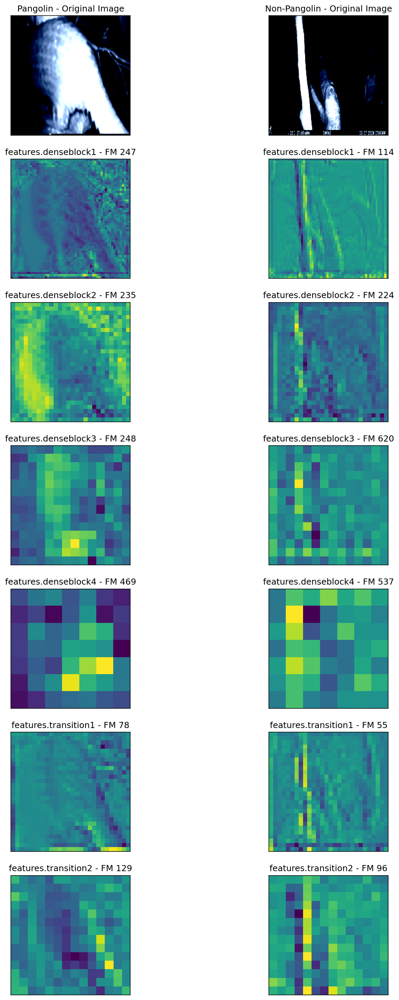

0.42821697890758514
Saving for this epoch 10
Epoch [11/15], Train Loss: 0.4239, Validation Loss: 0.4076
Training Per-Species Metrics:
Precision: 0.7736, Recall: 0.9658, F1: 0.8591
Species 1 - Accuracy: 0.7830, Precision: 0.8382, Recall: 0.3851, F1: 0.5278
Training Overall Accuracy: 0.7830, Precision: 0.8059, Recall: 0.6755, F1: 0.6934
Validation Overall Accuracy: 0.8302, Precision: 0.8313, Recall: 0.7663, F1: 0.7864
Epoch time 149.41265511512756





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

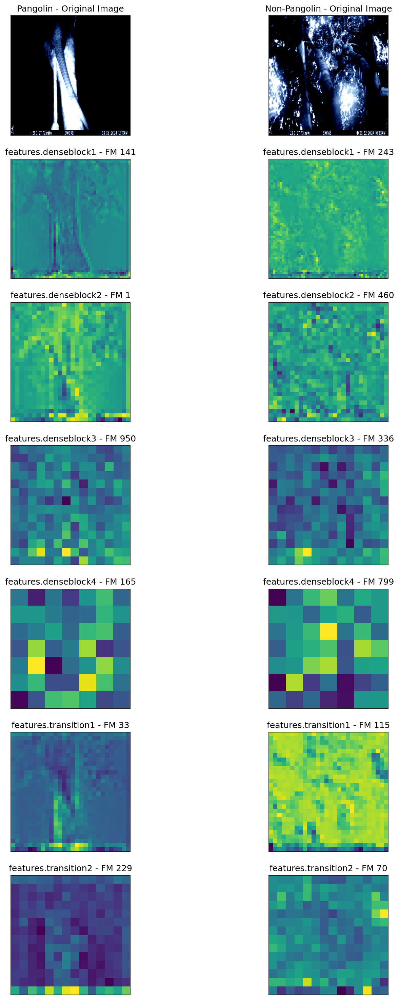

0.40760938823223114
Saving for this epoch 11
Epoch [12/15], Train Loss: 0.3926, Validation Loss: 0.3897
Training Per-Species Metrics:
Precision: 0.8109, Recall: 0.9720, F1: 0.8842
Species 1 - Accuracy: 0.8255, Precision: 0.8929, Recall: 0.5068, F1: 0.6466
Training Overall Accuracy: 0.8255, Precision: 0.8519, Recall: 0.7394, F1: 0.7654
Validation Overall Accuracy: 0.8113, Precision: 0.7877, Recall: 0.7680, F1: 0.7762
Epoch time 150.1260528564453





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3785625].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8610327..2.5877128].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3785625].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8610327..2.5877128].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3785625].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8610327..2.5877128].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2

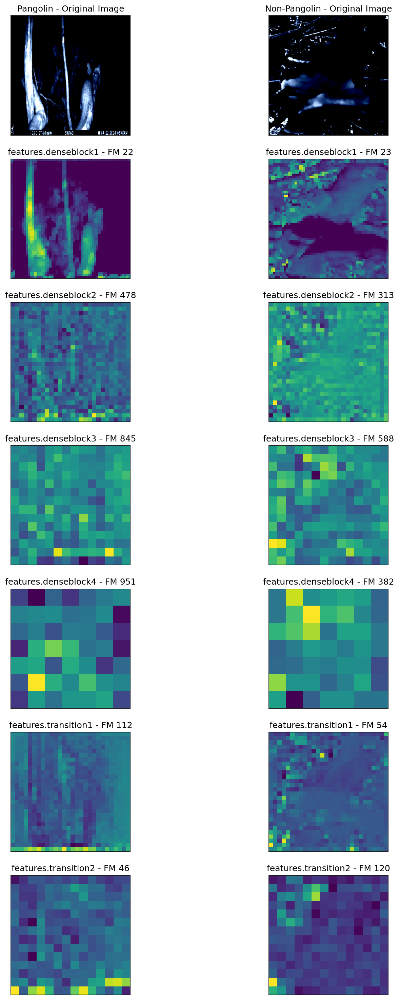

0.3897397965192795
Saving for this epoch 12
Epoch [13/15], Train Loss: 0.3940, Validation Loss: 0.3715
Training Per-Species Metrics:
Precision: 0.8343, Recall: 0.9224, F1: 0.8761
Species 1 - Accuracy: 0.8213, Precision: 0.7807, Recall: 0.6014, F1: 0.6794
Training Overall Accuracy: 0.8213, Precision: 0.8075, Recall: 0.7619, F1: 0.7777
Validation Overall Accuracy: 0.8868, Precision: 0.8653, Recall: 0.8856, F1: 0.8738
Epoch time 149.54735469818115





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.5527872..1.9951199].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.5527872..1.9951199].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.5527872..1.9951199].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping 

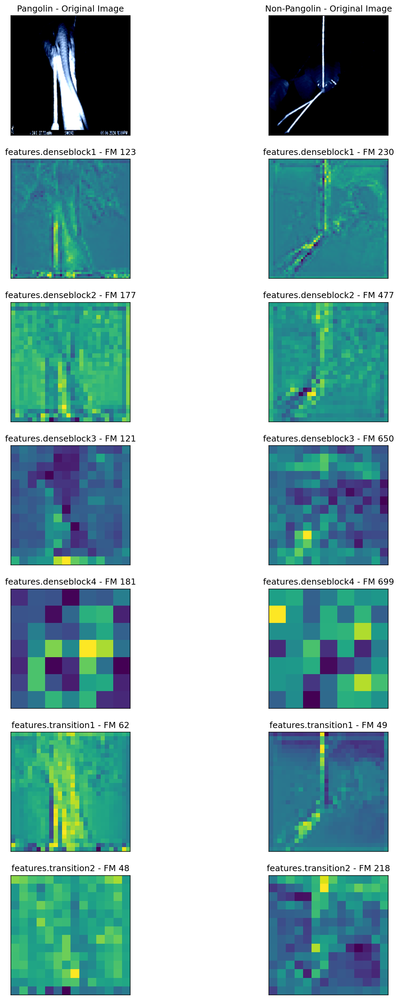

0.37149064242839813
Saving for this epoch 13
Epoch [14/15], Train Loss: 0.3662, Validation Loss: 0.3546
Training Per-Species Metrics:
Precision: 0.8580, Recall: 0.9193, F1: 0.8876
Species 1 - Accuracy: 0.8404, Precision: 0.7920, Recall: 0.6689, F1: 0.7253
Training Overall Accuracy: 0.8404, Precision: 0.8250, Recall: 0.7941, F1: 0.8064
Validation Overall Accuracy: 0.8679, Precision: 0.8447, Recall: 0.8717, F1: 0.8547
Epoch time 149.37951588630676





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

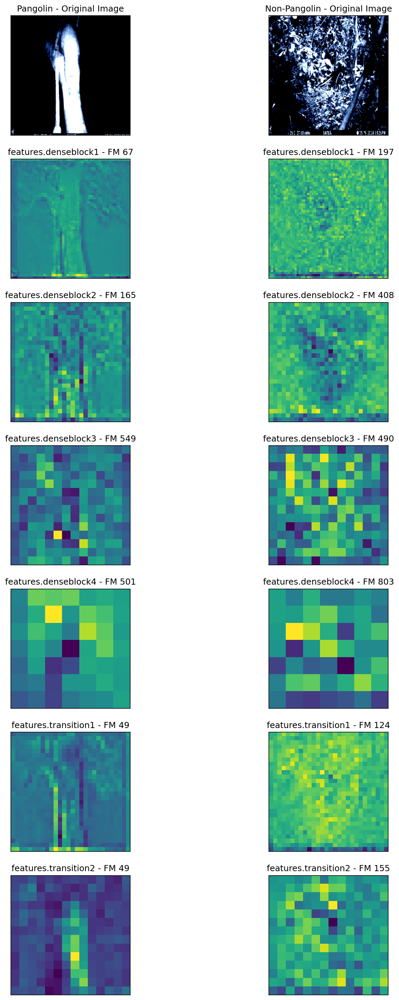

0.35455189645290375
Saving for this epoch 14
Epoch [15/15], Train Loss: 0.3449, Validation Loss: 0.3300
Training Per-Species Metrics:
Precision: 0.8794, Recall: 0.9286, F1: 0.9033
Species 1 - Accuracy: 0.8638, Precision: 0.8231, Recall: 0.7230, F1: 0.7698
Training Overall Accuracy: 0.8638, Precision: 0.8512, Recall: 0.8258, F1: 0.8366
Validation Overall Accuracy: 0.8679, Precision: 0.8447, Recall: 0.8717, F1: 0.8547
Epoch time 150.27406001091003



Test Metrics - Accuracy: 0.9000, Precision: 0.8684, Recall: 0.8049, F1: 0.8354, AUC: 0.9679
Test Per-Species Metrics:
Precision: 0.9130, Recall: 0.9438, F1: 0.9282
Species 1 - Accuracy: 0.9000, Precision: 0.8684, Recall: 0.8049, F1: 0.8354
Fold 5/5


/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3785625].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8952821..2.465708].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255

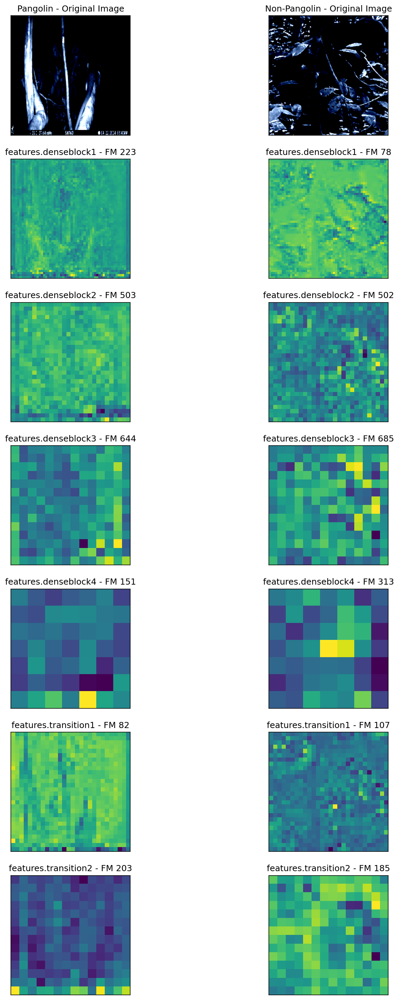

/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Saving for this epoch 0
Epoch [1/15], Train Loss: 0.6897, Validation Loss: 0.6791
Training Per-Species Metrics:
Precision: 0.7771, Recall: 0.4006, F1: 0.5287
Species 1 - Accuracy: 0.5106, Precision: 0.3651, Recall: 0.7500, F1: 0.4912
Training Overall Accuracy: 0.5106, Precision: 0.5711, Recall: 0.5753, F1: 0.5099
Validation Overall Accuracy: 0.6792, Precision: 0.3396, Recall: 0.5000, F1: 0.4045
Epoch time 149.86231970787048





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

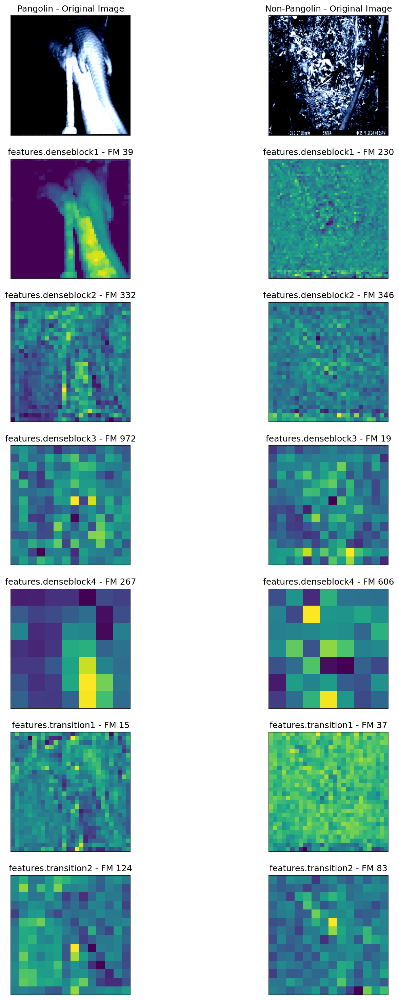

/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_div

0.6791309714317322
Saving for this epoch 1
Epoch [2/15], Train Loss: 0.6255, Validation Loss: 0.6235
Training Per-Species Metrics:
Precision: 0.6851, Recall: 1.0000, F1: 0.8131
Species 1 - Accuracy: 0.6851, Precision: 0.0000, Recall: 0.0000, F1: 0.0000
Training Overall Accuracy: 0.6851, Precision: 0.3426, Recall: 0.5000, F1: 0.4066
Validation Overall Accuracy: 0.6792, Precision: 0.3396, Recall: 0.5000, F1: 0.4045
Epoch time 150.70040011405945





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.6212862..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.6212862..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.6212862..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to t

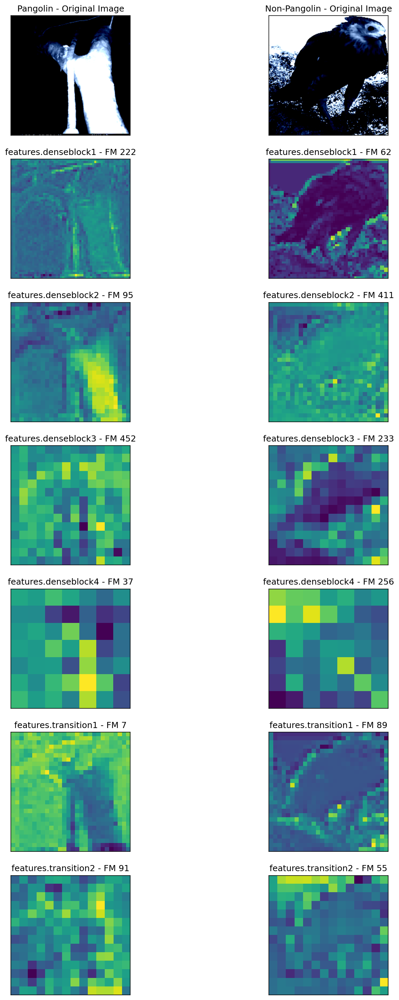

/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_div

0.6234554946422577
Saving for this epoch 2
Epoch [3/15], Train Loss: 0.5865, Validation Loss: 0.5930
Training Per-Species Metrics:
Precision: 0.6851, Recall: 1.0000, F1: 0.8131
Species 1 - Accuracy: 0.6851, Precision: 0.0000, Recall: 0.0000, F1: 0.0000
Training Overall Accuracy: 0.6851, Precision: 0.3426, Recall: 0.5000, F1: 0.4066
Validation Overall Accuracy: 0.6792, Precision: 0.3396, Recall: 0.5000, F1: 0.4045
Epoch time 149.74432516098022





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8267832..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8267832..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8267832..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to t

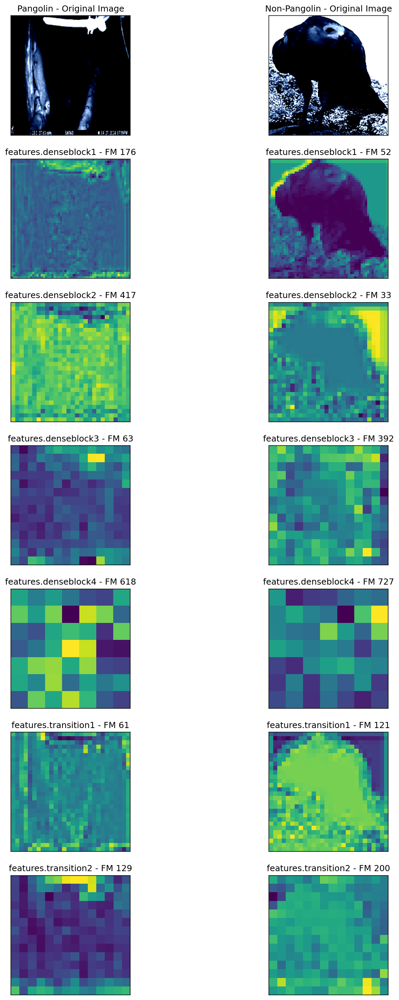

/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_div

0.5929654240608215
Saving for this epoch 3
Epoch [4/15], Train Loss: 0.5631, Validation Loss: 0.5715
Training Per-Species Metrics:
Precision: 0.6851, Recall: 1.0000, F1: 0.8131
Species 1 - Accuracy: 0.6851, Precision: 0.0000, Recall: 0.0000, F1: 0.0000
Training Overall Accuracy: 0.6851, Precision: 0.3426, Recall: 0.5000, F1: 0.4066
Validation Overall Accuracy: 0.6792, Precision: 0.3396, Recall: 0.5000, F1: 0.4045
Epoch time 150.25218510627747





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.169412].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.169412].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.169412].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.169412].
Clipping in

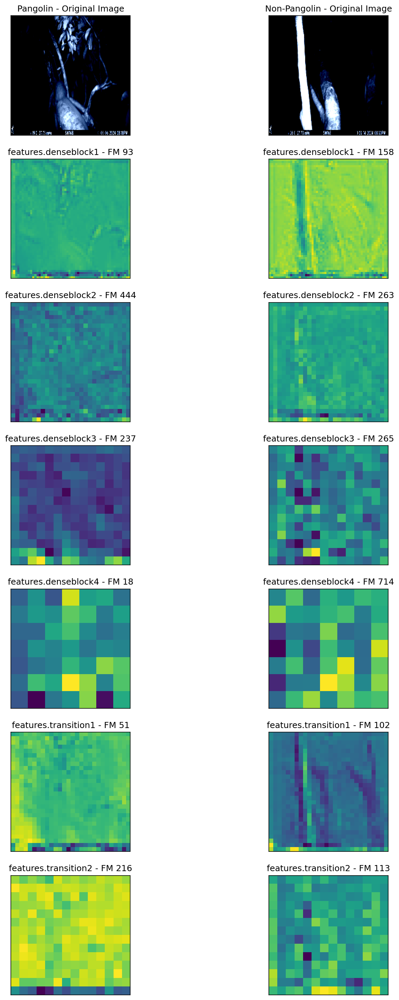

/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_div

0.5714825987815857
Saving for this epoch 4
Epoch [5/15], Train Loss: 0.5393, Validation Loss: 0.5529
Training Per-Species Metrics:
Precision: 0.6851, Recall: 1.0000, F1: 0.8131
Species 1 - Accuracy: 0.6851, Precision: 0.0000, Recall: 0.0000, F1: 0.0000
Training Overall Accuracy: 0.6851, Precision: 0.3426, Recall: 0.5000, F1: 0.4066
Validation Overall Accuracy: 0.6792, Precision: 0.3396, Recall: 0.5000, F1: 0.4045
Epoch time 150.4641239643097





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0494049..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0494049..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0494049..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to t

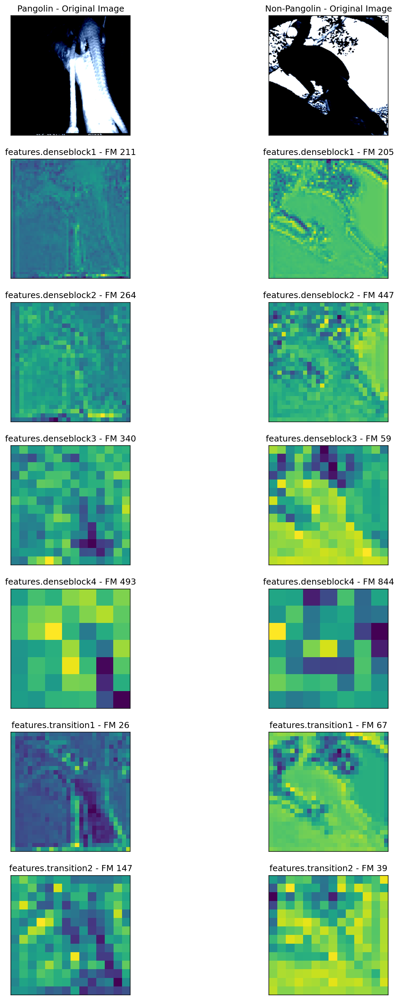

/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_div

0.5529415309429169
Saving for this epoch 5
Epoch [6/15], Train Loss: 0.5154, Validation Loss: 0.5311
Training Per-Species Metrics:
Precision: 0.6851, Recall: 1.0000, F1: 0.8131
Species 1 - Accuracy: 0.6851, Precision: 0.0000, Recall: 0.0000, F1: 0.0000
Training Overall Accuracy: 0.6851, Precision: 0.3426, Recall: 0.5000, F1: 0.4066
Validation Overall Accuracy: 0.6792, Precision: 0.3396, Recall: 0.5000, F1: 0.4045
Epoch time 149.36391186714172





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9295317..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9295317..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9295317..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to t

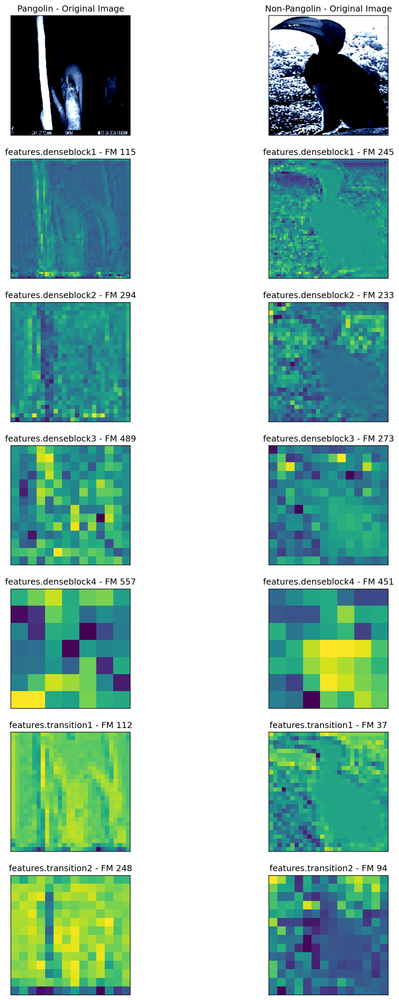

/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


0.5311107337474823
Saving for this epoch 6
Epoch [7/15], Train Loss: 0.4952, Validation Loss: 0.5149
Training Per-Species Metrics:
Precision: 0.6867, Recall: 0.9938, F1: 0.8122
Species 1 - Accuracy: 0.6851, Precision: 0.5000, Recall: 0.0135, F1: 0.0263
Training Overall Accuracy: 0.6851, Precision: 0.5933, Recall: 0.5037, F1: 0.4192
Validation Overall Accuracy: 0.6792, Precision: 0.3396, Recall: 0.5000, F1: 0.4045
Epoch time 149.13657021522522





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

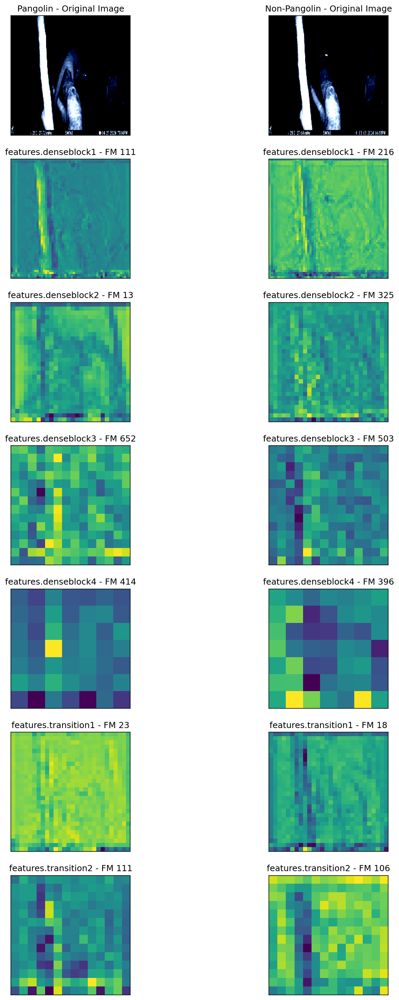

0.5148690342903137
Saving for this epoch 7
Epoch [8/15], Train Loss: 0.4809, Validation Loss: 0.4995
Training Per-Species Metrics:
Precision: 0.6985, Recall: 1.0000, F1: 0.8225
Species 1 - Accuracy: 0.7043, Precision: 1.0000, Recall: 0.0608, F1: 0.1146
Training Overall Accuracy: 0.7043, Precision: 0.8492, Recall: 0.5304, F1: 0.4686
Validation Overall Accuracy: 0.7358, Precision: 0.8600, Recall: 0.5882, F1: 0.5686
Epoch time 149.53093814849854





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8096584..2.535425].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8096584..2.535425].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8096584..2.535425].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8096584..2.535425].
Clippin

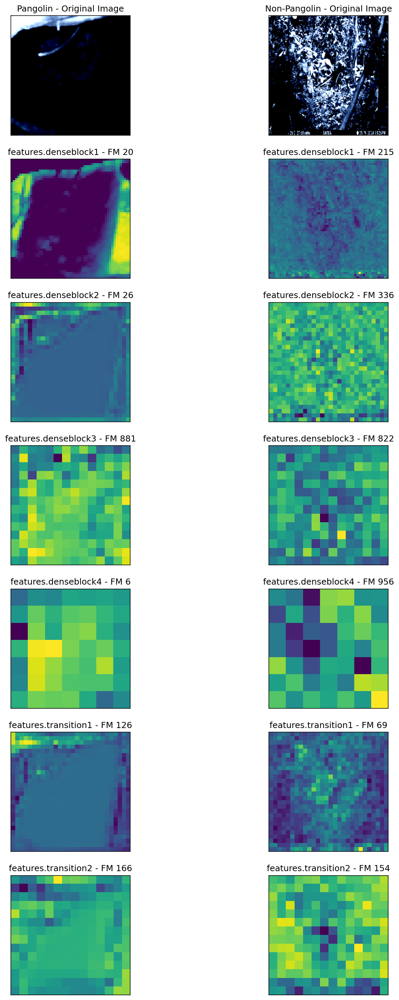

0.4995061159133911
Saving for this epoch 8
Epoch [9/15], Train Loss: 0.4589, Validation Loss: 0.4768
Training Per-Species Metrics:
Precision: 0.7191, Recall: 0.9938, F1: 0.8344
Species 1 - Accuracy: 0.7298, Precision: 0.9200, Recall: 0.1554, F1: 0.2659
Training Overall Accuracy: 0.7298, Precision: 0.8196, Recall: 0.5746, F1: 0.5502
Validation Overall Accuracy: 0.7736, Precision: 0.8090, Recall: 0.6626, F1: 0.6768
Epoch time 149.65003895759583





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0665298..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0665298..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0665298..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to t

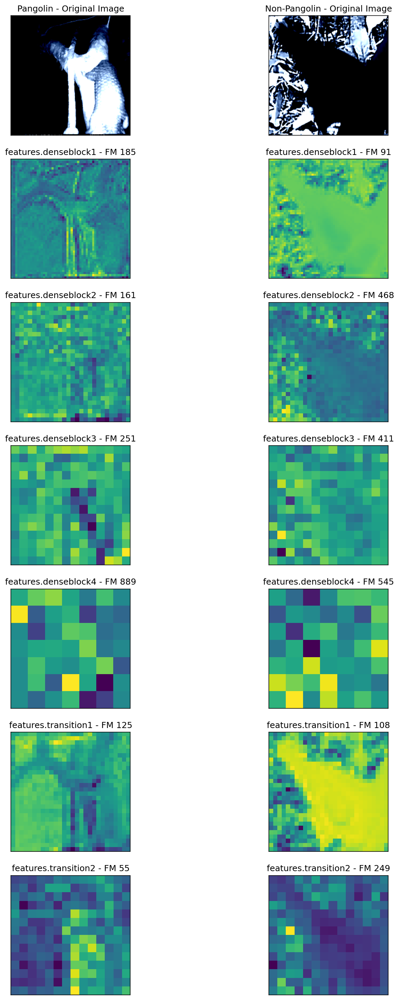

0.47683775424957275
Saving for this epoch 9
Epoch [10/15], Train Loss: 0.4338, Validation Loss: 0.4535
Training Per-Species Metrics:
Precision: 0.7646, Recall: 0.9783, F1: 0.8583
Species 1 - Accuracy: 0.7787, Precision: 0.8793, Recall: 0.3446, F1: 0.4951
Training Overall Accuracy: 0.7787, Precision: 0.8219, Recall: 0.6614, F1: 0.6767
Validation Overall Accuracy: 0.7925, Precision: 0.8264, Recall: 0.6920, F1: 0.7121
Epoch time 150.432608127594





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0494049..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0494049..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0494049..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to t

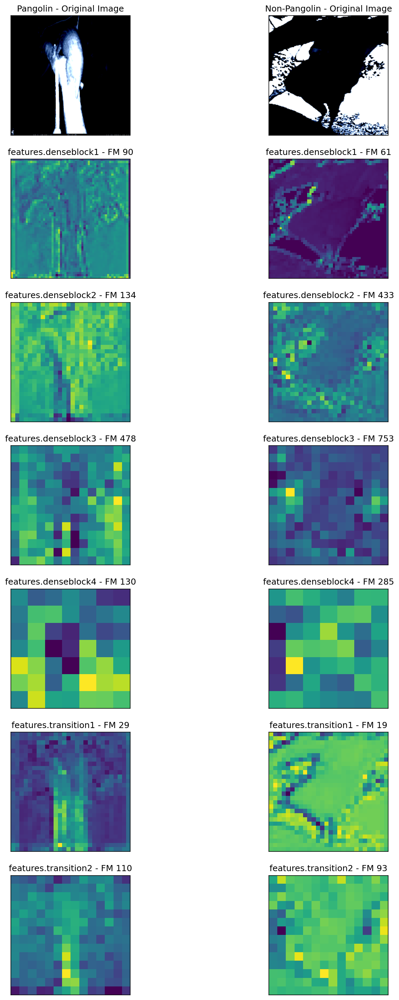

0.4534575194120407
Saving for this epoch 10
Epoch [11/15], Train Loss: 0.4273, Validation Loss: 0.4340
Training Per-Species Metrics:
Precision: 0.7865, Recall: 0.9379, F1: 0.8555
Species 1 - Accuracy: 0.7830, Precision: 0.7674, Recall: 0.4459, F1: 0.5641
Training Overall Accuracy: 0.7830, Precision: 0.7770, Recall: 0.6919, F1: 0.7098
Validation Overall Accuracy: 0.8113, Precision: 0.7971, Recall: 0.7525, F1: 0.7675
Epoch time 149.87387013435364





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7582842..1.1585187].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7582842..1.1585187].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7582842..1.1585187].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping 

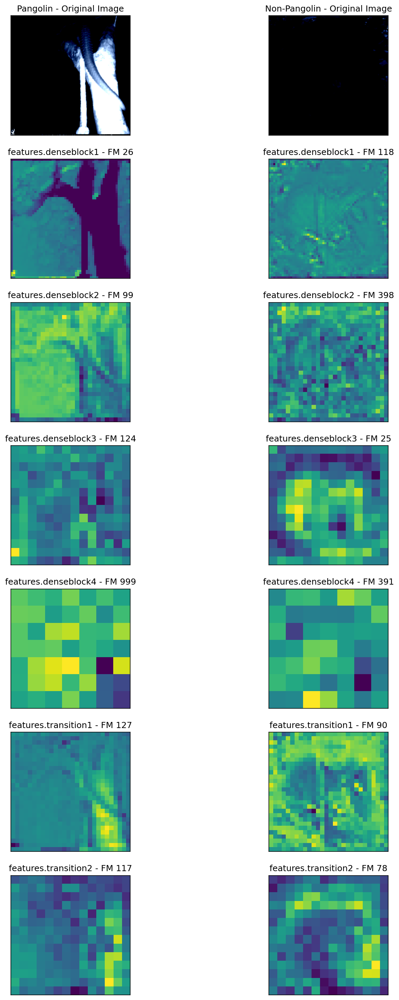

0.43399757146835327
Saving for this epoch 11
Epoch [12/15], Train Loss: 0.4033, Validation Loss: 0.4094
Training Per-Species Metrics:
Precision: 0.8032, Recall: 0.9379, F1: 0.8653
Species 1 - Accuracy: 0.8000, Precision: 0.7872, Recall: 0.5000, F1: 0.6116
Training Overall Accuracy: 0.8000, Precision: 0.7952, Recall: 0.7189, F1: 0.7384
Validation Overall Accuracy: 0.8679, Precision: 0.8852, Recall: 0.8096, F1: 0.8339
Epoch time 150.36085319519043





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.169412].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.169412].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.169412].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input 

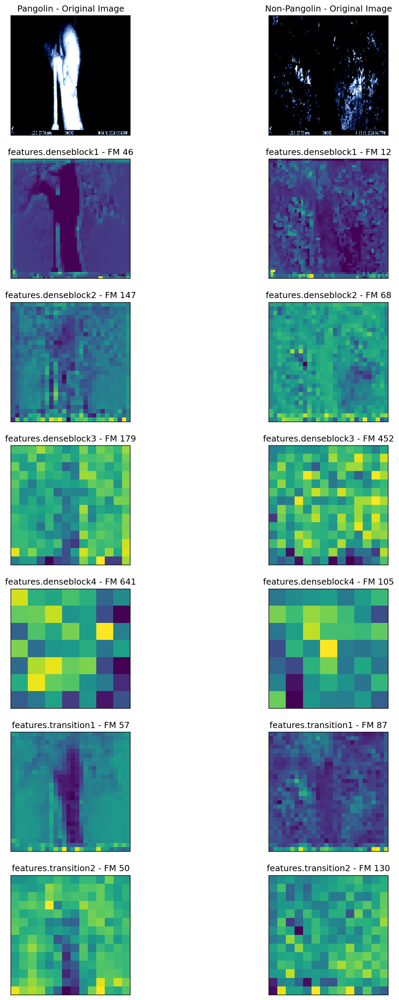

0.40942640602588654
Saving for this epoch 12
Epoch [13/15], Train Loss: 0.3865, Validation Loss: 0.3861
Training Per-Species Metrics:
Precision: 0.8204, Recall: 0.9224, F1: 0.8684
Species 1 - Accuracy: 0.8085, Precision: 0.7685, Recall: 0.5608, F1: 0.6484
Training Overall Accuracy: 0.8085, Precision: 0.7945, Recall: 0.7416, F1: 0.7584
Validation Overall Accuracy: 0.8113, Precision: 0.7877, Recall: 0.7680, F1: 0.7762
Epoch time 149.64680004119873





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0822659].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0822659].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0822659].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0822659].
Clippin

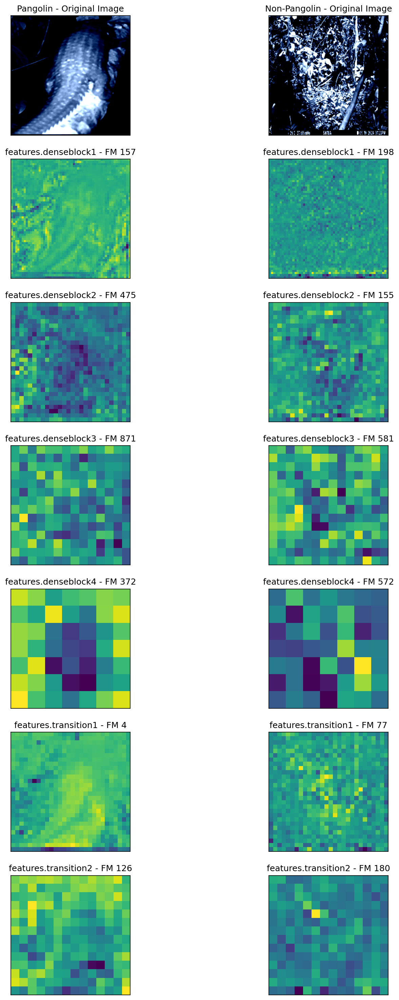

0.3860638290643692
Saving for this epoch 13
Epoch [14/15], Train Loss: 0.3673, Validation Loss: 0.3652
Training Per-Species Metrics:
Precision: 0.8735, Recall: 0.9006, F1: 0.8869
Species 1 - Accuracy: 0.8426, Precision: 0.7681, Recall: 0.7162, F1: 0.7413
Training Overall Accuracy: 0.8426, Precision: 0.8208, Recall: 0.8084, F1: 0.8141
Validation Overall Accuracy: 0.8679, Precision: 0.8522, Recall: 0.8407, F1: 0.8460
Epoch time 150.4621880054474





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.6212862..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.6212862..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.6212862..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to t

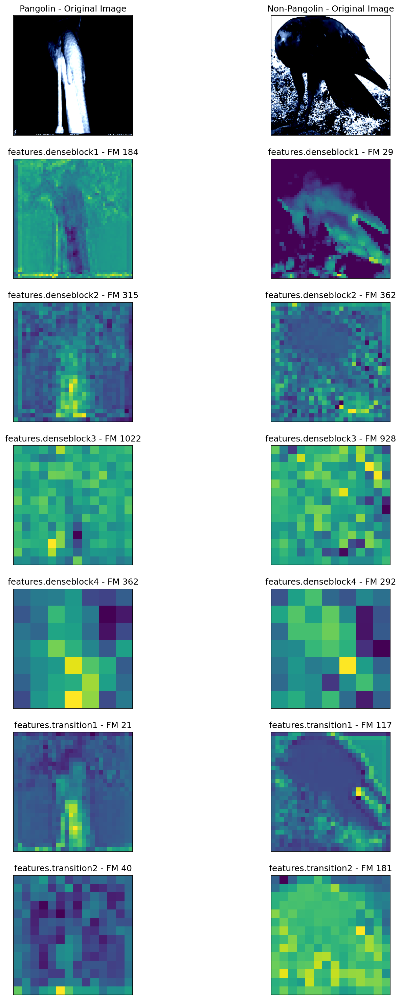

0.36516645550727844
Saving for this epoch 14
Epoch [15/15], Train Loss: 0.3460, Validation Loss: 0.3471
Training Per-Species Metrics:
Precision: 0.8791, Recall: 0.9255, F1: 0.9017
Species 1 - Accuracy: 0.8617, Precision: 0.8168, Recall: 0.7230, F1: 0.7670
Training Overall Accuracy: 0.8617, Precision: 0.8479, Recall: 0.8242, F1: 0.8343
Validation Overall Accuracy: 0.8679, Precision: 0.8522, Recall: 0.8407, F1: 0.8460
Epoch time 150.59722995758057



Test Metrics - Accuracy: 0.8923, Precision: 0.9355, Recall: 0.7073, F1: 0.8056, AUC: 0.9641
Test Per-Species Metrics:
Precision: 0.8788, Recall: 0.9775, F1: 0.9255
Species 1 - Accuracy: 0.8923, Precision: 0.9355, Recall: 0.7073, F1: 0.8056


In [3]:
from torch.utils.data import DataLoader 
from PIL import Image
import sklearn
from sklearn.model_selection import StratifiedKFold, StratifiedShuffleSplit
from iterstrat.ml_stratifiers import MultilabelStratifiedKFold
import torch
import torch.optim as optim
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix
import matplotlib.pyplot as plt
import numpy as np
import torch.optim as optim
from torch import nn  # import neural network from PyTorch
import torchvision.models as models  # import models submodule (includes pre-trained models used for computer vision)
from torchmetrics.classification import MulticlassAccuracy
from sklearn.metrics import roc_auc_score
from sklearn.model_selection import train_test_split
import math
from torchmetrics.classification import BinaryAccuracy




import time  # Import the time module for tracking training time

# Store feature maps for each layer
feature_maps = {}

# Define the hook function to save feature maps
def hook_fn(module, input, output, layer_name):
    feature_maps[layer_name] = output.detach()


# Define a function that trains and evaluates the model for a specified number of epochs
def train_and_evaluate(model, train_loader, val_loader, criterion, optimizer, num_epochs):
    train_losses, val_losses = [], []
    train_metrics, val_metrics = [], []  # To store metrics like accuracy, precision, etc. for each epoch
    per_species_train_metrics = {  # Store per-species metrics for training
        'accuracy': [],
        'precision': [],
        'recall': [],
        'f1': [],
        'auc': []
    }
    per_species_val_metrics = {  # Store per-species metrics for validation
        'accuracy': [],
        'precision': [],
        'recall': [],
        'f1': [],
        'auc': []
    }
    train_times = []  # List to store the time for each epoch

    model_save_path = []  # To store the best model based on validation loss
    # Specify the layers you want to visualize
    layers_to_visualize = ['features.denseblock1', 'features.denseblock2', 'features.denseblock3', 'features.denseblock4', 'features.transition1', 'features.transition2']

    # Register hooks for each layer
    hooks = []
    for layer_name in layers_to_visualize:
        layer = dict([*model.named_modules()])[layer_name]  # Get the layer by name
        hook = layer.register_forward_hook(lambda module, input, output, name=layer_name: hook_fn(module, input, output, name))
        hooks.append(hook)


    for epoch in range(num_epochs):
        start_time = time.time()  # Start the timer at the beginning of the epoch

        model.train()  # Set the model to train mode
        train_loss, train_preds, train_labels = 0, [], []
        train_probs = []
        train_outputs = []
        train_auc = 0

        # Training loop:
        for batch in train_loader:
            images = batch['image']
            labels = batch['label'] # CHANGED
            labels = labels.unsqueeze(1).float()
            #labels = torch.argmax(labels, dim=1)  # Convert to 1D tensor of class indices
            #print(f"Unique labels in train batch: {torch.unique(labels)}")

            optimizer.zero_grad()
            outputs = model(images)  # Obtains predictions
            loss = criterion(outputs, labels)  # Computes the loss
            loss.backward()  # Backprop to compute the gradients
            optimizer.step()  # Updates the model weights based on gradients

            # Save train loss
            train_loss += loss.item()  # Accumulates the loss for the batch
            preds = (outputs > 0.5).int()  # binary predictions: 0 or 1
            train_preds.extend(preds.cpu().numpy())
            #train_preds.extend(torch.argmax(outputs, dim=1).cpu().numpy())  CHANGED
            train_labels.extend(labels.cpu().numpy())  # Stores the true labels for the batch

            # Add AUC calculation for training
            #train_outputs.extend(outputs.cpu().detach().numpy())  # Get probabilities for each class
            #train_auc = roc_auc_score(train_labels, train_outputs.cpu().detach().numpy(), average='macro', multi_class='ovr')
            #train_probs.extend(torch.softmax(outputs, dim=1).cpu().detach().numpy()) CHANGED
            train_probs.extend(outputs.cpu().detach().numpy())
        
        # Visualization after each epoch
        # Find indices of one pangolin and one non-pangolin
        pangolin_idx = (labels == 1).nonzero(as_tuple=True)[0][0].item()  # First pangolin
        non_pangolin_idx = (labels == 0).nonzero(as_tuple=True)[0][0].item()  # First non-pangolin
        fig, axes = plt.subplots(len(layers_to_visualize) + 1, 2, figsize=(12, 25), dpi=150)  # Increased DPI for better resolution

        for i, layer_name in enumerate(layers_to_visualize):
            # Display Pangolin original image
            axes[0][0].imshow(images[pangolin_idx].cpu().numpy().transpose(1, 2, 0))
            axes[0][0].set_xticks([]); axes[0][0].set_yticks([])
            axes[0][0].set_title("Pangolin - Original Image")

            # Display Non-Pangolin original image
            axes[0][1].imshow(images[non_pangolin_idx].cpu().numpy().transpose(1, 2, 0))
            axes[0][1].set_xticks([]); axes[0][1].set_yticks([])
            axes[0][1].set_title("Non-Pangolin - Original Image")

            # Display feature maps for Pangolin image
            fmap_pangolin = feature_maps[layer_name][pangolin_idx]  # Feature map for Pangolin image
            fmap_pangolin = (fmap_pangolin - fmap_pangolin.min()) / (fmap_pangolin.max() - fmap_pangolin.min())  # Normalize
            num_channels = fmap_pangolin.shape[0]
            
            random_channel_pangolin = np.random.randint(0, num_channels)  # Pick a random channel for pangolin
            feature_map_pangolin = fmap_pangolin[random_channel_pangolin].cpu().numpy()

            axes[i + 1][0].imshow(feature_map_pangolin, cmap='viridis')
            axes[i + 1][0].set_xticks([]); axes[i + 1][0].set_yticks([])
            axes[i + 1][0].set_title(f"{layer_name} - FM {random_channel_pangolin}")

            # Display feature maps for Non-Pangolin image
            fmap_non_pangolin = feature_maps[layer_name][non_pangolin_idx]  # Feature map for Non-Pangolin image
            fmap_non_pangolin = (fmap_non_pangolin - fmap_non_pangolin.min()) / (fmap_non_pangolin.max() - fmap_non_pangolin.min())  # Normalize
            random_channel_non_pangolin = np.random.randint(0, num_channels)  # Pick a random channel for non-pangolin
            feature_map_non_pangolin = fmap_non_pangolin[random_channel_non_pangolin].cpu().numpy()

            axes[i + 1][1].imshow(feature_map_non_pangolin, cmap='viridis')
            axes[i + 1][1].set_xticks([]); axes[i + 1][1].set_yticks([])
            axes[i + 1][1].set_title(f"{layer_name} - FM {random_channel_non_pangolin}")




        plt.show()


        train_outputs = np.array(train_probs)
        train_labels = np.array(train_labels)
        
        #train_auc = roc_auc_score(train_labels, train_outputs[:, 1], average='macro', multi_class='ovr')
        train_auc = roc_auc_score(train_labels, train_probs)


        train_loss /= len(train_loader)  # Computes the average training loss for the epoch
        train_losses.append(train_loss)  # Stores the average training loss for this epoch

        # Calculate per-species metrics for training
        train_labels_tensor = torch.tensor(train_labels)
        train_preds_tensor = torch.tensor(train_preds)

        accuracy_metric = BinaryAccuracy()
        accuracy_metric.update(train_preds_tensor, train_labels_tensor)
        binary_accuracy = accuracy_metric.compute().item()
        species_train_accuracy = [1 - binary_accuracy, binary_accuracy]

        species_train_precision = precision_score(train_labels, train_preds, average=None)  # Per-class precision
        species_train_recall = recall_score(train_labels, train_preds, average=None)  # Per-class recall
        species_train_f1 = f1_score(train_labels, train_preds, average=None)  # Per-class F1 score
        
        # Calculate per-species AUC for training
        species_train_auc = []
        for i in range(len(species_train_accuracy)):  # Loop through each class
            # Calculate the AUC for each class
            auc = roc_auc_score(train_labels, train_probs)
            species_train_auc.append(auc)

        per_species_train_metrics['accuracy'].append(species_train_accuracy)
        per_species_train_metrics['precision'].append(species_train_precision)
        per_species_train_metrics['recall'].append(species_train_recall)
        per_species_train_metrics['f1'].append(species_train_f1)
        per_species_train_metrics['auc'].append(species_train_auc)  # Append AUC values for training

        # Calculate overall metrics for training
        train_accuracy = accuracy_score(train_labels, train_preds)  # Overall accuracy
        train_precision = precision_score(train_labels, train_preds, average='macro')  # Overall precision (macro-average)
        train_recall = recall_score(train_labels, train_preds, average='macro')  # Overall recall (macro-average)
        train_f1 = f1_score(train_labels, train_preds, average='macro')  # Overall F1 score (macro-average)

        train_metrics.append({
            'accuracy': train_accuracy,
            'precision': train_precision,
            'recall': train_recall,
            'f1': train_f1,
            'auc': train_auc
        })

        # Validation Loop:
        model.eval()  # Set the model to evaluation mode
        val_loss, val_preds, val_labels = 0, [], []
        val_probs = []
        val_auc = 0
        with torch.no_grad():
            for batch in val_loader:
                images = batch['image']
                labels = batch['label'].unsqueeze(1).float()

                outputs = model(images)
                loss = criterion(outputs, labels)
                val_loss += loss.item()

                # Binary prediction: 1 if output > 0.5, else 0
                preds = (outputs > 0.5).int()
                val_preds.extend(preds.cpu().numpy())
                val_labels.extend(labels.cpu().numpy())

                # For AUC, store sigmoid probabilities
                val_probs.extend(outputs.cpu().detach().numpy())

        val_loss /= len(val_loader)  # Computes the average validation loss for this epoch
        

        # Calculate per-species metrics for validation
        species_val_precision = precision_score(val_labels, val_preds, average=None)  # Per-class precision
        species_val_recall = recall_score(val_labels, val_preds, average=None)  # Per-class recall
        species_val_f1 = f1_score(val_labels, val_preds, average=None)  # Per-class F1 score

        
        val_labels_tensor = torch.tensor(val_labels)  # Make sure to convert them to torch tensors
        val_preds_tensor = torch.tensor(val_preds)

        accuracy_metric = MulticlassAccuracy(num_classes=2, average=None)
        accuracy_metric.update(val_preds_tensor, val_labels_tensor)
        species_val_accuracy = accuracy_metric.compute().tolist()

        val_auc = roc_auc_score(np.array(val_labels).flatten(), np.array(val_probs).flatten())


        # Calculate per-species AUC for validation
        species_val_auc = []
        #for i in range(len(species_val_accuracy)):  # Loop through each class
            # Calculate the AUC for each class
            #auc = roc_auc_score([1 if label == i else 0 for label in val_labels], [prob[i] for prob in val_probs])
            #species_val_auc.append(auc)

        per_species_val_metrics['accuracy'].append(species_val_accuracy)
        per_species_val_metrics['precision'].append(species_val_precision)
        per_species_val_metrics['recall'].append(species_val_recall)
        per_species_val_metrics['f1'].append(species_val_f1)
        per_species_val_metrics['auc'].append(species_val_auc)



        # Calculate overall metrics for validation
        val_accuracy = accuracy_score(val_labels, val_preds)  # Overall accuracy
        val_precision = precision_score(val_labels, val_preds, average='macro')  # Overall precision (macro-average)
        val_recall = recall_score(val_labels, val_preds, average='macro')  # Overall recall (macro-average)
        val_f1 = f1_score(val_labels, val_preds, average='macro')  # Overall F1 score (macro-average)

        val_metrics.append({
            'accuracy': val_accuracy,
            'precision': val_precision,
            'recall': val_recall,
            'f1': val_f1,
            'auc': val_auc
        })

        # Save the model with the lowest validation loss
        
        if epoch == 0 or val_loss < min(val_losses):
            if epoch != 0: 
                print(min(val_losses))
            print("Saving for this epoch", epoch)
            model_save_path = model.state_dict()
        val_losses.append(val_loss)  # Stores the average validation loss for this epoch


        # Print per-species metrics and overall metrics
        print(f"Epoch [{epoch+1}/{num_epochs}], Train Loss: {train_loss:.4f}, Validation Loss: {val_loss:.4f}")
        
        # Print per-species metrics for training
       # Print per-species metrics for training
        print("Training Per-Species Metrics:")
    
        for idx in range(len(species_train_accuracy)):
            #print(f"Species {idx} - Accuracy: {species_train_accuracy[idx]:.4f}, Precision: {species_train_precision[idx]:.4f}, Recall: {species_train_recall[idx]:.4f}, F1: {species_train_f1[idx]:.4f}")
            # Check if idx is within the bounds of other metrics
            if idx == 1:
                print(f"Species {idx} - Accuracy: {species_train_accuracy[idx]:.4f}, Precision: {species_train_precision[idx]:.4f}, Recall: {species_train_recall[idx]:.4f}, F1: {species_train_f1[idx]:.4f}")
            else:
                print(f"Precision: {species_train_precision[idx]:.4f}, Recall: {species_train_recall[idx]:.4f}, F1: {species_train_f1[idx]:.4f}")
            #if idx < len(species_train_precision) and idx < len(species_train_recall) and idx < len(species_train_f1):
                #print(f"Species {idx} - Accuracy: {species_train_accuracy[idx]:.4f}, Precision: {species_train_precision[idx]:.4f}, Recall: {species_train_recall[idx]:.4f}, F1: {species_train_f1[idx]:.4f}")
            #else:
                #print(f"Species {idx} - Accuracy: {species_train_accuracy[idx]:.4f}, Precision: N/A, Recall: N/A, F1: N/A")
                

        # Print overall metrics for training
        print(f"Training Overall Accuracy: {train_accuracy:.4f}, Precision: {train_precision:.4f}, Recall: {train_recall:.4f}, F1: {train_f1:.4f}")

       # Print per-species metrics for validation
        #print("Validation Per-Species Metrics:")
        #for idx in range(len(species_val_accuracy)):
            # Check if idx is within the bounds of other metrics
            #if idx < len(species_val_precision) and idx < len(species_val_recall) and idx < len(species_val_f1):
                #print(f"Species {idx} - Accuracy: {species_val_accuracy[idx]:.4f}, Precision: {species_val_precision[idx]:.4f}, Recall: {species_val_recall[idx]:.4f}, F1: {species_val_f1[idx]:.4f}")
            #else:
                #print(f"Species {idx} - Accuracy: {species_val_accuracy[idx]:.4f}, Precision: N/A, Recall: N/A, F1: N/A")
                
        # Print overall metrics for validation
        print(f"Validation Overall Accuracy: {val_accuracy:.4f}, Precision: {val_precision:.4f}, Recall: {val_recall:.4f}, F1: {val_f1:.4f}")

        # Calculate training time for this epoch
        end_time = time.time()
        epoch_time = end_time - start_time
        print("Epoch time", epoch_time)
        train_times.append(epoch_time)
        print("\n\n")

    return model_save_path, train_losses, val_losses, val_metrics, train_metrics, per_species_train_metrics, per_species_val_metrics, train_times

###### KFOLD CROSS VALIDATION ########
strat_kf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)  # Shuffle data with random_seed = 42 for reproducibility
all_train_metrics = {
    'accuracy': [],
    'precision': [],
    'recall': [],
    'f1': [],
    'auc': []
}
all_val_metrics = {
    'accuracy': [],
    'precision': [],
    'recall': [],
    'f1': []
}

all_test_metrics = {
    'accuracy': [],
    'precision': [],
    'recall': [],
    'f1': [],
    'auc': []
}

all_per_species_train_metrics = {
    'accuracy': [],
    'precision': [],
    'recall': [],
    'f1': [],
    'auc': []
}
all_per_species_val_metrics = {
    'accuracy': [],
    'precision': [],
    'recall': [],
    'f1': [],
    'auc': []
}

all_per_species_test_metrics = {
    'accuracy': [],
    'precision': [],
    'recall': [],
    'f1': [], 
    'auc': []
}
all_train_times = []
all_train_losses = []
all_validation_loss = []


#y_train = y_train.argmax(axis=1)
#for fold, (train_index, test_index) in enumerate(kf.split(combined_df)):
for fold, (train_index, test_index) in enumerate(strat_kf.split(combined_df, y_train)):  # Stratified split
    print(f"Fold {fold+1}/{5}")

    # Split data
    train_data = x_train.iloc[train_index]  # File paths for training set
    test_data = x_train.iloc[test_index]  # File paths for testing set
    train_labels = y_train[train_index]  # Labels for training set
    test_labels = y_train[test_index]  # Labels for testing set
    
    # Further split the training data into training and validation (90/10 split)
        #train_data, val_data = train_data[:int(0.9 * len(train_data))], train_data[int(0.9 * len(train_data)):]
        #train_labels, val_labels = train_labels[:int(0.9 * len(train_labels))], train_labels[int(0.9 * len(train_labels)):]
   # Perform stratified split while maintaining original proportions
    train_data, val_data, train_labels, val_labels = train_test_split(
        train_data, train_labels,  # Original training data and labels
        test_size=0.1,  # 10% of train_data becomes val_data
        stratify=train_labels,  # Ensures class proportions are preserved
        random_state=42  # For reproducibility
    )


    # Filter out .DS_Store files from train, validation, and test data
    train_data = train_data[~train_data['filepath'].str.endswith('.DS_Store')]
    val_data = val_data[~val_data['filepath'].str.endswith('.DS_Store')]
    test_data = test_data[~test_data['filepath'].str.endswith('.DS_Store')]



    # Create Dataloader for this fold
    train_dataset = ImagesDataset(train_data, train_labels)  # Ensure transform is defined
    val_dataset = ImagesDataset(val_data, val_labels)
    test_dataset = ImagesDataset(test_data, test_labels)

    train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)
    val_loader = DataLoader(val_dataset, batch_size=32, shuffle=False)
    test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False)

    
    

    model = models.densenet121(pretrained=False)  
    model.classifier = nn.Sequential(  # Replace the classifier layer
        nn.Linear(1024, 100),  # Dense layer takes a 1024-dim input and outputs 100-dim
        nn.ReLU(inplace=True),  # ReLU activation
        nn.Dropout(0.1),  # Dropout for regularization
        nn.Linear(100, 1),  # Final layer for 1 class
        nn.Sigmoid()
    )

    criterion = nn.BCELoss() # for binary classification
    optimizer = optim.SGD(model.parameters(), lr=0.001, momentum=0.9)
    # model.parameters() - weights and biases that optimizer updates during training

    best_model, train_losses, val_losses, val_metrics, train_metrics, per_species_train_metrics, per_species_val_metrics, train_times = train_and_evaluate(
        model, train_loader, val_loader, criterion, optimizer, num_epochs=15
    )

    torch.save(best_model, f"best_model_fold_{fold+1}.pth")


    all_val_metrics['accuracy'].append(val_metrics[-1]['accuracy'])
    all_val_metrics['precision'].append(val_metrics[-1]['precision'])
    all_val_metrics['recall'].append(val_metrics[-1]['recall'])
    all_val_metrics['f1'].append(val_metrics[-1]['f1'])

    all_train_metrics['accuracy'].append(train_metrics[-1]['accuracy'])
    all_train_metrics['precision'].append(train_metrics[-1]['precision'])
    all_train_metrics['recall'].append(train_metrics[-1]['recall'])
    all_train_metrics['f1'].append(train_metrics[-1]['f1'])
    all_train_metrics['auc'].append(train_metrics[-1]['auc'])

    # Store per-species metrics and training time for this fold
    all_per_species_train_metrics['accuracy'].append(per_species_train_metrics['accuracy'])
    all_per_species_train_metrics['precision'].append(per_species_train_metrics['precision'])
    all_per_species_train_metrics['recall'].append(per_species_train_metrics['recall'])
    all_per_species_train_metrics['f1'].append(per_species_train_metrics['f1'])
    all_per_species_train_metrics['auc'].append(per_species_train_metrics['auc'])

    all_per_species_val_metrics['accuracy'].append(per_species_val_metrics['accuracy'])
    all_per_species_val_metrics['precision'].append(per_species_val_metrics['precision'])
    all_per_species_val_metrics['recall'].append(per_species_val_metrics['recall'])
    all_per_species_val_metrics['f1'].append(per_species_val_metrics['f1'])

    all_train_times.append(train_times)
    all_train_losses.append(train_losses)
    all_validation_loss.append(val_losses)

    # Evaluate on the test set
    model.load_state_dict(best_model)  # Load the best model saved during training
    model.eval()  # Set the model to evaluation mode

    # Initialize variables to calculate metrics
    test_preds, test_labels = [], []
    test_probs = []
    test_auc = 0
    test_outputs = []

    per_species_test_metrics = {
        'accuracy': [],
        'precision': [],
        'recall': [],
        'f1': [],
        'auc': []
    }

    # Iterate over the test set to get predictions
    with torch.no_grad():
        for batch in test_loader:
            images, labels = batch['image'], batch['label']
            labels = labels.unsqueeze(1).float()
            outputs = model(images)
            
            # For binary classification, get the probabilities for class 1
            probs = torch.sigmoid(outputs).squeeze()  # Squeeze to remove extra dimensions
            preds = (outputs > 0.5).int()
            test_preds.extend(preds.cpu().numpy())  # Predicted label: 1 if prob > 0.5, else 0
            test_labels.extend(labels.cpu().numpy())  # Get true labels

            #test_outputs.extend(probs.cpu().detach().numpy())  # Get probabilities for the positive class
            test_probs.extend(outputs.cpu().detach().numpy())  # Store probabilities for AUC calculation


    #test_outputs = np.array(test_probs)
    test_labels = np.array(test_labels)

    # Calculate AUC using probabilities for the positive class
    test_auc = roc_auc_score(test_labels, test_probs)

    # Compute overall test metrics
    test_accuracy = accuracy_score(test_labels, test_preds)
    test_precision = precision_score(test_labels, test_preds)
    test_recall = recall_score(test_labels, test_preds)
    test_f1 = f1_score(test_labels, test_preds)

    # Print overall test metrics
    print(f"Test Metrics - Accuracy: {test_accuracy:.4f}, Precision: {test_precision:.4f}, Recall: {test_recall:.4f}, F1: {test_f1:.4f}, AUC: {test_auc:.4f}")


    species_test_precision = precision_score(test_labels, test_preds, average=None)  # Per-class precision
    species_test_recall = recall_score(test_labels, test_preds, average=None)  # Per-class recall
    species_test_f1 = f1_score(test_labels, test_preds, average=None)  # Per-class F1 score

    # Store per-species test metrics (though only class 1 is meaningful here)
    per_species_test_metrics['accuracy'].append([1-test_accuracy, test_accuracy])  # Accuracy for the entire test set
    per_species_test_metrics['precision'].append(species_test_precision)
    per_species_test_metrics['recall'].append(species_test_recall)
    per_species_test_metrics['f1'].append(species_test_f1)

    # Calculate AUC for class 1 (positive class)
    species_test_auc = roc_auc_score(test_labels, test_probs)

    per_species_test_metrics['auc'].append(species_test_auc)

    # Print per-species test metrics
    print("Test Per-Species Metrics:")
    for idx in range(2):
            if idx == 1:
                print(f"Species {idx} - Accuracy: {test_accuracy:.4f}, "
                    f"Precision: {species_test_precision[idx]:.4f}, "
                    f"Recall: {species_test_recall[idx]:.4f}, "
                    f"F1: {species_test_f1[idx]:.4f}")
            else:
                print(f"Precision: {species_test_precision[idx]:.4f}, "
                    f"Recall: {species_test_recall[idx]:.4f}, "
                    f"F1: {species_test_f1[idx]:.4f}")
   
    # Save test metrics for each fold
    all_test_metrics['accuracy'].append(test_accuracy)
    all_test_metrics['precision'].append(test_precision)
    all_test_metrics['recall'].append(test_recall)
    all_test_metrics['f1'].append(test_f1)
    all_test_metrics['auc'].append(test_auc)

    all_per_species_test_metrics['accuracy'].append(per_species_test_metrics['accuracy'][-1])
    all_per_species_test_metrics['precision'].append(per_species_test_metrics['precision'][-1])
    all_per_species_test_metrics['recall'].append(per_species_test_metrics['recall'][-1])   
    all_per_species_test_metrics['f1'].append(per_species_test_metrics['f1'][-1])
    all_per_species_test_metrics['auc'].append(per_species_test_metrics['auc'][-1])



## Graph Different Metrics 

### Confusion Matrices for Each Test Run (1 per fold)

Processing Confusion Matrix for Fold 1


/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)


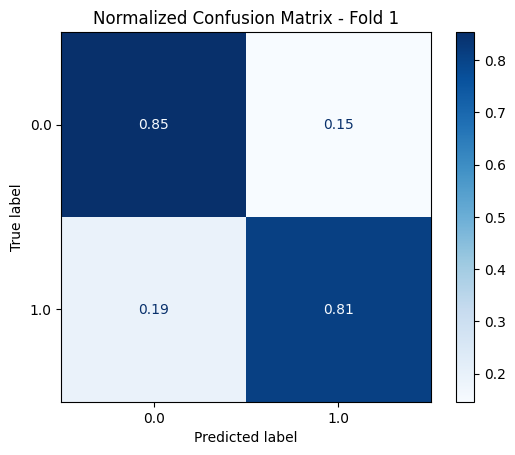

Processing Confusion Matrix for Fold 2


/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)


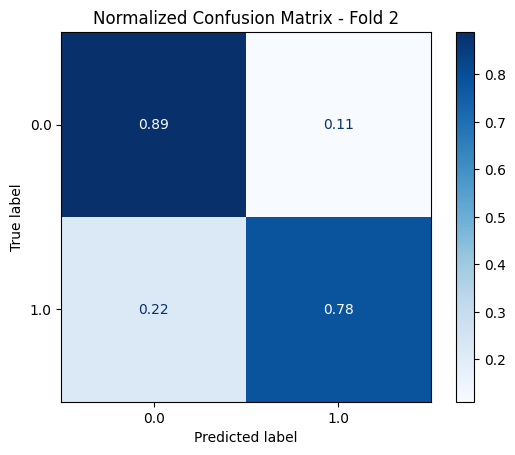

Processing Confusion Matrix for Fold 3


/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)


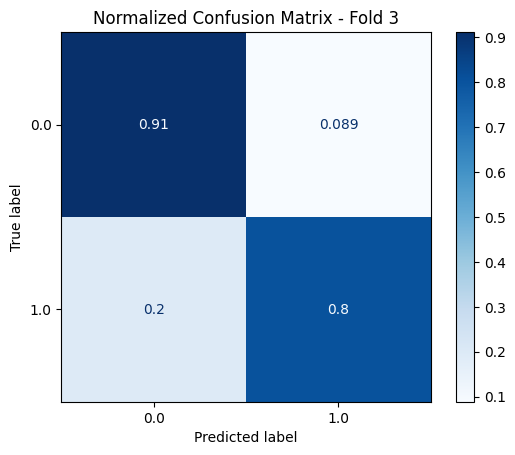

Processing Confusion Matrix for Fold 4


/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)


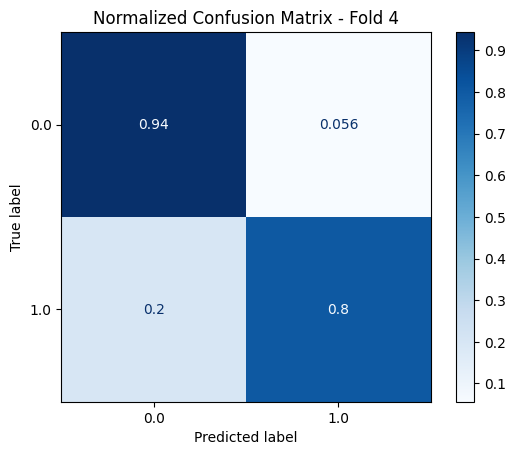

Processing Confusion Matrix for Fold 5


/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)


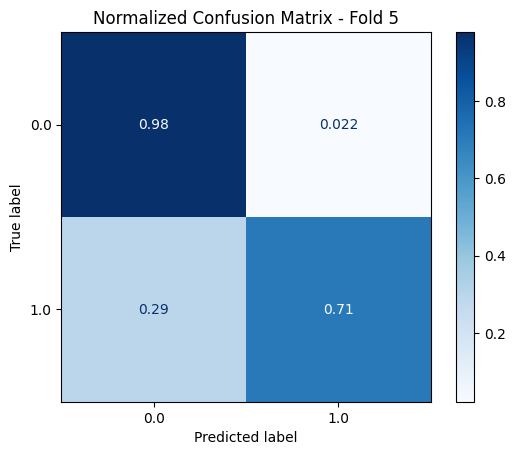

In [4]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics import ConfusionMatrixDisplay

strat_kf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)  # Shuffle data with random_seed = 42 for reproducibility

for fold, (train_index, test_index) in enumerate(strat_kf.split(combined_df, y_train)):
    print(f"Processing Confusion Matrix for Fold {fold + 1}")

    # Retrieve the SAME test set as before
    test_data = x_train.iloc[test_index]  # File paths for testing set
    test_labels = y_train[test_index]  # Labels for testing set

    # Filter out .DS_Store files (same as before)
    test_data = test_data[~test_data['filepath'].str.endswith('.DS_Store')]

    # Create dataset and dataloader (must match original format)
    test_dataset = ImagesDataset(test_data, test_labels)
    test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False)

    # Load the trained model for this fold
    model = models.densenet121(pretrained=False)  
    model.classifier = nn.Sequential(  # Replace the classifier layer
        nn.Linear(1024, 100),  # Dense layer takes a 1024-dim input and outputs 100-dim
        nn.ReLU(inplace=True),  # ReLU activation
        nn.Dropout(0.1),  # Dropout for regularization
        nn.Linear(100, 1),  # Final layer for 1 class
        nn.Sigmoid()
    )
    model.load_state_dict(torch.load(f"best_model_fold_{fold+1}.pth"))
    model.eval()  

    # Get predictions on the test set
    test_preds, test_labels = [], []
    with torch.no_grad():
        for batch in test_loader:
            images, labels = batch['image'], batch['label']
            labels = labels.unsqueeze(1).float()
            outputs = model(images)
            
            # For binary classification, get the probabilities for class 1
            #probs = torch.sigmoid(outputs).squeeze()  # Squeeze to remove extra dimensions
            preds = (outputs > 0.5).int()
            test_preds.extend(preds.cpu().numpy())  # Predicted label: 1 if prob > 0.5, else 0
            test_labels.extend(labels.cpu().numpy())  # Get true labels

            #test_outputs.extend(probs.cpu().detach().numpy())  # Get probabilities for the positive class
            #test_probs.extend(outputs.cpu().detach().numpy())  # Store probabilities for AUC calculation


    #test_outputs = np.array(test_probs)
    #test_labels = np.array(test_labels)
    test_labels = np.array(test_labels)
    test_preds = np.array(test_preds)
    #test_probs = np.array(test_probs)
    

    
    # Compute and display the normalized confusion matrix
    disp = ConfusionMatrixDisplay.from_predictions(test_labels, test_preds, normalize='true', cmap='Blues')
    disp.ax_.set_title(f"Normalized Confusion Matrix - Fold {fold+1}")
    plt.show()



        


### Line Charts for Train Times (1 per Fold)

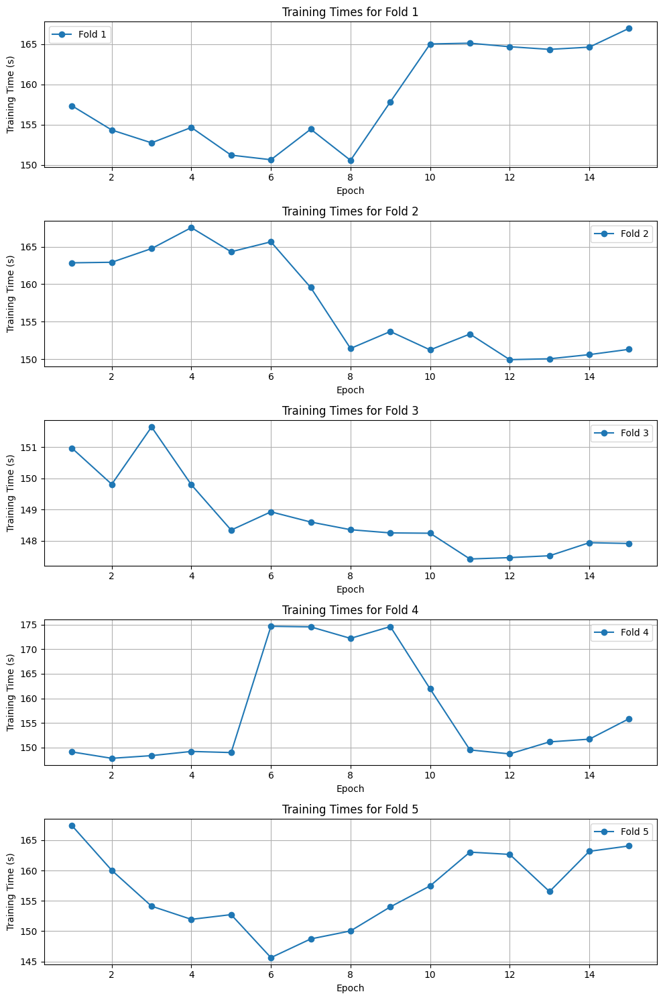

In [34]:
import matplotlib.pyplot as plt

fig, axes = plt.subplots(5, 1, figsize=(10, 15))

# Iterate through each fold and plot its training times
for i, fold in enumerate(all_train_times):
    axes[i].plot(range(1, 16), fold, marker='o', label=f'Fold {i+1}')
    axes[i].set_title(f'Training Times for Fold {i+1}')
    axes[i].set_xlabel('Epoch')
    axes[i].set_ylabel('Training Time (s)')
    axes[i].grid(True)
    axes[i].legend()

# Adjust layout to prevent overlap
plt.tight_layout()

# Show the plot
plt.show()

## Graph Train Loss for Each Fold

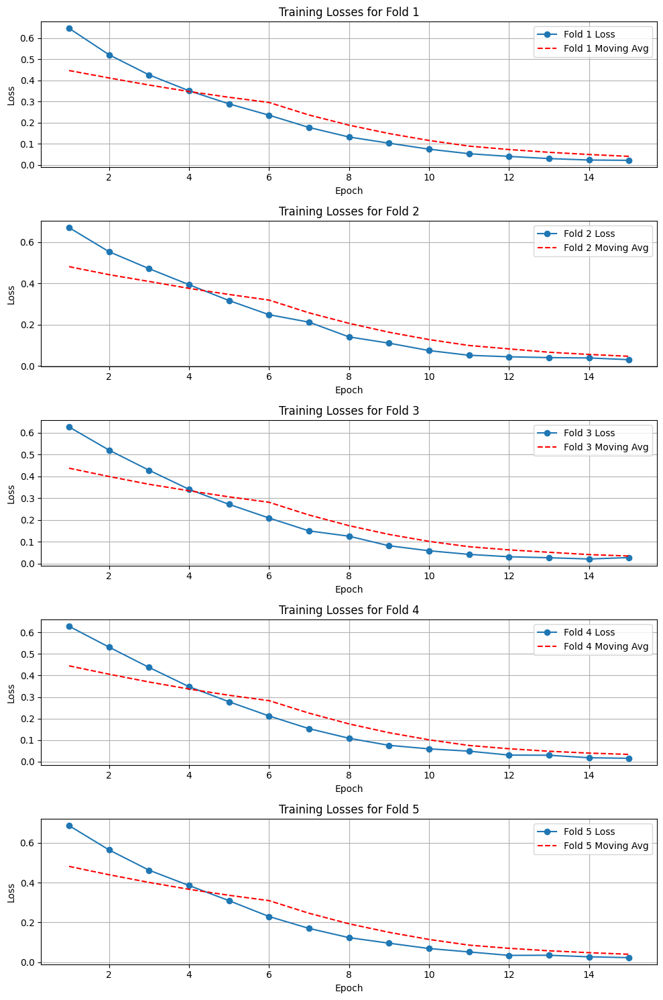

In [35]:

# Create a figure with 5 subplots (one for each fold)
fig, axes = plt.subplots(5, 1, figsize=(10, 15))

# Iterate through each fold and plot its training losses and moving average
for i, fold in enumerate(all_train_losses):
    # Convert the fold's loss values to a pandas Series for rolling mean
    tracking_loss = pd.Series(fold)
    
    # Ensure that the values are floats (necessary for rolling mean calculation)
    tracking_loss = tracking_loss.astype(float)
    
    # Calculate the rolling average with a window size of 10
    rolling_avg = tracking_loss.rolling(center=True, min_periods=1, window=10).mean()
    
    # Plot the original loss values
    axes[i].plot(range(1, len(fold) + 1), fold, marker='o', label=f'Fold {i+1} Loss')
    
    # Plot the moving average (rolling mean)
    axes[i].plot(range(1, len(fold) + 1), rolling_avg, linestyle='--', color='red', label=f'Fold {i+1} Moving Avg')
    
    # Set titles and labels
    axes[i].set_title(f'Training Losses for Fold {i+1}')
    axes[i].set_xlabel('Epoch')
    axes[i].set_ylabel('Loss')
    axes[i].grid(True)
    axes[i].legend()

# Adjust layout to prevent overlap
plt.tight_layout()

# Show the plot
plt.show()

### Graph Validation Loss for Each Fold

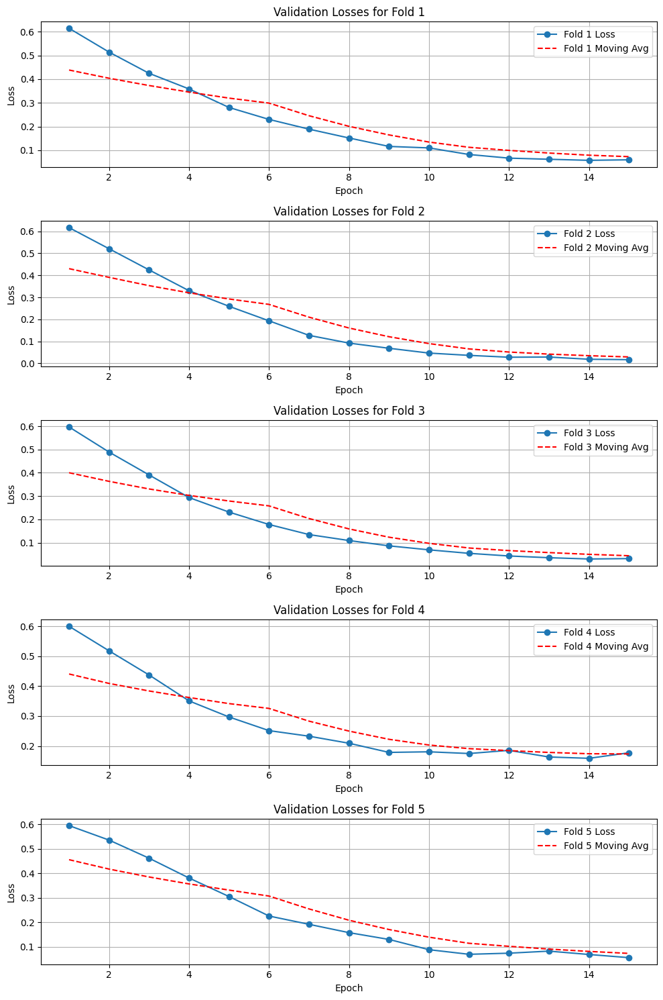

In [36]:
# Create a figure with 5 subplots (one for each fold)
fig, axes = plt.subplots(5, 1, figsize=(10, 15))

# Iterate through each fold and plot its training losses and moving average
for i, fold in enumerate(all_validation_loss):
    # Convert the fold's loss values to a pandas Series for rolling mean
    tracking_loss = pd.Series(fold)
    
    # Ensure that the values are floats (necessary for rolling mean calculation)
    tracking_loss = tracking_loss.astype(float)
    
    # Calculate the rolling average with a window size of 10
    rolling_avg = tracking_loss.rolling(center=True, min_periods=1, window=10).mean()
    
    # Plot the original loss values
    axes[i].plot(range(1, len(fold) + 1), fold, marker='o', label=f'Fold {i+1} Loss')
    
    # Plot the moving average (rolling mean)
    axes[i].plot(range(1, len(fold) + 1), rolling_avg, linestyle='--', color='red', label=f'Fold {i+1} Moving Avg')
    
    # Set titles and labels
    axes[i].set_title(f'Validation Losses for Fold {i+1}')
    axes[i].set_xlabel('Epoch')
    axes[i].set_ylabel('Loss')
    axes[i].grid(True)
    axes[i].legend()

# Adjust layout to prevent overlap
plt.tight_layout()

# Show the plot
plt.show()

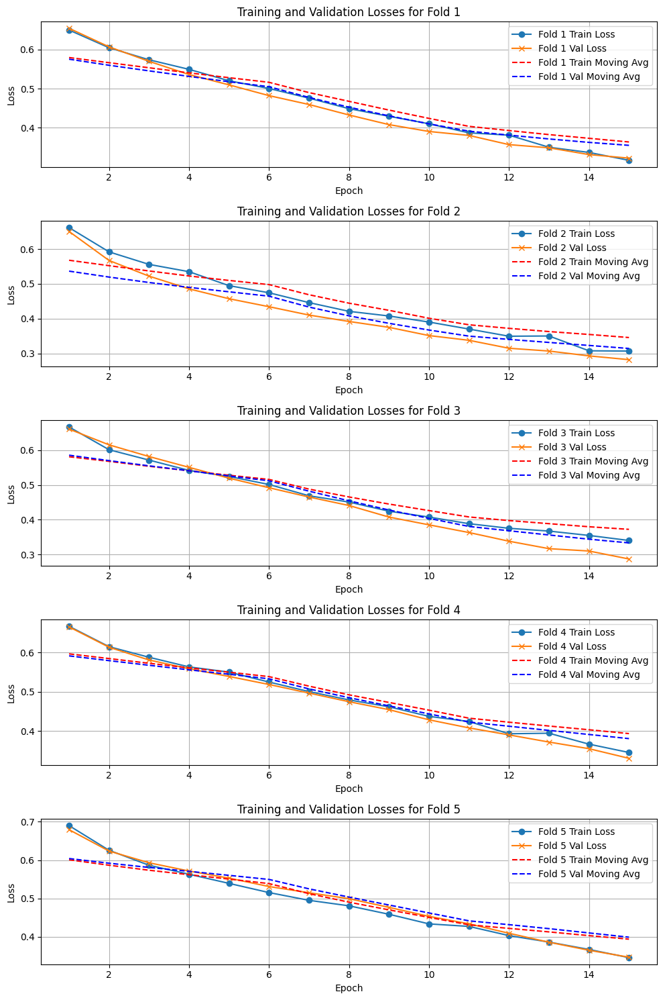

In [5]:
# Create a figure with 5 subplots (one for each fold)
fig, axes = plt.subplots(5, 1, figsize=(10, 15))

# Iterate through each fold and plot both training and validation losses with moving averages
for i, (train_loss, val_loss) in enumerate(zip(all_train_losses, all_validation_loss)):
    # Convert the training and validation loss values to pandas Series for rolling mean
    train_loss_series = pd.Series(train_loss).astype(float)
    val_loss_series = pd.Series(val_loss).astype(float)
    
    # Calculate the rolling average with a window size of 10
    train_rolling_avg = train_loss_series.rolling(center=True, min_periods=1, window=10).mean()
    val_rolling_avg = val_loss_series.rolling(center=True, min_periods=1, window=10).mean()
    
    # Plot the original training and validation losses
    axes[i].plot(range(1, len(train_loss) + 1), train_loss, marker='o', label=f'Fold {i+1} Train Loss')
    axes[i].plot(range(1, len(val_loss) + 1), val_loss, marker='x', label=f'Fold {i+1} Val Loss')
    
    # Plot the moving averages
    axes[i].plot(range(1, len(train_loss) + 1), train_rolling_avg, linestyle='--', color='red', label=f'Fold {i+1} Train Moving Avg')
    axes[i].plot(range(1, len(val_loss) + 1), val_rolling_avg, linestyle='--', color='blue', label=f'Fold {i+1} Val Moving Avg')
    
    # Set titles and labels
    axes[i].set_title(f'Training and Validation Losses for Fold {i+1}')
    axes[i].set_xlabel('Epoch')
    axes[i].set_ylabel('Loss')
    axes[i].grid(True)
    axes[i].legend()

# Adjust layout to prevent overlap
plt.tight_layout()

# Show the plot
plt.show()

### Bar Charts for Each Metric for Test Per Species

{'accuracy': [[0.16030534351145043, 0.8396946564885496], [0.14503816793893132, 0.8549618320610687], [0.12213740458015265, 0.8778625954198473], [0.09999999999999998, 0.9], [0.10769230769230764, 0.8923076923076924]], 'precision': [array([0.9047619 , 0.72340426]), array([0.8988764 , 0.76190476]), array([0.91111111, 0.80487805]), array([0.91304348, 0.86842105]), array([0.87878788, 0.93548387])], 'recall': [array([0.85393258, 0.80952381]), array([0.88888889, 0.7804878 ]), array([0.91111111, 0.80487805]), array([0.94382022, 0.80487805]), array([0.97752809, 0.70731707])], 'f1': [array([0.87861272, 0.76404494]), array([0.89385475, 0.77108434]), array([0.91111111, 0.80487805]), array([0.9281768 , 0.83544304]), array([0.92553191, 0.80555556])], 'auc': [np.float64(0.9312466559657571), np.float64(0.9579945799457994), np.float64(0.9547425474254743), np.float64(0.967936420937243), np.float64(0.9640997533570842)]}


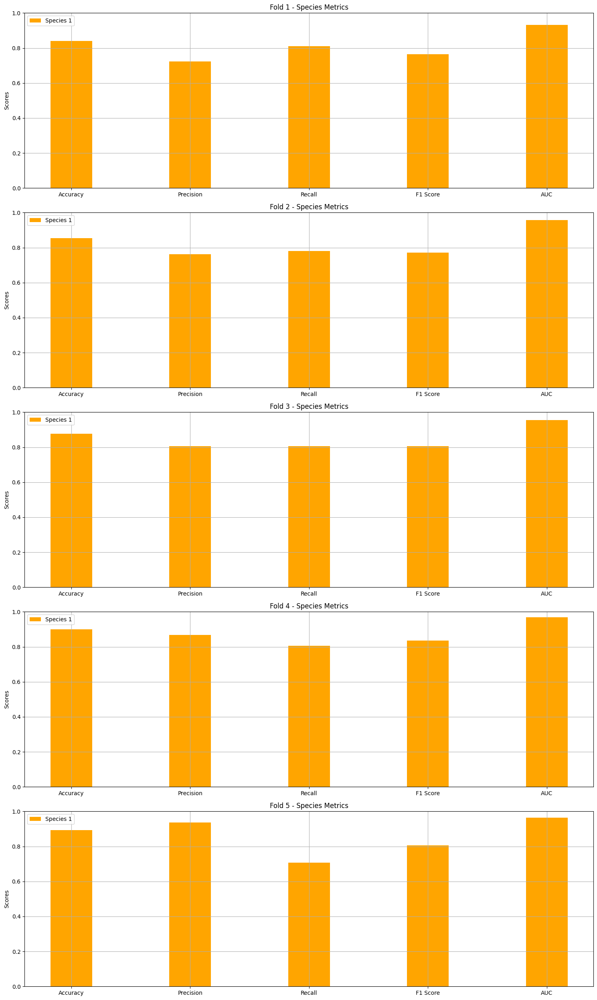


Fold 1 Metrics:
Accuracy: 0.8397, Precision: 0.7234, Recall: 0.8095, F1 Score: 0.7640, AUC: 0.9312

Fold 2 Metrics:
Accuracy: 0.8550, Precision: 0.7619, Recall: 0.7805, F1 Score: 0.7711, AUC: 0.9580

Fold 3 Metrics:
Accuracy: 0.8779, Precision: 0.8049, Recall: 0.8049, F1 Score: 0.8049, AUC: 0.9547

Fold 4 Metrics:
Accuracy: 0.9000, Precision: 0.8684, Recall: 0.8049, F1 Score: 0.8354, AUC: 0.9679

Fold 5 Metrics:
Accuracy: 0.8923, Precision: 0.9355, Recall: 0.7073, F1 Score: 0.8056, AUC: 0.9641


In [8]:
import matplotlib.pyplot as plt
import numpy as np

print(all_per_species_test_metrics)

# Number of metrics per fold (Accuracy, Precision, Recall, F1, AUC)
num_metrics = 5

# X positions for each metric group
x = np.arange(num_metrics)  # No need for species-based indexing

# Bar width
width = 0.35

# Create subplots for each fold (one bar chart with all metrics)
fig, axes = plt.subplots(5, figsize=(15, 5 * 5))

# Metric labels
metric_labels = ['Accuracy', 'Precision', 'Recall', 'F1 Score', 'AUC']

# Iterate over each fold to create the bar charts
for fold in range(5):
    # Extract per-species metrics for this fold
    species_1_accuracy = all_per_species_test_metrics['accuracy'][fold][1]
    species_1_precision = all_per_species_test_metrics['precision'][fold][1]
    species_1_recall = all_per_species_test_metrics['recall'][fold][1]
    species_1_f1 = all_per_species_test_metrics['f1'][fold][1]
    species_1_auc = all_test_metrics['auc'][fold]

    # Create the bars for this fold (only Species 1)
    axes[fold].bar(x, [species_1_accuracy, species_1_precision, species_1_recall, species_1_f1, species_1_auc],
                   width, label='Species 1', color='orange')

    axes[fold].set_title(f"Fold {fold + 1} - Species Metrics")
    axes[fold].set_xticks(x)
    axes[fold].set_xticklabels(metric_labels)
    axes[fold].set_ylabel('Scores')
    axes[fold].set_ylim(0, 1)  # Ensuring y-axis ranges from 0 to 1 for metric comparison
    axes[fold].legend()
    axes[fold].grid(True)

# Adjust layout to prevent overlap
plt.tight_layout()

# Show the plot
plt.show()

# Print only Species 1 metrics per fold
for fold in range(5):
    print(f"\nFold {fold + 1} Metrics:")
    print(f"Accuracy: {all_per_species_test_metrics['accuracy'][fold][1]:.4f}, "
          f"Precision: {all_per_species_test_metrics['precision'][fold][1]:.4f}, "
          f"Recall: {all_per_species_test_metrics['recall'][fold][1]:.4f}, "
          f"F1 Score: {all_per_species_test_metrics['f1'][fold][1]:.4f}, "
          f"AUC: {all_test_metrics['auc'][fold]:.4f}")


### Average Over All Test Metrics Per Species

/var/folders/tw/djq1qjxx4_v0lvns6wbl3cxm0000gn/T/ipykernel_21039/1178646722.py:30: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax.legend()


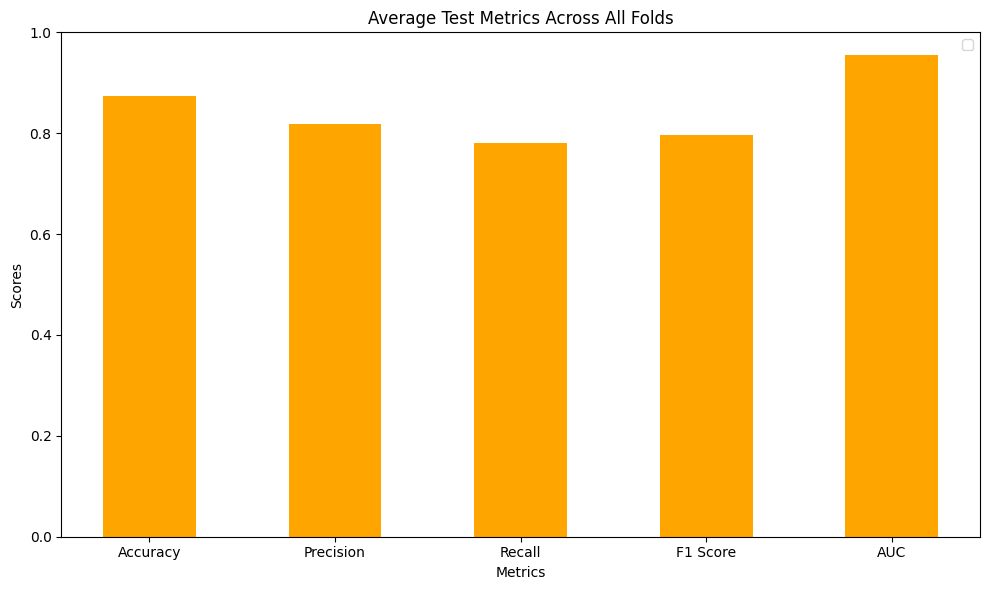

Average Test Metrics Across All Folds:
Accuracy: 0.8730, Precision: 0.8188, Recall: 0.7814, F1 Score: 0.7962, AUC: 0.9552


In [9]:
import matplotlib.pyplot as plt
import numpy as np

# Metric labels
metric_labels = ['Accuracy', 'Precision', 'Recall', 'F1 Score', 'AUC']

# Calculate the average values for each metric across all folds (only Species 1)
avg_accuracy_species_1 = np.mean([metrics[1] for metrics in all_per_species_test_metrics['accuracy']])
avg_precision_species_1 = np.mean([metrics[1] for metrics in all_per_species_test_metrics['precision']])
avg_recall_species_1 = np.mean([metrics[1] for metrics in all_per_species_test_metrics['recall']])
avg_f1_species_1 = np.mean([metrics[1] for metrics in all_per_species_test_metrics['f1']])
avg_auc_species_1 = np.mean(all_test_metrics['auc'])

# Create a bar chart for Species 1
x = np.arange(len(metric_labels))  # X positions for each metric
width = 0.5  # Adjusted bar width since we're only plotting one species

fig, ax = plt.subplots(figsize=(10, 6))

ax.bar(x, [avg_accuracy_species_1, avg_precision_species_1, avg_recall_species_1, avg_f1_species_1, avg_auc_species_1],
       width, color='orange')

# Add labels, title, and legend
ax.set_xlabel('Metrics')
ax.set_ylabel('Scores')
ax.set_title('Average Test Metrics Across All Folds')
ax.set_xticks(x)
ax.set_xticklabels(metric_labels)
ax.set_ylim(0, 1)  # y-axis range from 0 to 1 for comparison
ax.legend()

# Show the plot
plt.tight_layout()
plt.show()

# Print the average test metrics (only Species 1)
print("Average Test Metrics Across All Folds:")
print(f"Accuracy: {avg_accuracy_species_1:.4f}, Precision: {avg_precision_species_1:.4f}, "
      f"Recall: {avg_recall_species_1:.4f}, F1 Score: {avg_f1_species_1:.4f}, AUC: {avg_auc_species_1:.4f}")


### Average Overall Across All Folds for Test Metrics

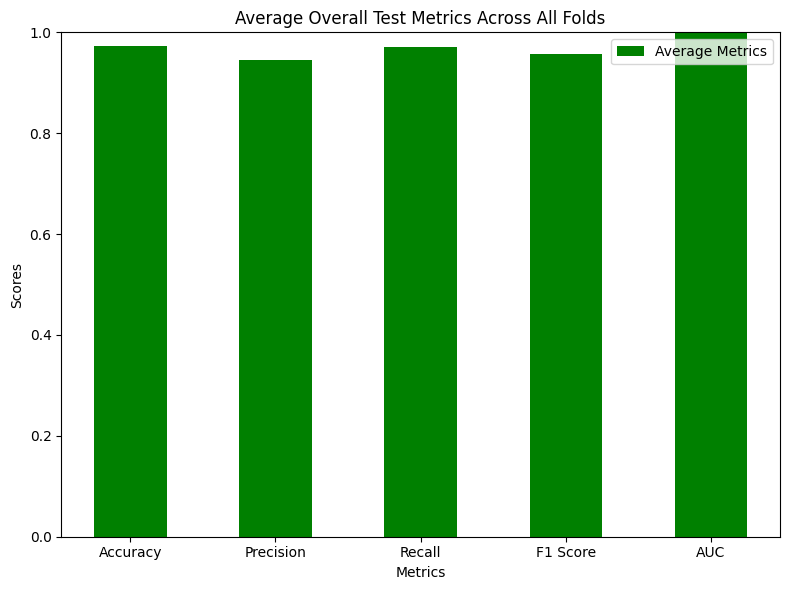

Average Overall Test Metrics Across All Folds:
Accuracy: 0.9724
Precision: 0.9455
Recall: 0.9707
F1 Score: 0.9567
AUC: 0.9989


In [40]:
# Calculate the average values for each metric across all folds
avg_accuracy = np.mean(all_test_metrics['accuracy'])
avg_precision = np.mean(all_test_metrics['precision'])
avg_recall = np.mean(all_test_metrics['recall'])
avg_f1 = np.mean(all_test_metrics['f1'])
avg_auc = np.mean(all_test_metrics['auc'])

# Create a bar chart to display the average values
metric_labels = ['Accuracy', 'Precision', 'Recall', 'F1 Score', 'AUC']
avg_metrics = [avg_accuracy, avg_precision, avg_recall, avg_f1, avg_auc]

x = np.arange(len(metric_labels))  # x positions for each metric
width = 0.5  # Bar width

# Plot the averages for overall metrics
fig, ax = plt.subplots(figsize=(8, 6))
ax.bar(x, avg_metrics, width, color='green', label='Average Metrics')

# Add labels, title, and legend
ax.set_xlabel('Metrics')
ax.set_ylabel('Scores')
ax.set_title('Average Overall Test Metrics Across All Folds')
ax.set_xticks(x)
ax.set_xticklabels(metric_labels)
ax.set_ylim(0, 1)  # y-axis range from 0 to 1 for comparison
ax.legend()

# Show the plot
plt.tight_layout()
plt.show()

# Print the average overall test metrics
print("Average Overall Test Metrics Across All Folds:")
print(f"Accuracy: {avg_accuracy:.4f}")
print(f"Precision: {avg_precision:.4f}")
print(f"Recall: {avg_recall:.4f}")
print(f"F1 Score: {avg_f1:.4f}")
print(f"AUC: {avg_auc:.4f}")

### Overall Per Fold for Test

Fold 1:
  Accuracy  : 1.0000
  Precision : 1.0000
  Recall    : 1.0000
  F1 Score  : 1.0000
  AUC       : 1.0000

Fold 2:
  Accuracy  : 1.0000
  Precision : 1.0000
  Recall    : 1.0000
  F1 Score  : 1.0000
  AUC       : 1.0000

Fold 3:
  Accuracy  : 1.0000
  Precision : 1.0000
  Recall    : 1.0000
  F1 Score  : 1.0000
  AUC       : 1.0000

Fold 4:
  Accuracy  : 0.9692
  Precision : 0.9707
  Recall    : 0.9578
  F1 Score  : 0.9639
  AUC       : 0.9973

Fold 5:
  Accuracy  : 0.9615
  Precision : 0.9583
  Recall    : 0.9522
  F1 Score  : 0.9552
  AUC       : 0.9951



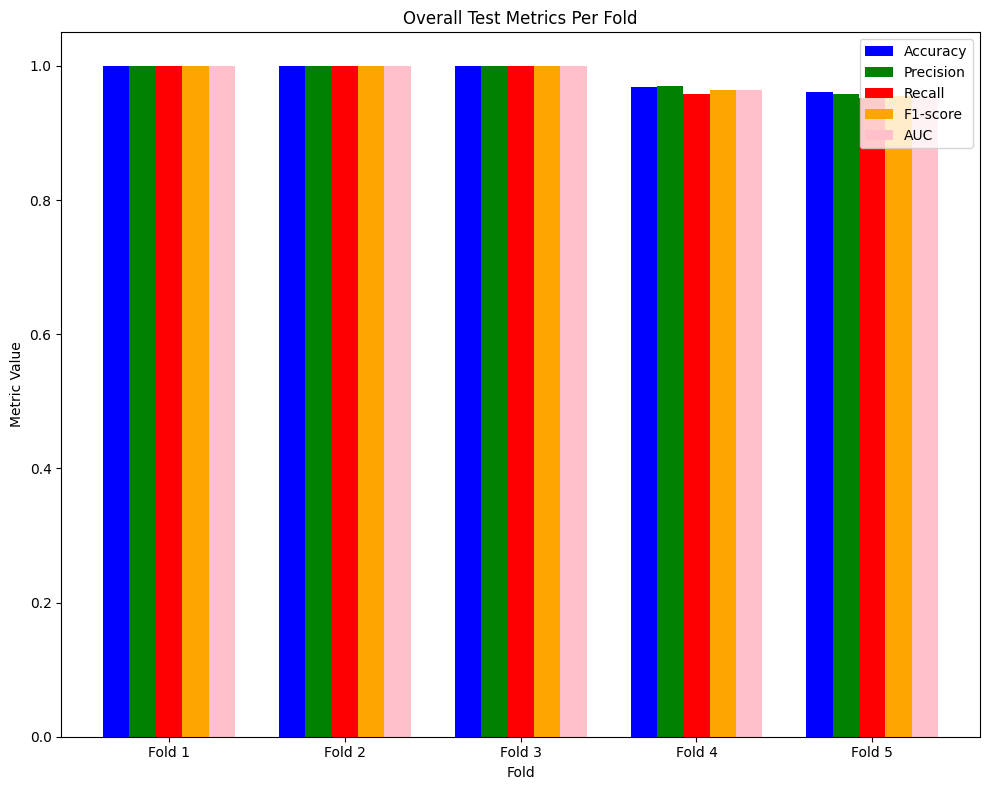

In [100]:
# Set up positions for the bars
folds = range(1, len(all_test_metrics['accuracy']) + 1)

# Set up the bar width
width = 0.15

# Create a figure
plt.figure(figsize=(10, 8))

# Plot one bar chart per fold
for fold in range(len(folds)):
    # Get the metrics for the current fold
    accuracy = all_test_metrics['accuracy'][fold]
    precision = all_test_metrics['precision'][fold]
    recall = all_test_metrics['recall'][fold]
    f1 = all_test_metrics['f1'][fold]
    auc = all_test_metrics['auc'][fold]

    # Print the metrics for this fold
    print(f"Fold {fold + 1}:")
    print(f"  Accuracy  : {accuracy:.4f}")
    print(f"  Precision : {precision:.4f}")
    print(f"  Recall    : {recall:.4f}")
    print(f"  F1 Score  : {f1:.4f}")
    print(f"  AUC       : {auc:.4f}\n")
    
    # Set x positions for the bars
    bar_positions = np.array([fold + 1 - 2 * width, fold + 1 - width, fold + 1, fold + 1 + width, fold + 1 + 2 * width])
    
    # Plot bars for the current fold
    plt.bar(bar_positions[0], accuracy, width, label='Accuracy' if fold == 0 else "", color='b')
    plt.bar(bar_positions[1], precision, width, label='Precision' if fold == 0 else "", color='g')
    plt.bar(bar_positions[2], recall, width, label='Recall' if fold == 0 else "", color='r')
    plt.bar(bar_positions[3], f1, width, label='F1-score' if fold == 0 else "", color='orange')
    plt.bar(bar_positions[4], f1, width, label='AUC' if fold == 0 else "", color='pink')

# Labeling the graph
plt.title('Overall Test Metrics Per Fold')
plt.xlabel('Fold')
plt.ylabel('Metric Value')
plt.xticks(folds, [f'Fold {i}' for i in folds])

# Display the legend
plt.legend()

# Show the plot
plt.tight_layout()
plt.show()

## Which Images Did Test Get Wrong?

Processing Confusion Matrix for Fold 1


/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)


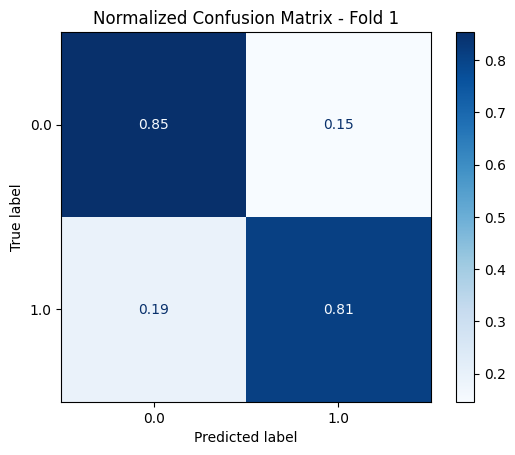

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_0599.JPG
Predicted Label: tensor([0], dtype=torch.int32), True Label: 1.0


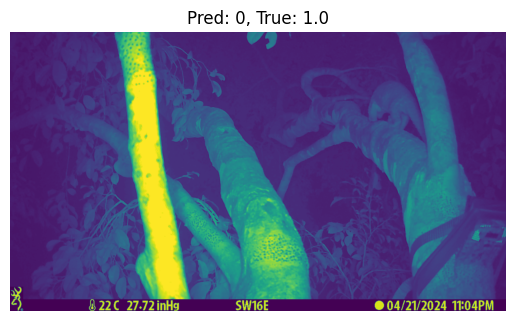

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1332.JPG
Predicted Label: tensor([0], dtype=torch.int32), True Label: 1.0


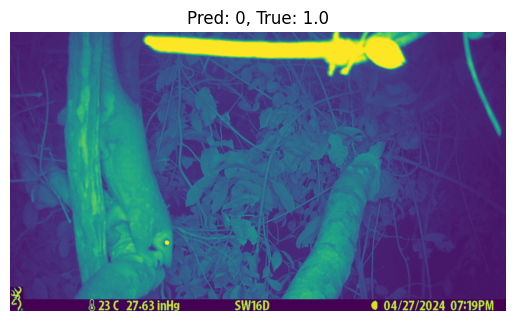

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1037.JPG
Predicted Label: tensor([0], dtype=torch.int32), True Label: 1.0


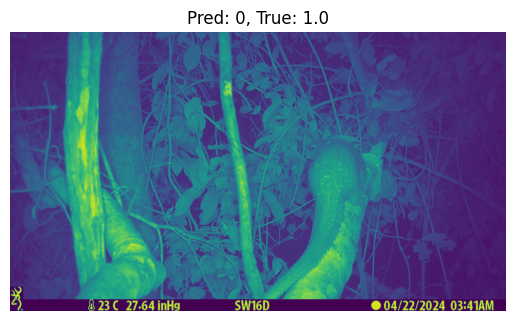

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1015.JPG
Predicted Label: tensor([0], dtype=torch.int32), True Label: 1.0


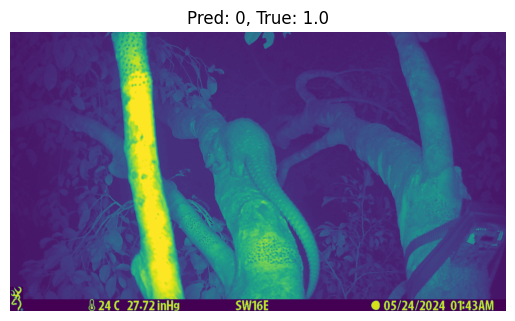

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_0162.JPG
Predicted Label: tensor([0], dtype=torch.int32), True Label: 1.0


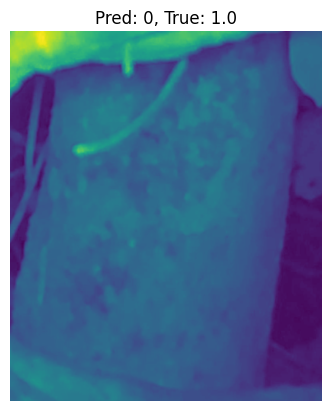

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1095.JPG
Predicted Label: tensor([0], dtype=torch.int32), True Label: 1.0


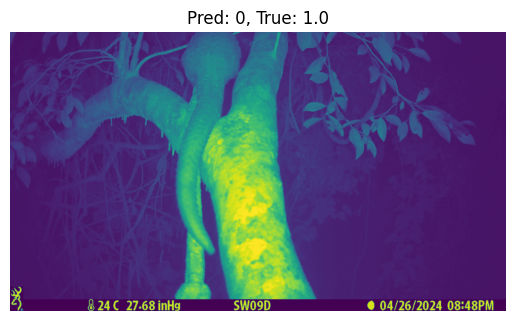

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1037.JPG
Predicted Label: tensor([0], dtype=torch.int32), True Label: 1.0


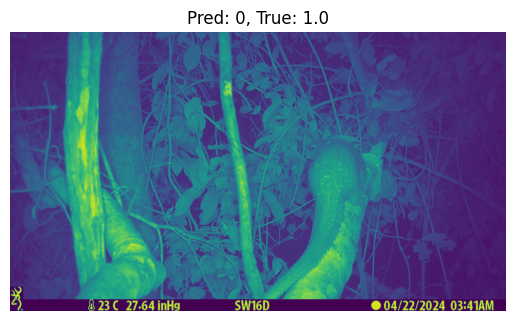

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1036.JPG
Predicted Label: tensor([0], dtype=torch.int32), True Label: 1.0


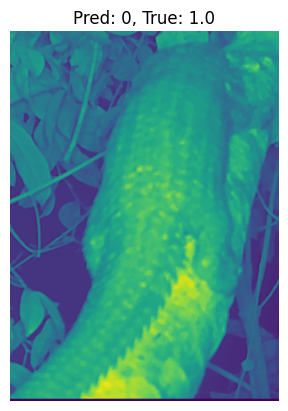

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1196.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


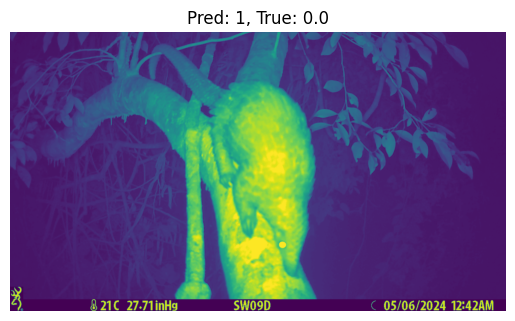

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1144.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


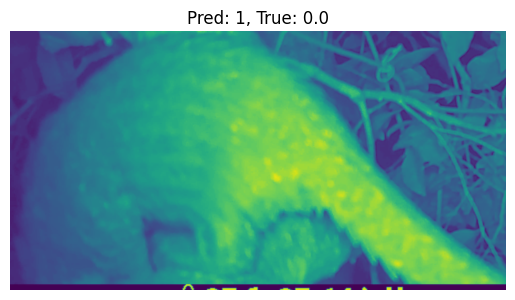

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1598.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


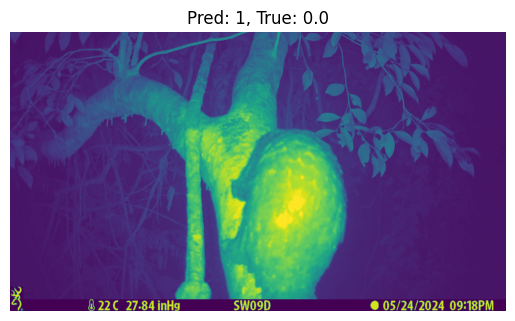

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1015.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


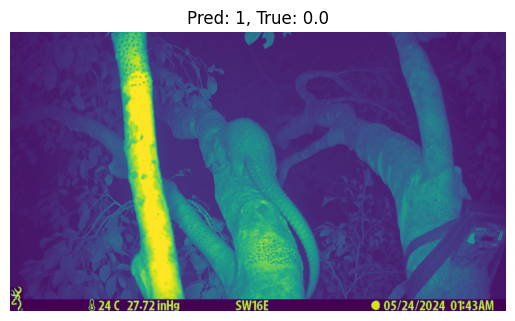

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1603.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


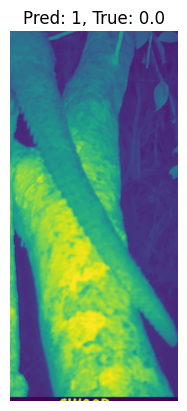

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_0969.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


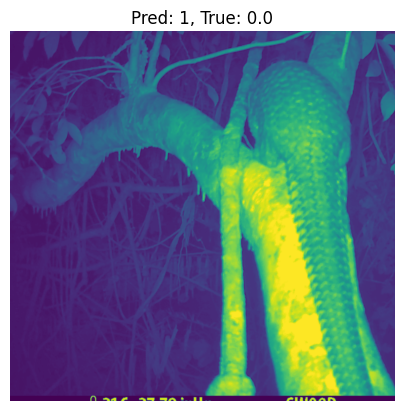

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1194.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


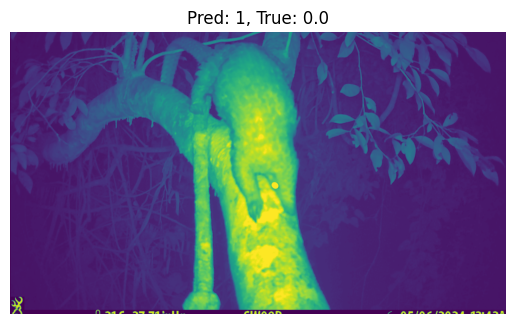

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1183.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


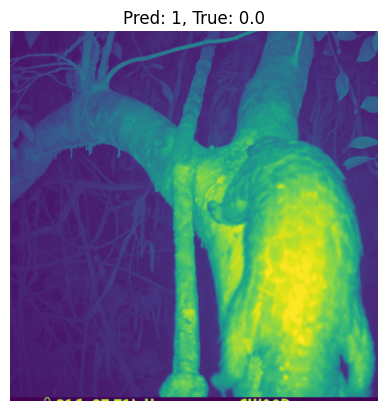

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_0271.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


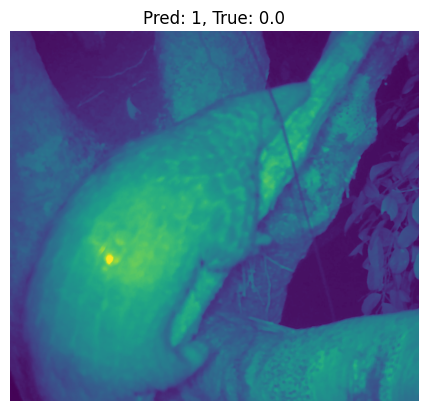

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1194.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


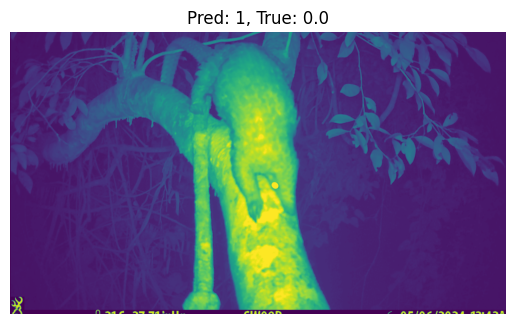

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_0252.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


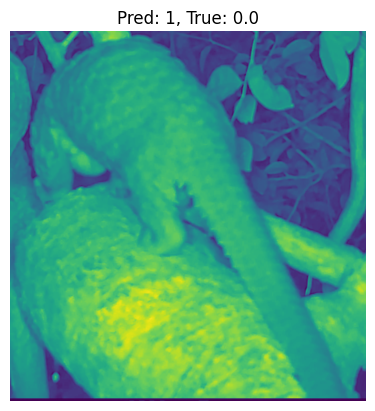

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1167.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


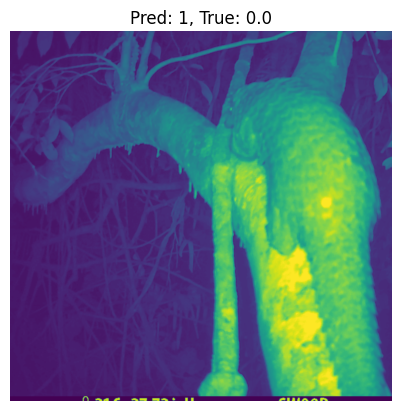

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1600.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


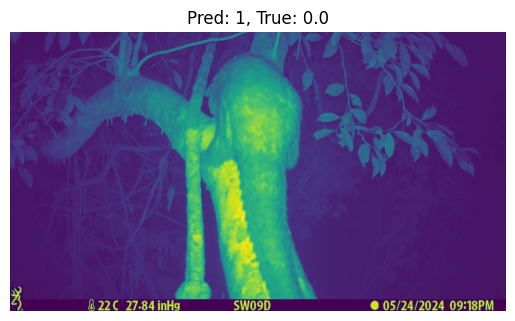

Processing Confusion Matrix for Fold 2


/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)


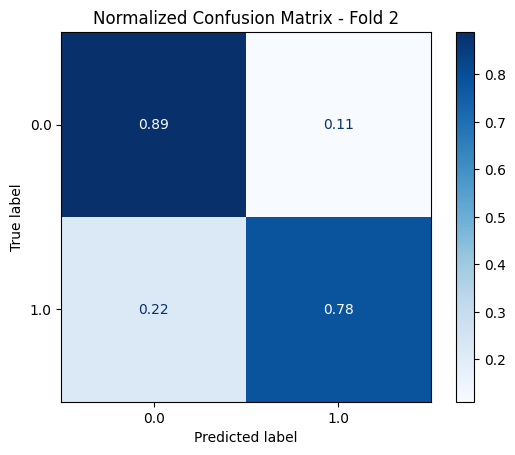

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_0559.JPG
Predicted Label: tensor([0], dtype=torch.int32), True Label: 1.0


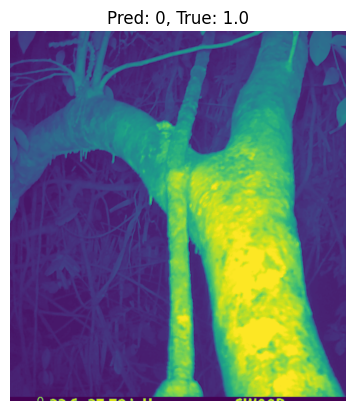

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_0563.JPG
Predicted Label: tensor([0], dtype=torch.int32), True Label: 1.0


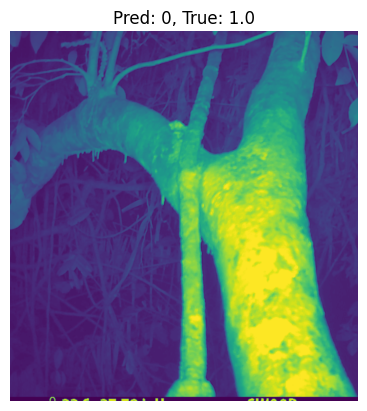

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1019.JPG
Predicted Label: tensor([0], dtype=torch.int32), True Label: 1.0


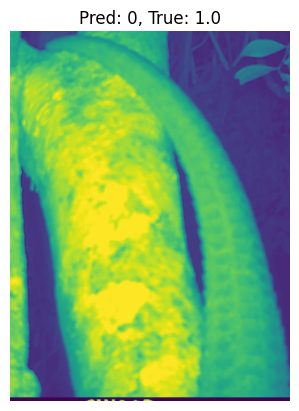

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1178.JPG
Predicted Label: tensor([0], dtype=torch.int32), True Label: 1.0


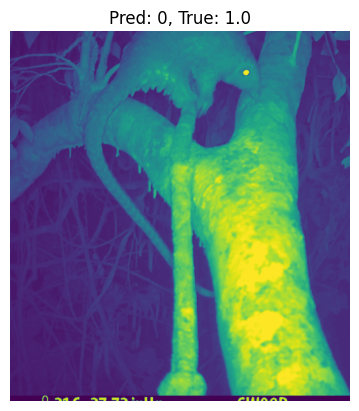

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1016.JPG
Predicted Label: tensor([0], dtype=torch.int32), True Label: 1.0


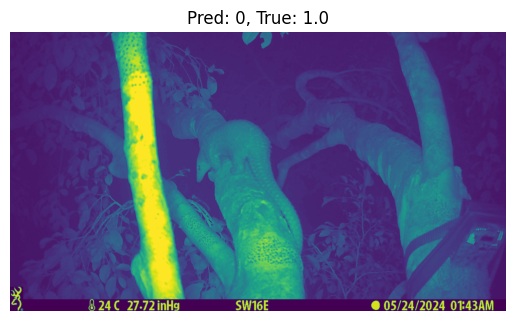

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1011.JPG
Predicted Label: tensor([0], dtype=torch.int32), True Label: 1.0


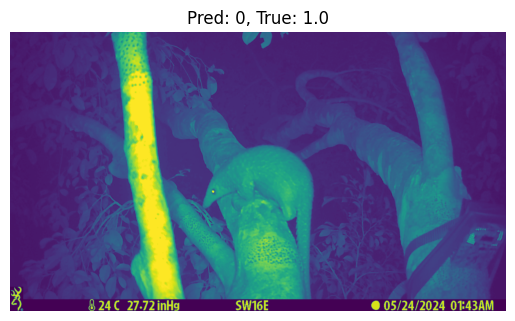

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1012.JPG
Predicted Label: tensor([0], dtype=torch.int32), True Label: 1.0


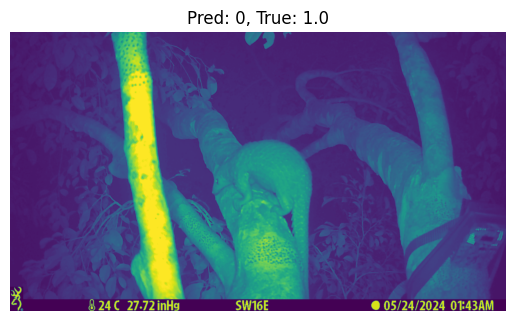

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_0558.JPG
Predicted Label: tensor([0], dtype=torch.int32), True Label: 1.0


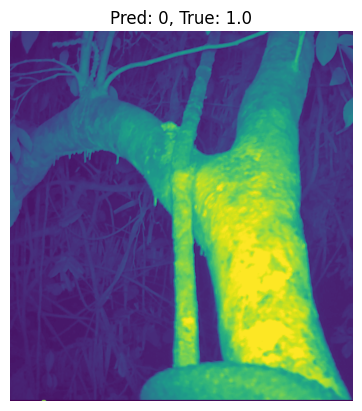

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1097.JPG
Predicted Label: tensor([0], dtype=torch.int32), True Label: 1.0


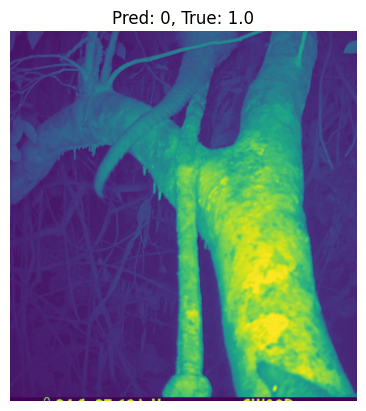

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1145.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


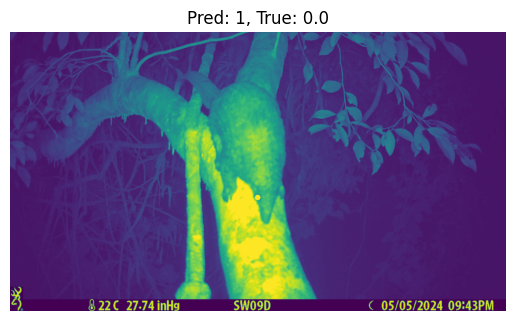

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1019.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


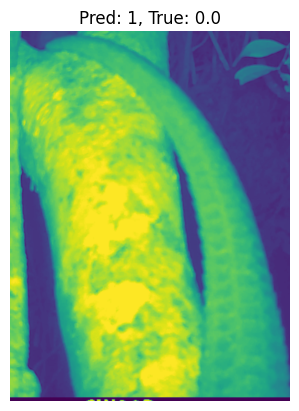

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1005.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


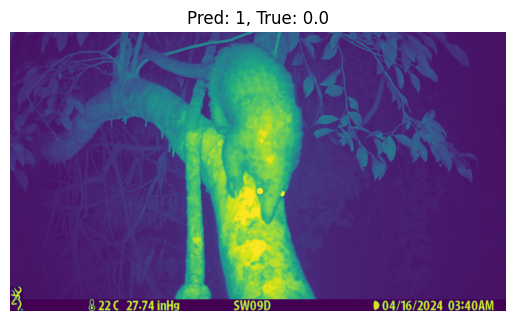

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1007.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


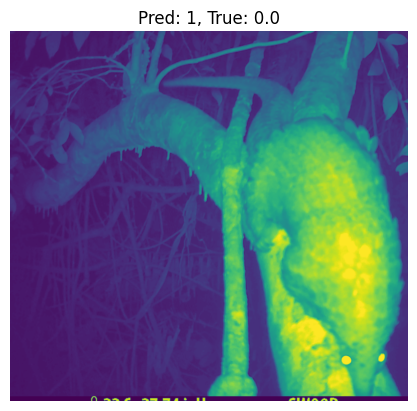

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_0425.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


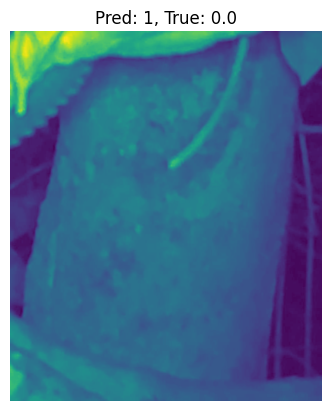

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_0558.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


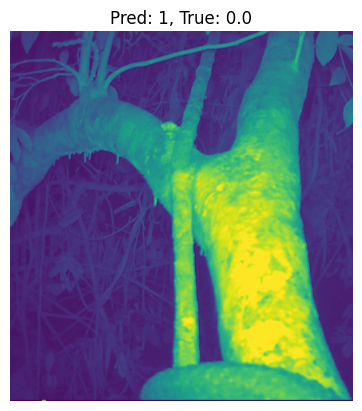

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_0158.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


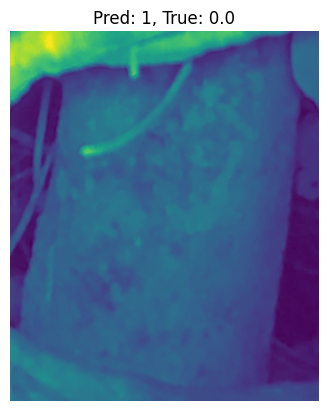

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1168.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


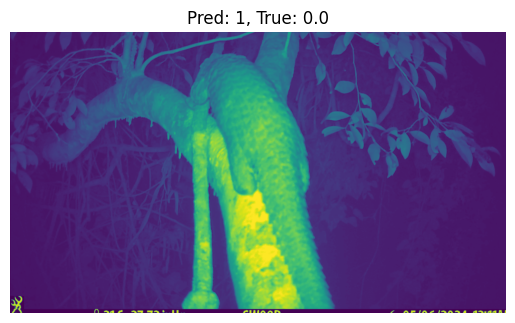

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1011.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


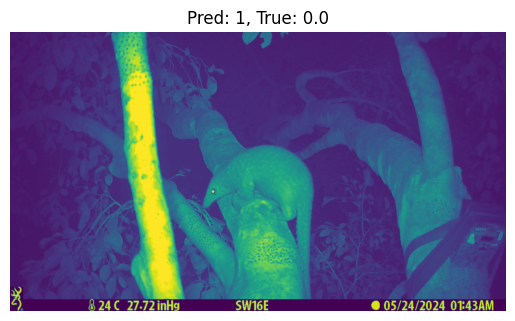

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1172.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


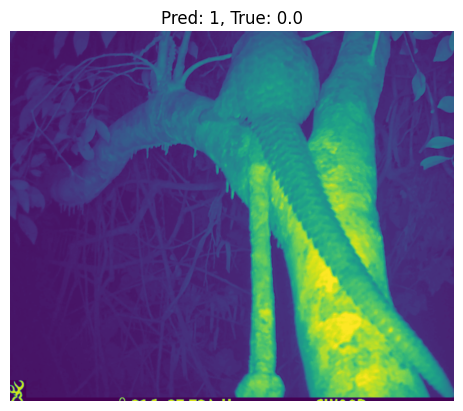

Processing Confusion Matrix for Fold 3


/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)


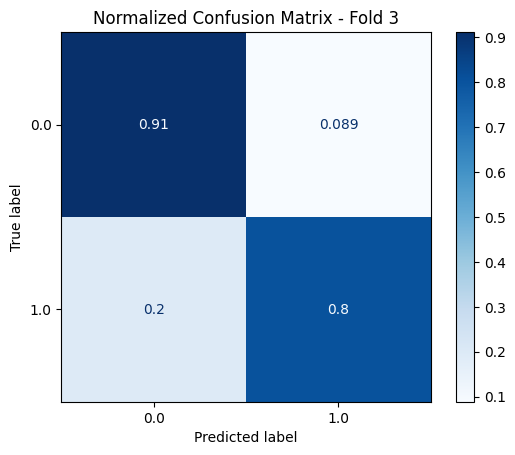

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_0605.JPG
Predicted Label: tensor([0], dtype=torch.int32), True Label: 1.0


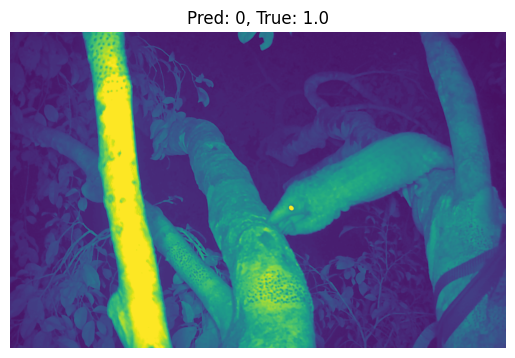

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_0577.JPG
Predicted Label: tensor([0], dtype=torch.int32), True Label: 1.0


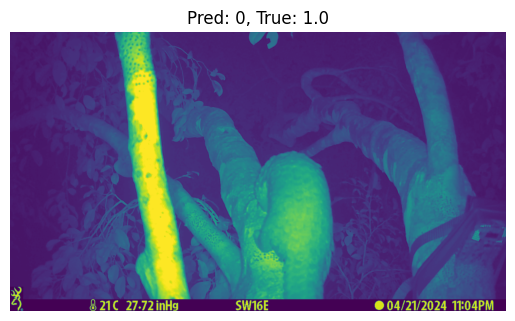

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_0603.JPG
Predicted Label: tensor([0], dtype=torch.int32), True Label: 1.0


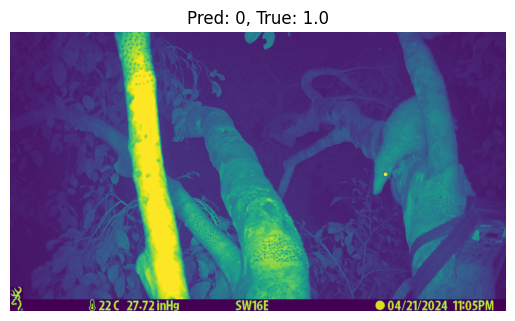

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_0560.JPG
Predicted Label: tensor([0], dtype=torch.int32), True Label: 1.0


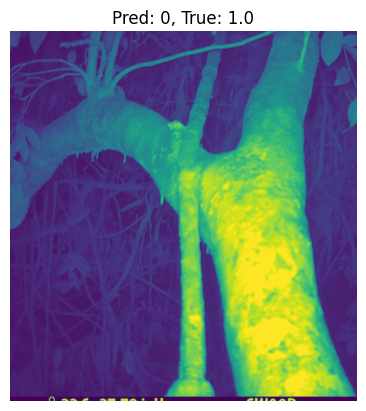

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1637.JPG
Predicted Label: tensor([0], dtype=torch.int32), True Label: 1.0


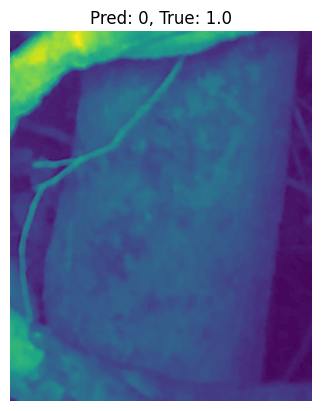

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1013.JPG
Predicted Label: tensor([0], dtype=torch.int32), True Label: 1.0


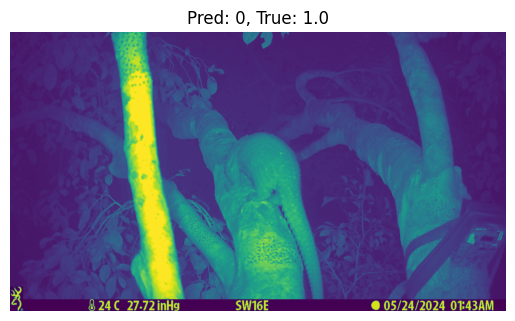

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_0578.JPG
Predicted Label: tensor([0], dtype=torch.int32), True Label: 1.0


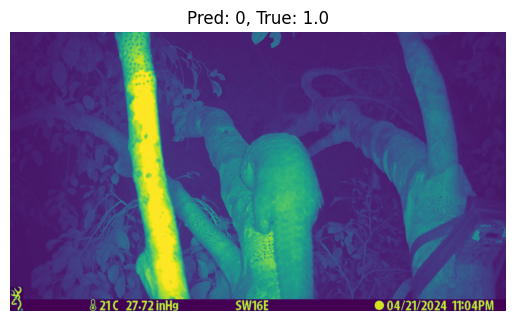

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_0015.JPG
Predicted Label: tensor([0], dtype=torch.int32), True Label: 1.0


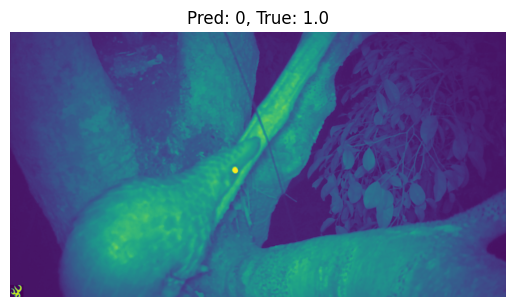

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1637.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


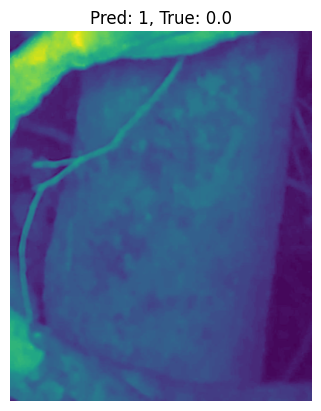

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1033.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


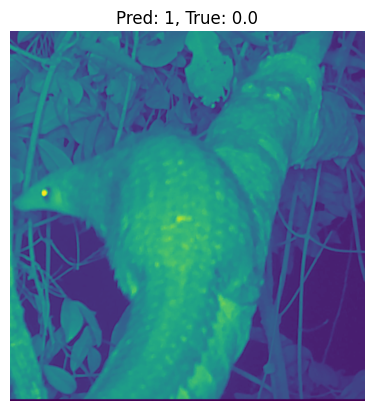

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1201.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


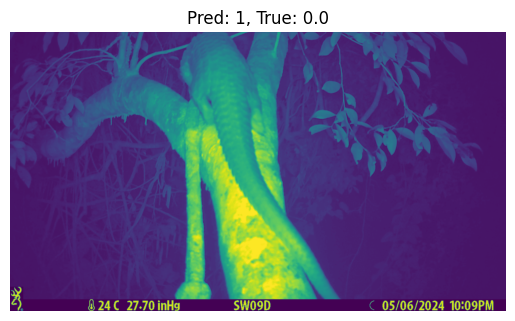

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1166.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


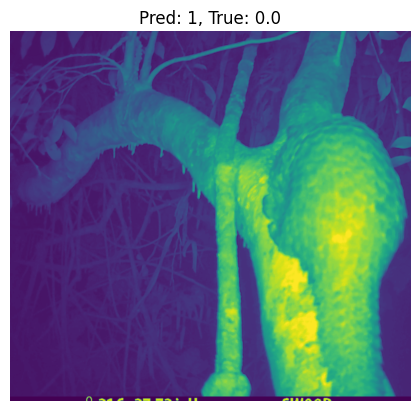

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1637.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


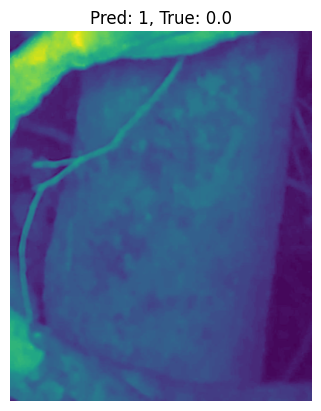

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1201.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


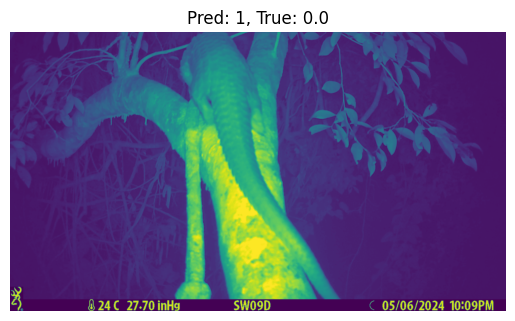

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1033.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


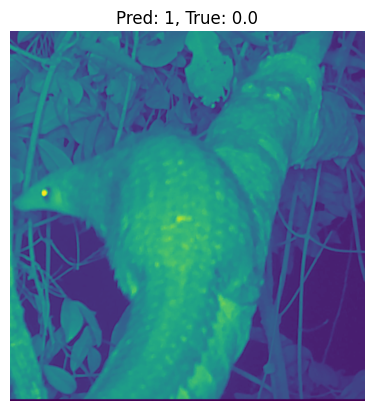

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1148.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


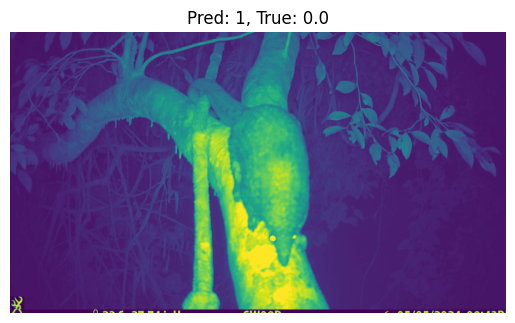

Processing Confusion Matrix for Fold 4


/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)


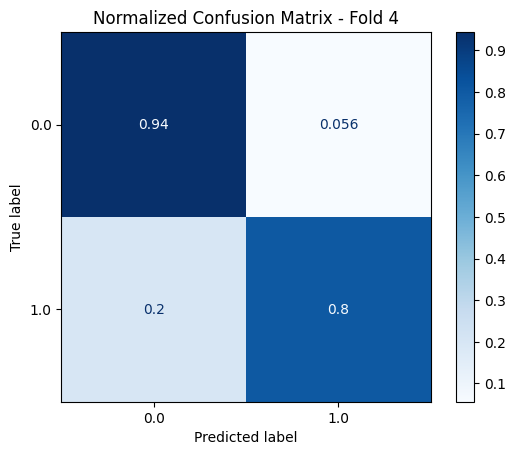

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_0606.JPG
Predicted Label: tensor([0], dtype=torch.int32), True Label: 1.0


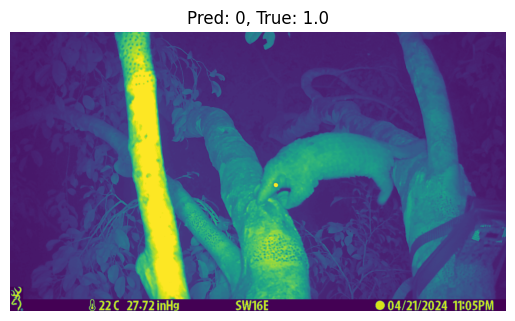

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1180.JPG
Predicted Label: tensor([0], dtype=torch.int32), True Label: 1.0


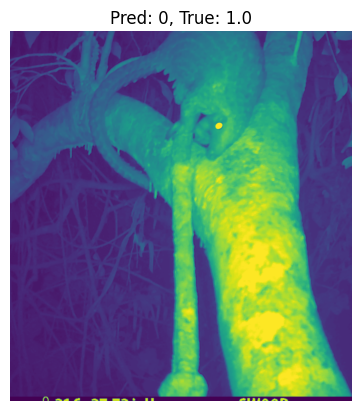

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1179.JPG
Predicted Label: tensor([0], dtype=torch.int32), True Label: 1.0


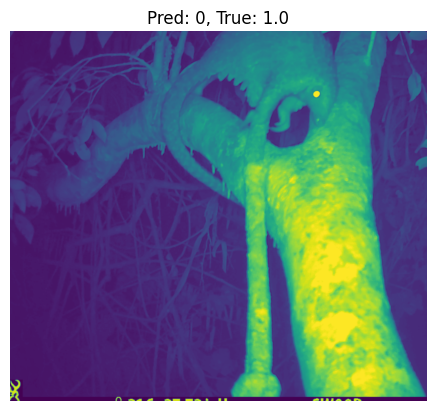

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1176.JPG
Predicted Label: tensor([0], dtype=torch.int32), True Label: 1.0


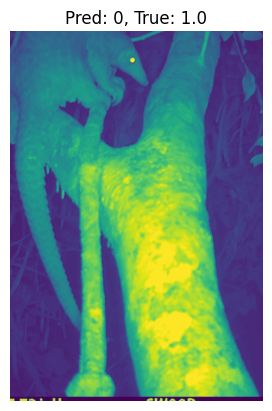

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1613.JPG
Predicted Label: tensor([0], dtype=torch.int32), True Label: 1.0


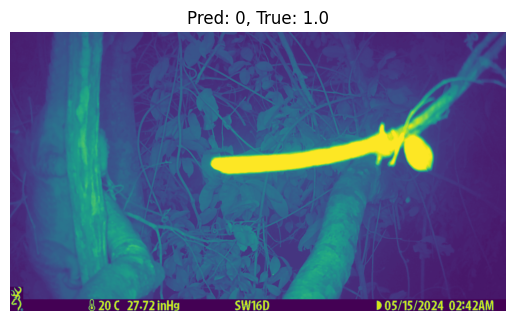

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_0606.JPG
Predicted Label: tensor([0], dtype=torch.int32), True Label: 1.0


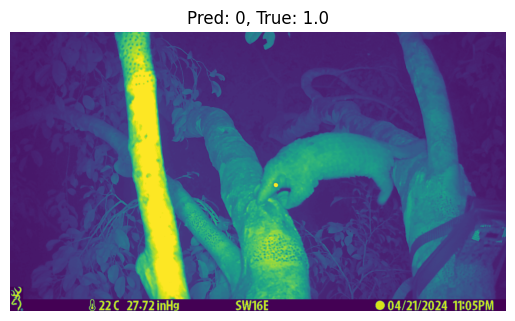

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1686.JPG
Predicted Label: tensor([0], dtype=torch.int32), True Label: 1.0


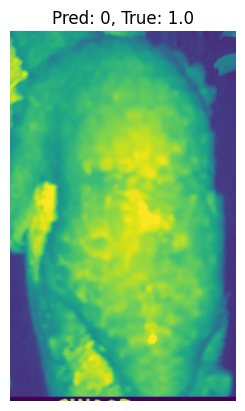

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_0159.JPG
Predicted Label: tensor([0], dtype=torch.int32), True Label: 1.0


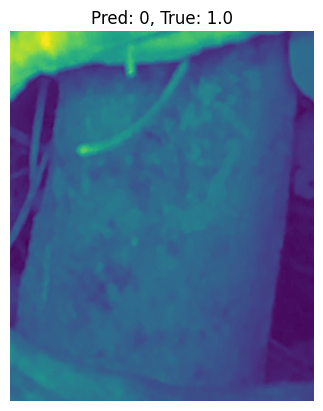

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1197.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


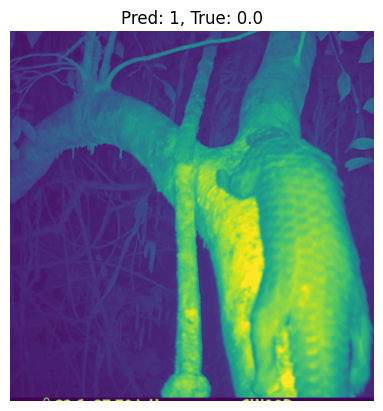

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1008.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


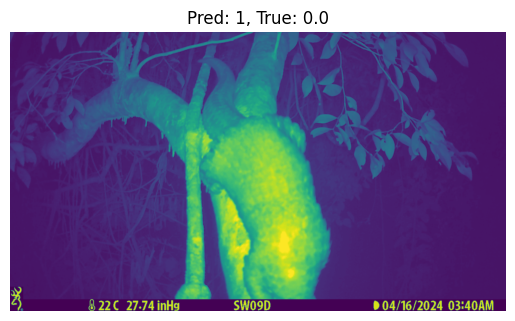

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1193.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


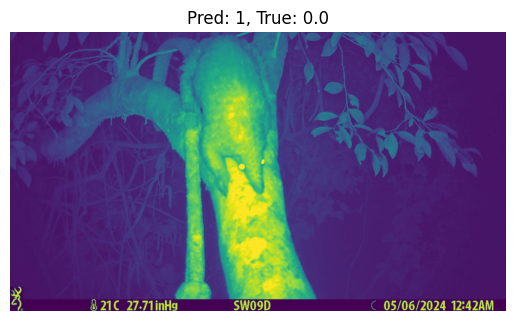

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1146.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


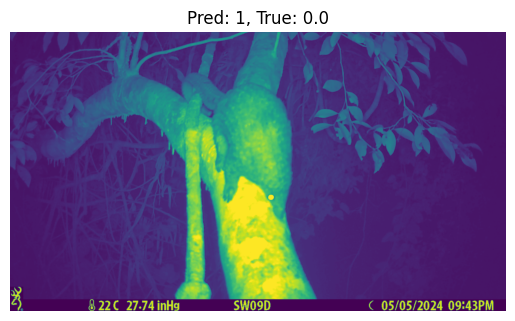

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_0417.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


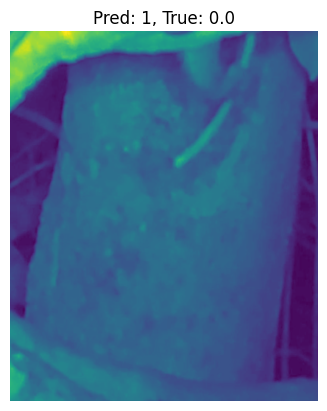

Processing Confusion Matrix for Fold 5


/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)


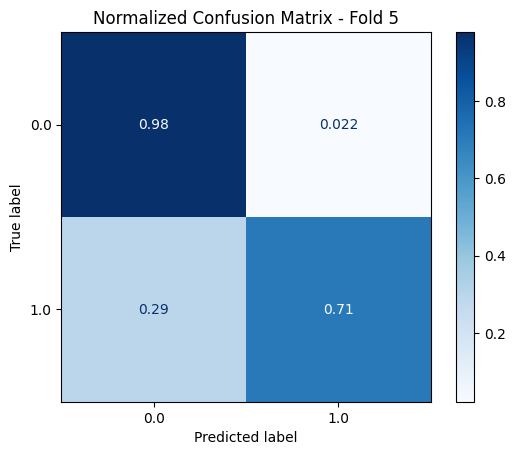

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_0809.JPG
Predicted Label: tensor([0], dtype=torch.int32), True Label: 1.0


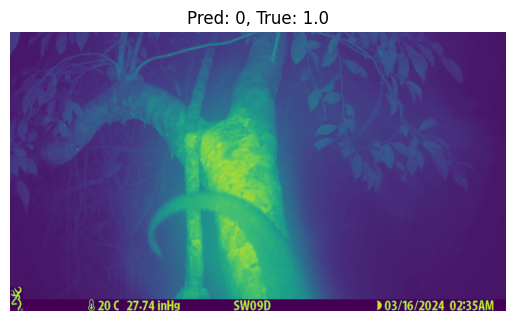

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_0016.JPG
Predicted Label: tensor([0], dtype=torch.int32), True Label: 1.0


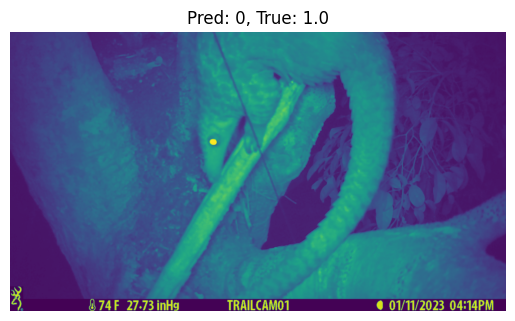

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_0562.JPG
Predicted Label: tensor([0], dtype=torch.int32), True Label: 1.0


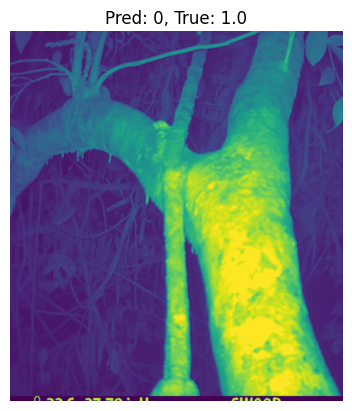

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1156.JPG
Predicted Label: tensor([0], dtype=torch.int32), True Label: 1.0


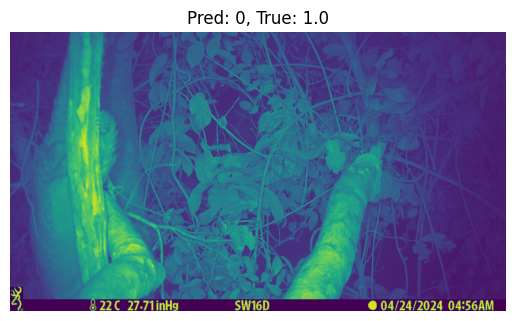

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1018.JPG
Predicted Label: tensor([0], dtype=torch.int32), True Label: 1.0


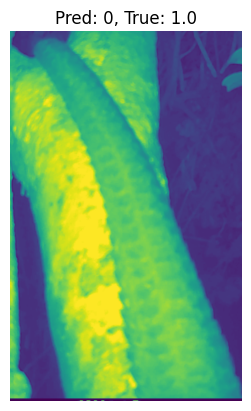

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1014.JPG
Predicted Label: tensor([0], dtype=torch.int32), True Label: 1.0


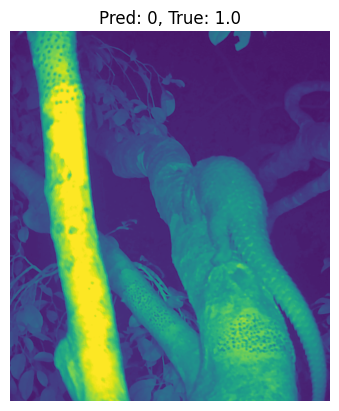

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1010.JPG
Predicted Label: tensor([0], dtype=torch.int32), True Label: 1.0


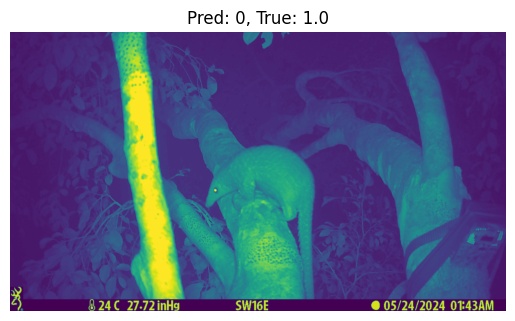

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_0236.JPG
Predicted Label: tensor([0], dtype=torch.int32), True Label: 1.0


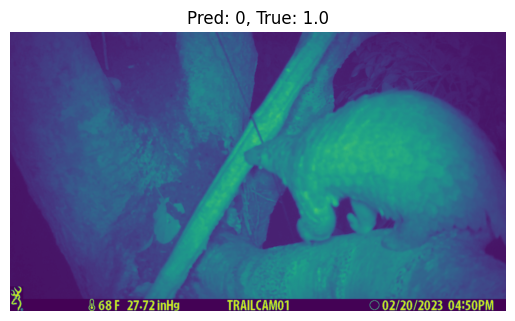

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1690.JPG
Predicted Label: tensor([0], dtype=torch.int32), True Label: 1.0


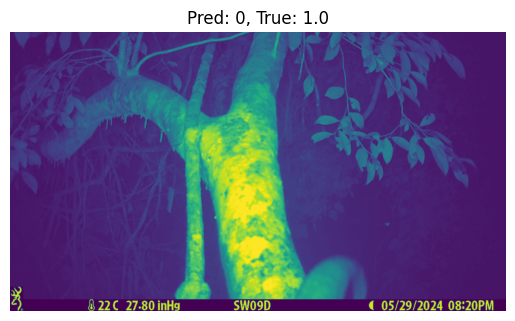

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_0598.JPG
Predicted Label: tensor([0], dtype=torch.int32), True Label: 1.0


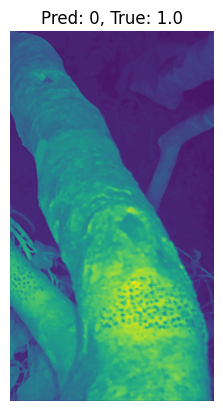

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1687.JPG
Predicted Label: tensor([0], dtype=torch.int32), True Label: 1.0


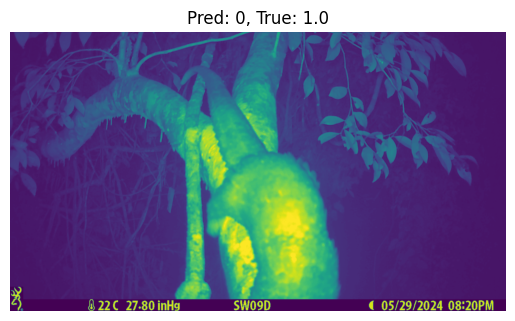

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_0016.JPG
Predicted Label: tensor([0], dtype=torch.int32), True Label: 1.0


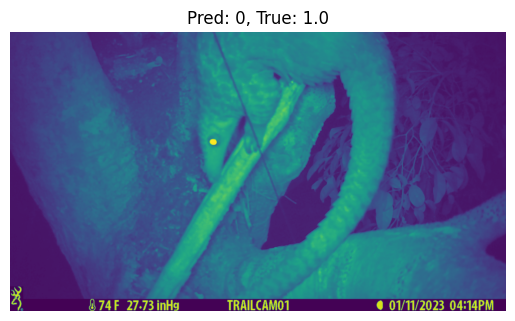

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1141.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


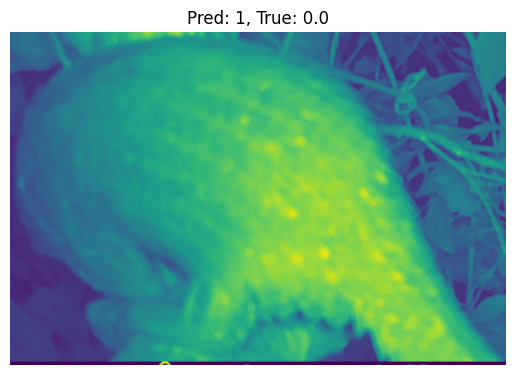

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1170.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


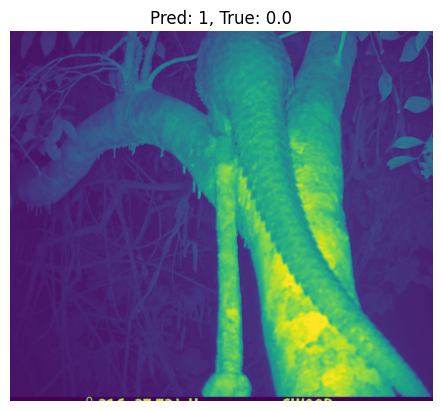

In [7]:
import matplotlib.pyplot as plt
import torchvision.transforms as transforms
from PIL import Image



strat_kf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)  # Shuffle data with random_seed = 42 for reproducibility

for fold, (train_index, test_index) in enumerate(strat_kf.split(combined_df, y_train)):
    print(f"Processing Confusion Matrix for Fold {fold + 1}")

    # Retrieve the SAME test set as before
    test_data = x_train.iloc[test_index]  # File paths for testing set
    test_labels = y_train[test_index]  # Labels for testing set

    # Filter out .DS_Store files (same as before)
    test_data = test_data[~test_data['filepath'].str.endswith('.DS_Store')]

    # Create dataset and dataloader (must match original format)
    test_dataset = ImagesDataset(test_data, test_labels)
    test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False)

    # Load the trained model for this fold
    model = models.densenet121(pretrained=False)  
    model.classifier = nn.Sequential(  # Replace the classifier layer
        nn.Linear(1024, 100),  # Dense layer takes a 1024-dim input and outputs 100-dim
        nn.ReLU(inplace=True),  # ReLU activation
        nn.Dropout(0.1),  # Dropout for regularization
        nn.Linear(100, 1),  # Final layer for 1 class
        nn.Sigmoid()
    )
    model.load_state_dict(torch.load(f"best_model_fold_{fold+1}.pth"))
    model.eval()  

    # Get predictions on the test set
    test_preds, test_labels = [], []
    misclassified_images = []  # To store misclassified images and their predictions
    with torch.no_grad():
        for batch in test_loader:
            images, labels = batch['image'], batch['label']
            labels = labels.unsqueeze(1).float()
            outputs = model(images)
            
            # For binary classification, get the probabilities for class 1
            #probs = torch.sigmoid(outputs).squeeze()  # Squeeze to remove extra dimensions
            preds = (outputs > 0.5).int()
            test_preds.extend(preds.cpu().numpy())  # Predicted label: 1 if prob > 0.5, else 0
            test_labels.extend(labels.cpu().numpy())  # Get true labels

            # Check for misclassified samples
            for i in range(len(preds)):
                if preds[i] != labels[i].item():  # If prediction is incorrect
                    misclassified_images.append((test_data.iloc[i]['filepath'], preds[i], labels[i].item(), images[i]))

            #test_outputs.extend(probs.cpu().detach().numpy())  # Get probabilities for the positive class
            #test_probs.extend(outputs.cpu().detach().numpy())  # Store probabilities for AUC calculation


    #test_outputs = np.array(test_probs)
    #test_labels = np.array(test_labels)
    test_labels = np.array(test_labels)
    test_preds = np.array(test_preds)
    #test_probs = np.array(test_probs)
    

    
    # Compute and display the normalized confusion matrix
    disp = ConfusionMatrixDisplay.from_predictions(test_labels, test_preds, normalize='true', cmap='Blues')
    disp.ax_.set_title(f"Normalized Confusion Matrix - Fold {fold+1}")
    plt.show()

    # Now print out the misclassified images
    for file_path, pred, true_label, image in misclassified_images:
        print(f"Misclassified Image: {file_path}")
        print(f"Predicted Label: {pred}, True Label: {true_label}")

        # Load and display the image
        img = Image.open(file_path)
        plt.imshow(img)
        plt.title(f"Pred: {pred.item()}, True: {true_label}")
        plt.axis('off')  # Turn off axis labels
        plt.show()



        



In [10]:
from sklearn.model_selection import StratifiedKFold, train_test_split
import numpy as np
from collections import Counter

# Assume strat_kf, combined_df, x_train, and y_train are already defined
strat_kf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

for fold, (train_index, test_index) in enumerate(strat_kf.split(combined_df, y_train)):  # Stratified split
    print(f"Fold {fold+1}/{5}")

    # Split data
    train_data = x_train.iloc[train_index]  # File paths for training set
    test_data = x_train.iloc[test_index]  # File paths for testing set
    train_labels = y_train[train_index]  # Labels for training set
    test_labels = y_train[test_index]  # Labels for testing set

    #print(f"Test indices (Fold {fold+1}): {test_index.tolist()}")

    # Further split the training data into training and validation (90/10 split)
    train_data, val_data, train_labels, val_labels, train_idx, val_idx = train_test_split(
        train_data, train_labels,  # Original training data and labels
        train_index,  # Pass train_index to track indices
        test_size=0.1,  # 10% of train_data becomes val_data
        stratify=train_labels,  # Ensures class proportions are preserved
        random_state=42  # For reproducibility
    )

    #print(f"Train indices (Fold {fold+1}): {train_idx.tolist()}")
    #print(f"Validation indices (Fold {fold+1}): {val_idx.tolist()}")
    
    print(f"Train size: {len(train_idx)}, Validation size: {len(val_idx)}, Test size: {len(test_index)}")

    # Print label distributions
    print(f"Train label counts (Fold {fold+1}): {dict(Counter(train_labels))}")
    print(f"Validation label counts (Fold {fold+1}): {dict(Counter(val_labels))}")
    print(f"Test label counts (Fold {fold+1}): {dict(Counter(test_labels))}")
    print("\n")


    

Fold 1/5
Train size: 469, Validation size: 53, Test size: 131
Train label counts (Fold 1): {np.int64(0): 322, np.int64(1): 147}
Validation label counts (Fold 1): {np.int64(0): 36, np.int64(1): 17}
Test label counts (Fold 1): {np.int64(1): 42, np.int64(0): 89}


Fold 2/5
Train size: 469, Validation size: 53, Test size: 131
Train label counts (Fold 2): {np.int64(0): 321, np.int64(1): 148}
Validation label counts (Fold 2): {np.int64(0): 36, np.int64(1): 17}
Test label counts (Fold 2): {np.int64(1): 41, np.int64(0): 90}


Fold 3/5
Train size: 469, Validation size: 53, Test size: 131
Train label counts (Fold 3): {np.int64(0): 321, np.int64(1): 148}
Validation label counts (Fold 3): {np.int64(0): 36, np.int64(1): 17}
Test label counts (Fold 3): {np.int64(1): 41, np.int64(0): 90}


Fold 4/5
Train size: 470, Validation size: 53, Test size: 130
Train label counts (Fold 4): {np.int64(0): 322, np.int64(1): 148}
Validation label counts (Fold 4): {np.int64(0): 36, np.int64(1): 17}
Test label counts

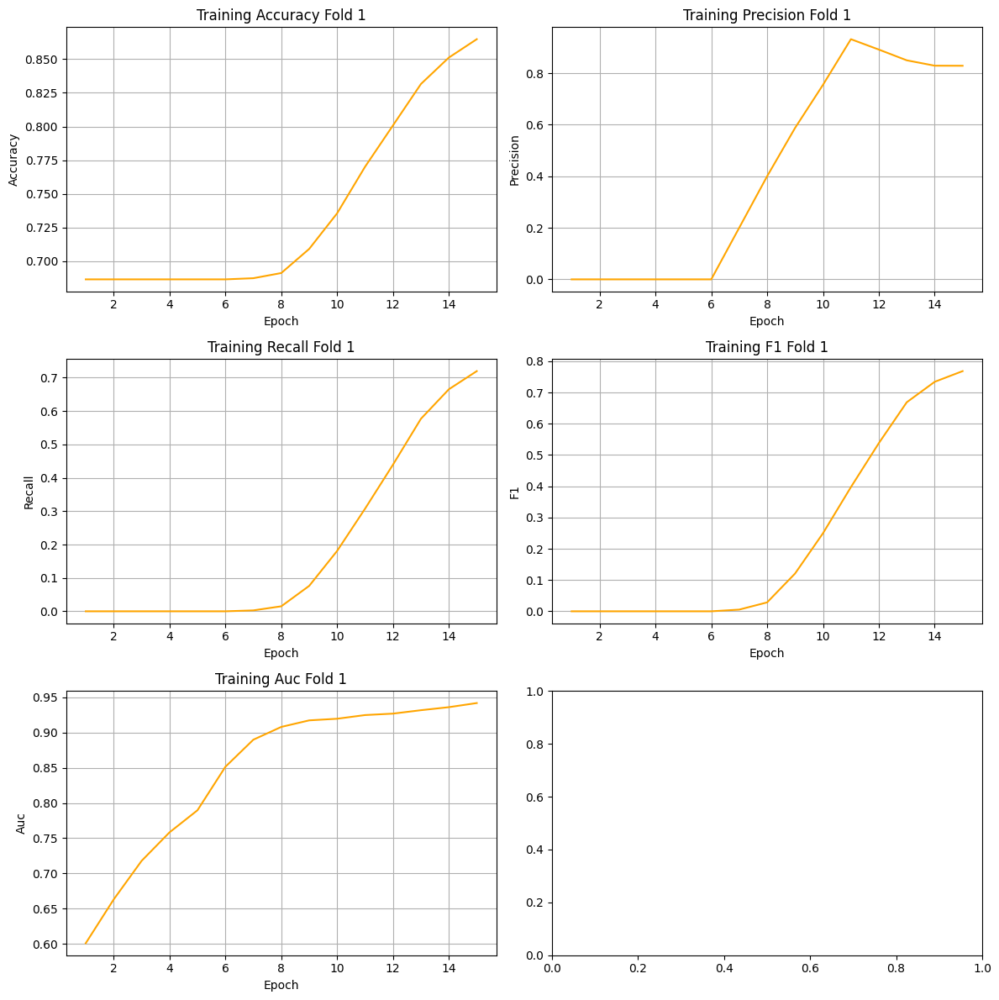

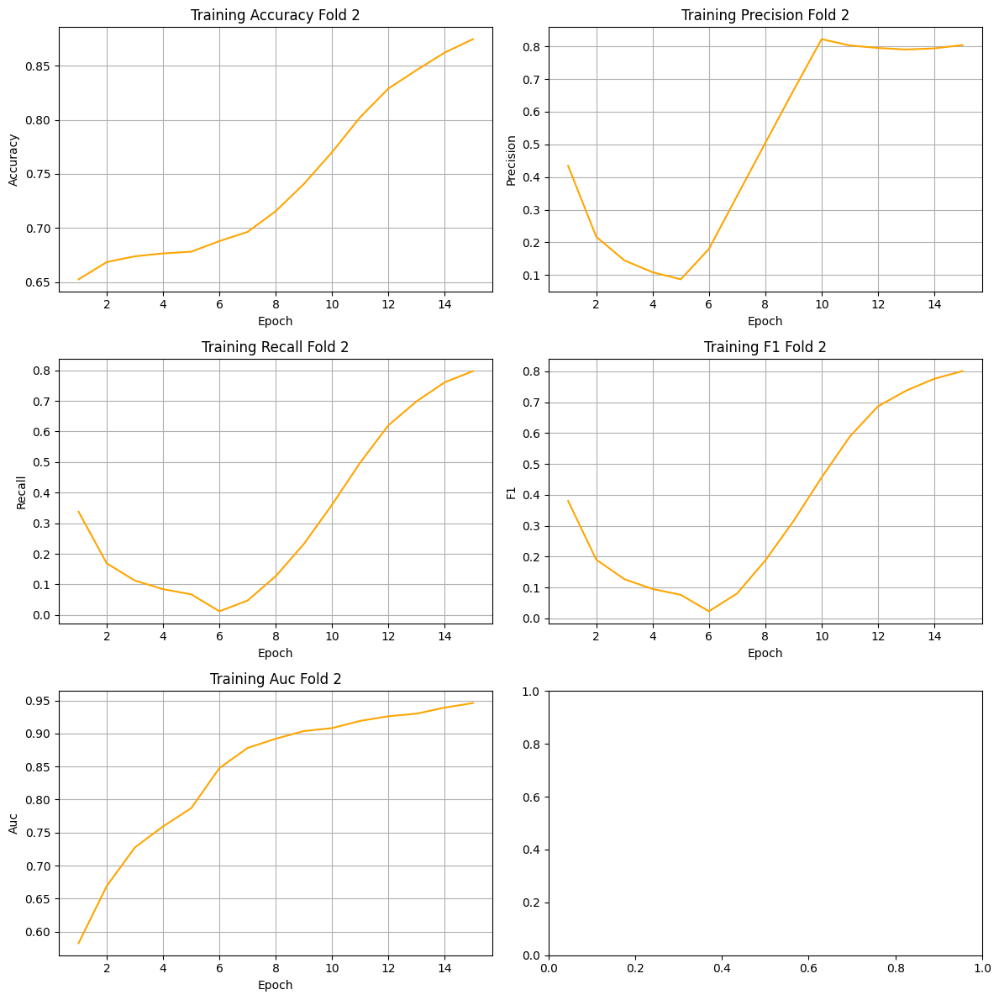

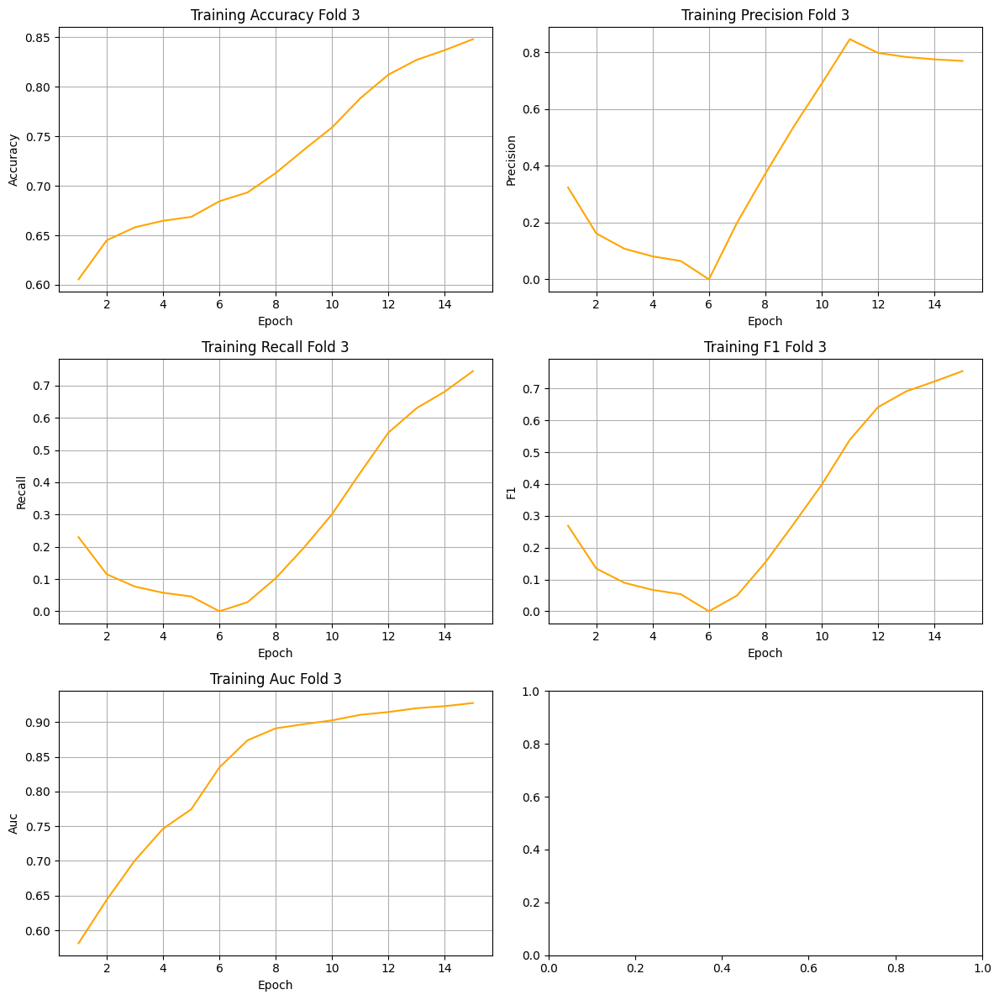

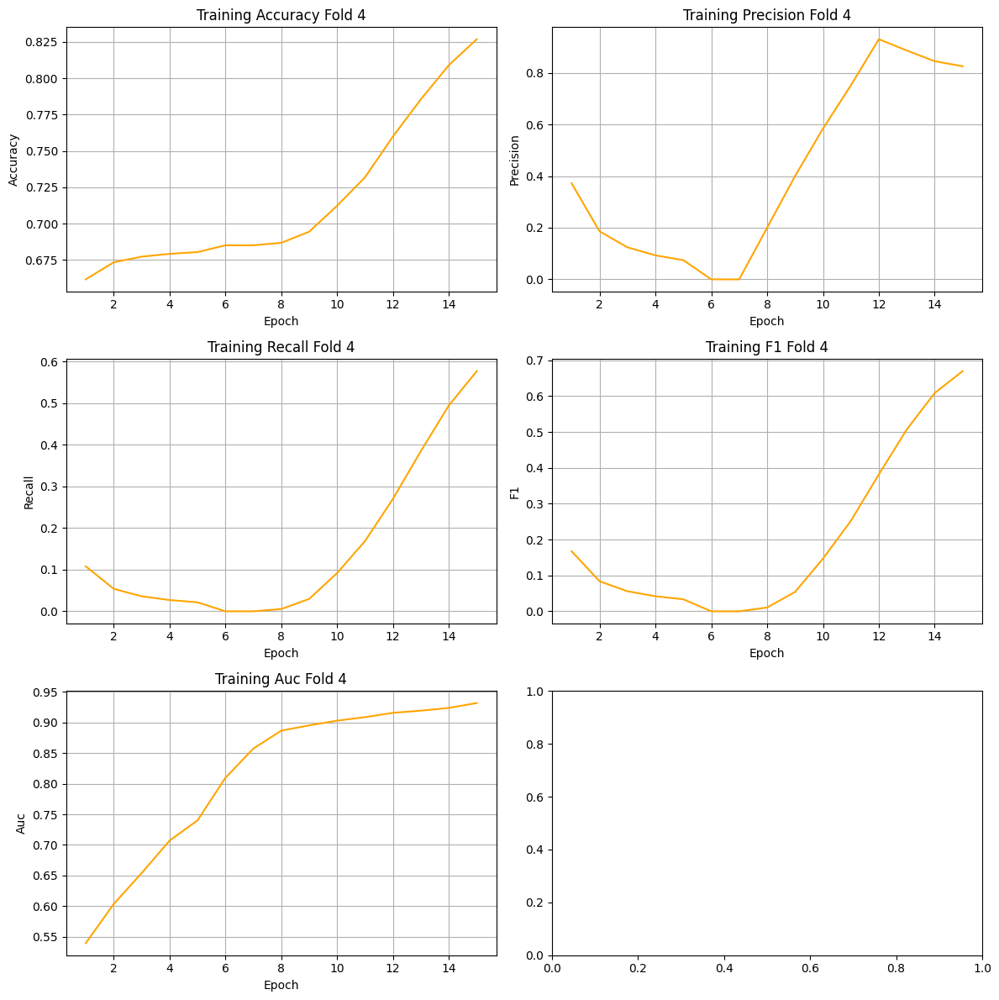

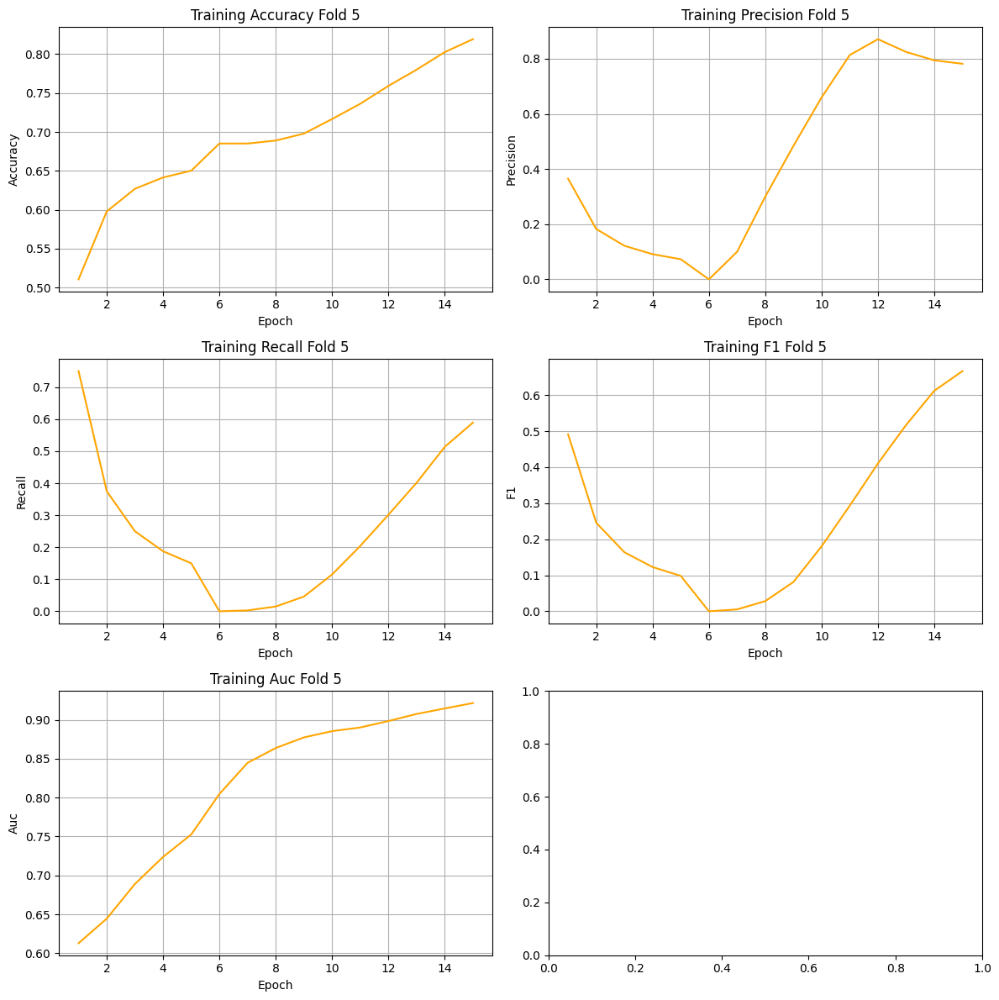

In [6]:
import matplotlib.pyplot as plt
import pandas as pd

# Function to create a DataFrame for Species 1 only
def create_dataframe_species_1(fold_data):
    species_1_values = [data[1] for data in fold_data]  # Extract only Species 1 values
    df = pd.DataFrame({
        "Species 1": species_1_values
    })
    df['Epoch'] = df.index + 1  # Add 'Epoch' column (starting from 1)
    return df

# Function to plot metrics for Species 1
def plot_metrics_for_species_1(fold_number, per_epoch_accuracy, per_epoch_precision, per_epoch_f1, per_epoch_recall, per_epoch_auc):
    metrics = ['accuracy', 'precision', 'recall', 'f1', 'auc']
    
    # Create subplots for each metric (single species)
    fig, axs = plt.subplots(3, 2, figsize=(12, 12))

    # For each metric, plot the values with moving averages
    for i, metric in enumerate(metrics):
        row = i // 2
        col = i % 2

        # Select the appropriate data for the current fold and metric
        if metric == 'accuracy':
            data = per_epoch_accuracy
        elif metric == 'precision':
            data = per_epoch_precision
        elif metric == 'f1':
            data = per_epoch_f1
        elif metric == 'recall':
            data = per_epoch_recall
        elif metric == 'auc':
            data = per_epoch_auc
        
        # Create a DataFrame for the metric data (Species 1 only)
        df = create_dataframe_species_1(data)
        
        # Calculate the moving average for Species 1
        df['Species 1 MA'] = df['Species 1'].rolling(window=5, min_periods=1).mean()

        # Plot the values for Species 1
        axs[row, col].plot(df['Epoch'], df['Species 1 MA'], label='Species 1', color='orange')
        axs[row, col].set_title(f'Training {metric.capitalize()} Fold {fold_number}')
        axs[row, col].set_xlabel('Epoch')
        axs[row, col].set_ylabel(f'{metric.capitalize()}')
        #axs[row, col].legend()
        axs[row, col].grid(True)

    # Adjust layout
    plt.tight_layout()
    plt.show()

# Plot metrics for each fold (Species 1 only)
for fold_number in range(1, 6):
    plot_metrics_for_species_1(fold_number, 
                               all_per_species_train_metrics['accuracy'][fold_number-1], 
                               all_per_species_train_metrics['precision'][fold_number-1], 
                               all_per_species_train_metrics['f1'][fold_number-1], 
                               all_per_species_train_metrics['recall'][fold_number-1], 
                               all_per_species_train_metrics['auc'][fold_number-1])
